<!-- Notebook Header Start -->

<h1 align="center">Changes to Noxious Stimuli by means of Dorsal Root Ganglion Stimulation</h1>

<p align="center">
  <strong>Author:</strong> Karl Bates<br>
  <strong>Date:</strong> 2024-12-06<br>
  <strong>Affiliation:</strong> Carnegie Mellon University, Cohen-Karni Lab  || Neuromechatronics Lab
</p>

---


## 📊 Notebook Outline

* **Importing libraries & data**
* **Preprocess neurophysiology recordings for spike sorting**
* **Package preprocessed data for spike sorting using Kilosort4**
* **Run Kilosort to extract spike activity**
* **Calculate average firing rate of each cluster during noxious stimuli**
* **Compare the firing rates of clusters before and after noxious stimuli**

## 📚 References & Additional Resources

- [Kilosort4 docs](https://github.com/MouseLand/Kilosort/tree/main)
- [SpikeInterface docs](https://github.com/SpikeInterface)

---

<!-- Notebook Header End -->


# ➡ Importing Libraries & Data
---

In [1]:
# standard imports
from pathlib import Path
import os
from kilosort import io
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import statsmodels.api as sm
import statsmodels.formula.api as smf
import math
import seaborn as sns
from patsy import dmatrix
from sklearn.preprocessing import StandardScaler

# custom imports
from automations import RM1
from automations import SpikeInterface_wrapper
from automations import Kilosort_wrapper
from automations import plots
from automations import analysis_functions


### probe definition

Using the spreadsheet, `Adapter_pinout.xlsx`, the contact ID's can be traced to the "device channel", and we can assign them on the probe. 

In this case, our channel indices correspond to the aux inputs to the intan headstage.

refer to the notebook, `RM1_pipeline.ipynb` within  the `dev_notebook` folder

I am running my latest analysis, but with Charlie's probe to make sure that I am doing this right

In [2]:
PROBE_DIRECTORY = Path(r'D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.001 A1x32-Edge-5mm-20-177-A32\A1x32-Edge-5mm-20-177-A32.prb')

### filepath definitions

In [3]:
# NOTE Specify the path where the data will be copied to, and where Kilosort4 results will be saved.
# in this case, the data is saved in a folder with multiple rats
DATA_DIRECTORY = Path(fr'D:\SynologyDrive\CMU.80 Data\82 External Data\82.002 Sample Rat Data from RM1 Project')  
# Create path if it doesn't exist
DATA_DIRECTORY.mkdir(parents=True, exist_ok=True)

# NOTE Specify the path where the data will be copied to, and where Kilosort4 results will be saved.
# save data to the inbox; make sure that the folders: binary & figures exist

# select your path

# the following save directory has already been run, and it stores data that has been unaltered
SAVE_DIRECTORY = Path(fr"D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe")

# Create paths if they don't exist
SAVE_DIRECTORY.mkdir(parents=True, exist_ok=True)

# run a multi-rat class

In [ ]:
# all trials
# rats = [RM1.Rat(DATA_DIRECTORY, PROBE_DIRECTORY, rat_id) for rat_id in ['DW322', 'DW323', 'DW327','DW361']]

# just the one I want for now. you need to pass it as a list, even if it's just one
rats = [RM1.Rat(DATA_DIRECTORY, PROBE_DIRECTORY, rat_id) for rat_id in ['DW361']]

group = RM1.RatGroup(rats)
group.run_preprocessing(remove_drg_stim=True)  # preprocess all rats at once

Reading DRGStest_1_250422_135617...
Error reading stream 2 for DRGStest_1_250422_135617: stream_id 2 is not in ['0', '1', '3', '4']
Reading DRGStest_2_250422_135658...
Error reading stream 2 for DRGStest_2_250422_135658: stream_id 2 is not in ['0', '1', '3', '4']
Reading DRGS_10_250422_150038...
Error reading stream 2 for DRGS_10_250422_150038: stream_id 2 is not in ['0', '1', '3', '4']
Reading DRGS_11_250422_150742...
Error reading stream 2 for DRGS_11_250422_150742: stream_id 2 is not in ['0', '1', '3', '4']
Reading DRGS_12_250422_151439...
Error reading stream 2 for DRGS_12_250422_151439: stream_id 2 is not in ['0', '1', '3', '4']
Reading DRGS_13_250422_152113...
Error reading stream 2 for DRGS_13_250422_152113: stream_id 2 is not in ['0', '1', '3', '4']
Reading DRGS_14_250422_152726...
Error reading stream 2 for DRGS_14_250422_152726: stream_id 2 is not in ['0', '1', '3', '4']
Reading DRGS_15_250422_153500...
Error reading stream 2 for DRGS_15_250422_153500: stream_id 2 is not in [

In [5]:
group.rats.keys()

dict_keys(['DW361'])

## run spikeinterface

20250411 update: I am using the bandpass filter (300 Hz - 3000 Hz) from Ting et al. 2024 and the notch filter (60Hz) from Wang et al. 2024

I am using 60 Hz instead of 50 Hz because Wang et al. 2024 was in China, and the supplied power is 50 Hz, and in the US it is 60 Hz

In [6]:
si_wrappers = group.create_spikeinterface_wrappers(SAVE_DIRECTORY)
for rat_id in si_wrappers.keys():
    si_wrappers[rat_id].save_spinalcord_data_to_binary(bandpass_freq_min=300, bandpass_freq_max=3000, notch_freq=60)
    pass

Preparing SpikeInterface wrapper for rat DW361
ERROR: issue importing data for DRGStest_1_250422_135617: 'NoneType' object has no attribute 'get_sampling_frequency'
ERROR: issue importing data for DRGStest_2_250422_135658: 'NoneType' object has no attribute 'get_sampling_frequency'
Data saved to D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\binary\DRGS_10_250422_150038\DW361_DRGS_10_250422_150038_data.bin
Data saved to D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\binary\DRGS_11_250422_150742\DW361_DRGS_11_250422_150742_data.bin
Data saved to D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\binary\DRGS_12_250422_151439\DW361_DRGS_12_250422_151439_data.bin
Data saved to D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\binary\DRGS_13_250422_152113\DW361_DRGS_13_250422_152113_da

## run kilosort

In [7]:
ks_wrappers = group.create_kilosort_wrappers(SAVE_DIRECTORY, probe_directory=PROBE_DIRECTORY)
def my_custom_criteria(cluster_labels, st, clu, est_contam_rate, fs):   
    # Example criteria: Contamination rate < 15% and firing rate between 0.1 and 1000 Hz
    contam_good = est_contam_rate < 0.15
    fr_good = np.zeros(cluster_labels.size, dtype=bool)
    for i, c in enumerate(cluster_labels):
        spikes = st[clu == c]
        fr = spikes.size / ((spikes.max() - spikes.min()) / fs)
        if 0.1 <= fr <= 1000:
            fr_good[i] = True
    return np.logical_and(contam_good, fr_good)

Preparing Kilosort wrapper for DW361


In [8]:
for rat_id in ks_wrappers.keys():
    ks_wrappers[rat_id].run_kilosort_trial_summary(new_settings="vf_settings_flex_probe",custom_criteria=my_custom_criteria)
    ks_wrappers[rat_id].extract_kilosort_outputs()

kilosort.run_kilosort: Kilosort version 4.0.30
kilosort.run_kilosort: Python version 3.9.21
kilosort.run_kilosort: ----------------------------------------
kilosort.run_kilosort: System information:
kilosort.run_kilosort: Windows-10-10.0.26100-SP0 AMD64
kilosort.run_kilosort: AMD64 Family 25 Model 97 Stepping 2, AuthenticAMD
kilosort.run_kilosort: Using GPU for PyTorch computations. Specify `device` to change this.
kilosort.run_kilosort: Using CUDA device: NVIDIA GeForce RTX 4070 Ti SUPER 15.99GB
kilosort.run_kilosort: ----------------------------------------
kilosort.run_kilosort: Sorting D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\binary\DRGS_10_250422_150038\DW361_DRGS_10_250422_150038_data.bin
kilosort.run_kilosort: Interpreting binary file as default dtype='int16'. If data was saved in a different format, specify `data_dtype`.
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing preprocessing variables.
kilosort.run_kil


Running kilosort on DRGS_10_250422_150038



kilosort.run_kilosort: N samples: 2165625
kilosort.run_kilosort: N seconds: 72.1875
kilosort.run_kilosort: N batches: 2
kilosort.run_kilosort: Preprocessing filters computed in  0.82s; total  0.82s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    12.80 %
kilosort.run_kilosort: Memory:       31.10 %     |     39.53   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   30.19 %     |      4.83   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    15.85 %     |      2.54   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Comput

Custom labels applied and saved for trial: DRGS_10_250422_150038

Running kilosort on DRGS_11_250422_150742



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    26.30 %
kilosort.run_kilosort: Memory:       31.63 %     |     40.21   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.27 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_11_250422_150742

Running kilosort on DRGS_12_250422_151439



kilosort.spikedetect: Number of universal templates: 63
kilosort.spikedetect: Detecting spikes...
100%|██████████| 2/2 [00:00<00:00,  2.54it/s]
kilosort.run_kilosort: drift computed in  1.16s; total  1.30s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after drift correction
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    25.90 %
kilosort.run_kilosort: Memory:       31.45 %     |     39.97   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.27 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilos

Custom labels applied and saved for trial: DRGS_12_250422_151439

Running kilosort on DRGS_13_250422_152113



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    34.40 %
kilosort.run_kilosort: Memory:       31.34 %     |     39.84   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.27 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_13_250422_152113

Running kilosort on DRGS_14_250422_152726



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    30.00 %
kilosort.run_kilosort: Memory:       31.29 %     |     39.77   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.27 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_14_250422_152726

Running kilosort on DRGS_15_250422_153500



kilosort.run_kilosort: Preprocessing filters computed in  0.21s; total  0.21s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    27.70 %
kilosort.run_kilosort: Memory:       31.31 %     |     39.79   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing

Custom labels applied and saved for trial: DRGS_15_250422_153500

Running kilosort on DRGS_1_250422_140443



kilosort.spikedetect: Number of universal templates: 63
kilosort.spikedetect: Detecting spikes...
100%|██████████| 2/2 [00:00<00:00,  2.48it/s]
kilosort.run_kilosort: drift computed in  1.17s; total  1.31s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after drift correction
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    19.50 %
kilosort.run_kilosort: Memory:       31.14 %     |     39.58   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilos

Custom labels applied and saved for trial: DRGS_1_250422_140443

Running kilosort on DRGS_2_250422_141030



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    26.30 %
kilosort.run_kilosort: Memory:       31.32 %     |     39.81   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_2_250422_141030

Running kilosort on DRGS_3_250422_141626



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    34.00 %
kilosort.run_kilosort: Memory:       31.31 %     |     39.79   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_3_250422_141626

Running kilosort on DRGS_4_250422_142236



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    30.50 %
kilosort.run_kilosort: Memory:       31.30 %     |     39.79   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_4_250422_142236

Running kilosort on DRGS_5_250422_142831



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    29.90 %
kilosort.run_kilosort: Memory:       31.27 %     |     39.74   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_5_250422_142831

Running kilosort on DRGS_6_250422_143403



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    32.00 %
kilosort.run_kilosort: Memory:       31.28 %     |     39.76   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_6_250422_143403

Running kilosort on DRGS_7_250422_144109



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    24.60 %
kilosort.run_kilosort: Memory:       31.27 %     |     39.74   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_7_250422_144109

Running kilosort on DRGS_8_250422_144724



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    28.70 %
kilosort.run_kilosort: Memory:       31.25 %     |     39.72   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_8_250422_144724

Running kilosort on DRGS_9_250422_145350



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    21.00 %
kilosort.run_kilosort: Memory:       31.28 %     |     39.75   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.27 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: DRGS_9_250422_145350

Running kilosort on VF_10_250422_133218



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    31.70 %
kilosort.run_kilosort: Memory:       31.26 %     |     39.73   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: VF_10_250422_133218

Running kilosort on VF_11_250422_133722



kilosort.run_kilosort: Preprocessing filters computed in  0.35s; total  0.35s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    24.70 %
kilosort.run_kilosort: Memory:       31.24 %     |     39.71   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing

Custom labels applied and saved for trial: VF_11_250422_133722

Running kilosort on VF_12_250422_134214



kilosort.run_kilosort: Preprocessing filters computed in  0.27s; total  0.27s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    32.10 %
kilosort.run_kilosort: Memory:       31.21 %     |     39.67   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing

Custom labels applied and saved for trial: VF_12_250422_134214

Running kilosort on VF_13_250422_134725



kilosort.run_kilosort: Preprocessing filters computed in  0.36s; total  0.37s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    26.70 %
kilosort.run_kilosort: Memory:       31.24 %     |     39.71   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing

Custom labels applied and saved for trial: VF_13_250422_134725

Running kilosort on VF_14_250422_154410



kilosort.run_kilosort: Preprocessing filters computed in  0.31s; total  0.31s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    28.30 %
kilosort.run_kilosort: Memory:       31.22 %     |     39.68   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing

Custom labels applied and saved for trial: VF_14_250422_154410

Running kilosort on VF_15_250422_154935



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    29.30 %
kilosort.run_kilosort: Memory:       31.22 %     |     39.68   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: VF_15_250422_154935

Running kilosort on VF_16_250422_155509



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    44.90 %
kilosort.run_kilosort: Memory:       31.21 %     |     39.66   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: VF_16_250422_155509

Running kilosort on VF_1_250422_124925



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    37.90 %
kilosort.run_kilosort: Memory:       31.19 %     |     39.65   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: VF_1_250422_124925

Running kilosort on VF_2_250422_125146



kilosort.run_kilosort: Preprocessing filters computed in  0.19s; total  0.19s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    37.90 %
kilosort.run_kilosort: Memory:       31.20 %     |     39.66   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing

Custom labels applied and saved for trial: VF_2_250422_125146

Running kilosort on VF_3_250422_125632



kilosort.run_kilosort: Preprocessing filters computed in  0.32s; total  0.32s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    26.00 %
kilosort.run_kilosort: Memory:       31.22 %     |     39.68   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing

Custom labels applied and saved for trial: VF_3_250422_125632

Running kilosort on VF_4_250422_130213



kilosort.spikedetect: Number of universal templates: 63
kilosort.spikedetect: Detecting spikes...
100%|██████████| 2/2 [00:00<00:00,  2.50it/s]
kilosort.run_kilosort: drift computed in  1.23s; total  1.37s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after drift correction
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    25.50 %
kilosort.run_kilosort: Memory:       31.11 %     |     39.54   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilos

Custom labels applied and saved for trial: VF_4_250422_130213

Running kilosort on VF_5_250422_130729



kilosort.run_kilosort: Preprocessing filters computed in  0.34s; total  0.34s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    37.70 %
kilosort.run_kilosort: Memory:       31.25 %     |     39.72   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing

Custom labels applied and saved for trial: VF_5_250422_130729

Running kilosort on VF_6_250422_131240



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    32.70 %
kilosort.run_kilosort: Memory:       31.25 %     |     39.72   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: VF_6_250422_131240

Running kilosort on VF_7_250422_131739



kilosort.run_kilosort: Preprocessing filters computed in  0.31s; total  0.31s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    27.00 %
kilosort.run_kilosort: Memory:       31.19 %     |     39.65   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing

Custom labels applied and saved for trial: VF_7_250422_131739

Running kilosort on VF_8_250422_132231



kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    33.00 %
kilosort.run_kilosort: Memory:       31.17 %     |     39.62   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.run_kilosort: ----------------------------------------
kilosort.spikedetect: Re-computing universal templates from data.
kilosort.spikedetect: Number of universal temp

Custom labels applied and saved for trial: VF_8_250422_132231

Running kilosort on VF_9_250422_132717



kilosort.spikedetect: Number of universal templates: 63
kilosort.spikedetect: Detecting spikes...
100%|██████████| 2/2 [00:00<00:00,  2.55it/s]
kilosort.run_kilosort: drift computed in  1.21s; total  1.37s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after drift correction
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    17.80 %
kilosort.run_kilosort: Memory:       31.21 %     |     39.67   /   127.10 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    `conda install pynvml` for GPU usage
kilosort.run_kilosort: GPU memory:   53.28 %     |      8.52   /    15.99 GB
kilosort.run_kilosort: Allocated:     0.05 %     |      0.01   /    15.99 GB
kilosort.run_kilosort: Max alloc:    25.28 %     |      4.04   /    15.99 GB
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilos

Custom labels applied and saved for trial: VF_9_250422_132717
Kilosort outputs successfully loaded for trial: DRGS_10_250422_150038
Kilosort outputs successfully loaded for trial: DRGS_11_250422_150742
Kilosort outputs successfully loaded for trial: DRGS_12_250422_151439
Kilosort outputs successfully loaded for trial: DRGS_13_250422_152113
Kilosort outputs successfully loaded for trial: DRGS_14_250422_152726
Kilosort outputs successfully loaded for trial: DRGS_15_250422_153500
Kilosort outputs successfully loaded for trial: DRGS_1_250422_140443
Kilosort outputs successfully loaded for trial: DRGS_2_250422_141030
Kilosort outputs successfully loaded for trial: DRGS_3_250422_141626
Kilosort outputs successfully loaded for trial: DRGS_4_250422_142236
Kilosort outputs successfully loaded for trial: DRGS_5_250422_142831
Kilosort outputs successfully loaded for trial: DRGS_6_250422_143403
Kilosort outputs successfully loaded for trial: DRGS_7_250422_144109
Kilosort outputs successfully loade

### generate sanity plots for each trial 

In [9]:
dw322_trials = ["VF_1_240918_143256","VF_2_240918_143936","VF_3_240918_144658","VF_4_240918_145638","VF_5_240918_150137","VF_6_240918_150811",
                "VF_7_240918_151516","VF_8_240918_152056","VF_9_240918_152753"]

dw323_trials = ["VF_1_240911_164342","VF_2_240911_165039","VF_3_240911_165617","VF_4_240911_170446","VF_5_240911_171014","VF_6_240911_171505"]

dw327_trials = ["VF_01_241125_153746","VF_02_241125_154307","VF_03_241125_154841","VF_04_241125_155417","VF_05_241125_155941","VF_06_241125_160515",
                "VF_07_241125_161126","VF_08_241125_161626","VF_09_241125_162141","VF_10_241125_162725"]

dw361_trials = ["VF_1_250422_124925","VF_2_250422_125146","VF_3_250422_125632","VF_4_250422_130213","VF_5_250422_130729","VF_6_250422_131240",
                "VF_7_250422_131739","VF_8_250422_132231","VF_9_250422_132717","VF_10_250422_133218","VF_11_250422_133722","VF_12_250422_134214",
                "VF_13_250422_134725","VF_14_250422_154410","VF_14_250422_154410","VF_15_250422_154935","VF_16_250422_155509"]

##### NOTE:

seeing repeating units is not a sign that there is an issue: these plots a pick random units, (40) times, to show how spikes are captured on the probe. 

the fewer the number of good or mua units, the more likely there will be repeated units.

#### DW322

In [10]:
# ks_wrappers["DW322"].plot_trial_results(dw322_trials)

#### DW323

In [11]:
# ks_wrappers["DW323"].plot_trial_results(dw323_trials)

#### DW327

In [12]:
# ks_wrappers["DW327"].plot_trial_results(dw327_trials)

#### DW361

Saved plot for trial VF_1_250422_124925, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_summmary_plots.png


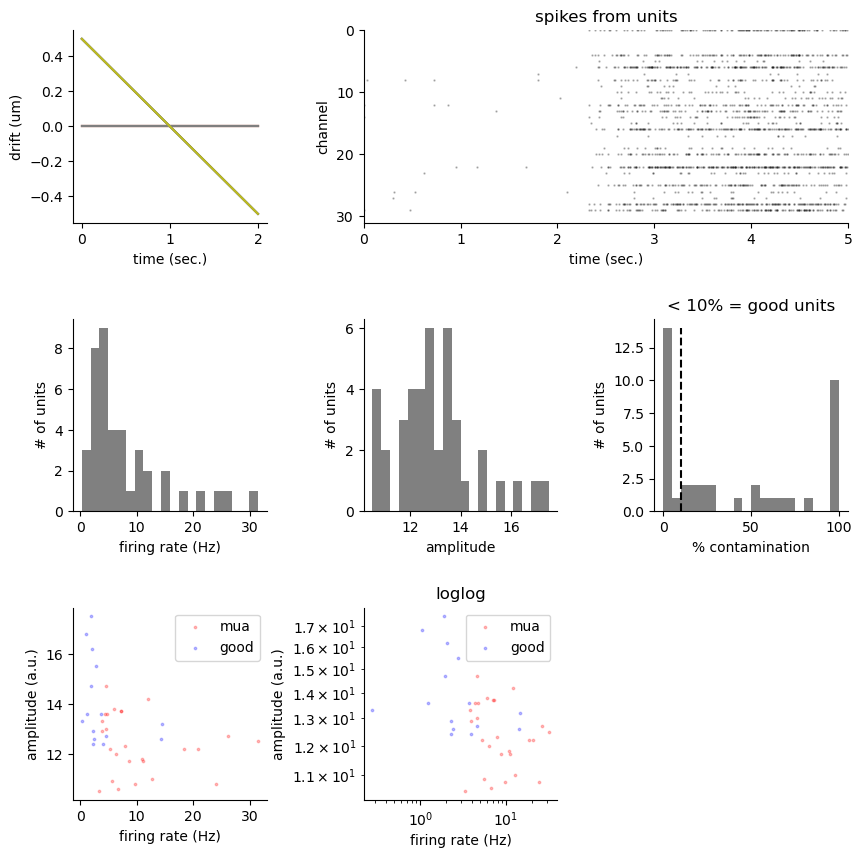

Plotting good units for trial: VF_1_250422_124925
Saved plot for trial VF_1_250422_124925, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_good_waveforms_on_probe.png


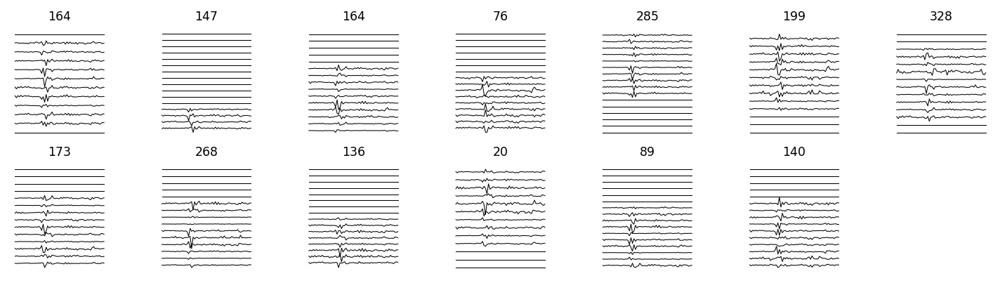

Plotting mua units for trial: VF_1_250422_124925
Saved plot for trial VF_1_250422_124925, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_mua_waveforms_on_probe.png


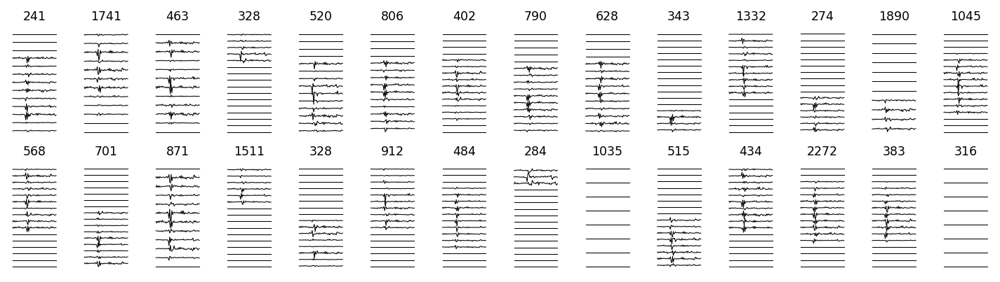

Saved plot for trial VF_2_250422_125146, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_summmary_plots.png


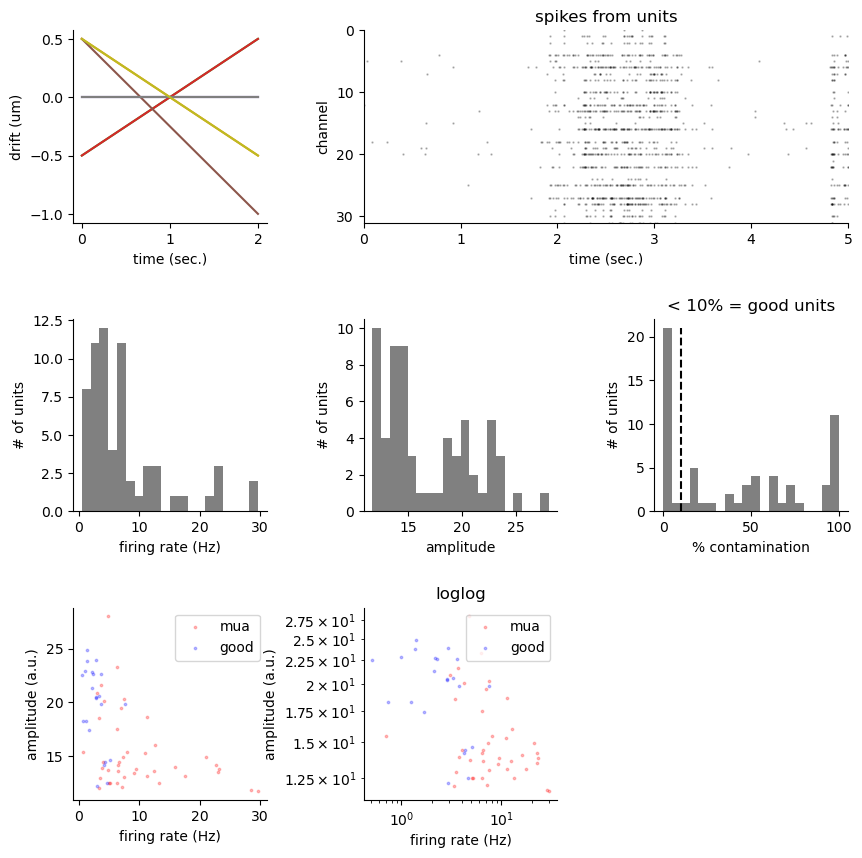

Plotting good units for trial: VF_2_250422_125146
Saved plot for trial VF_2_250422_125146, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_good_waveforms_on_probe.png


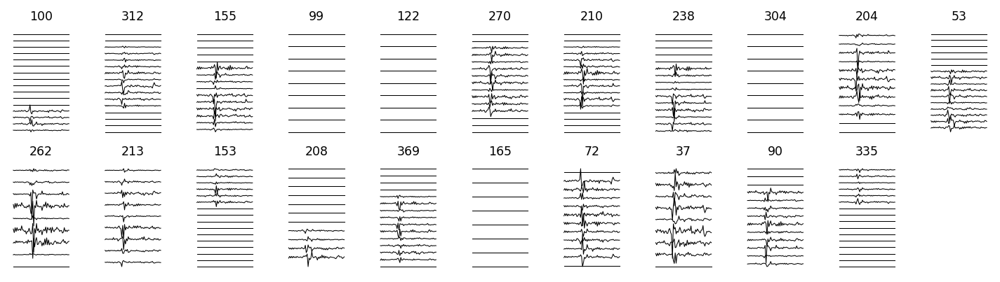

Plotting mua units for trial: VF_2_250422_125146
Saved plot for trial VF_2_250422_125146, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_mua_waveforms_on_probe.png


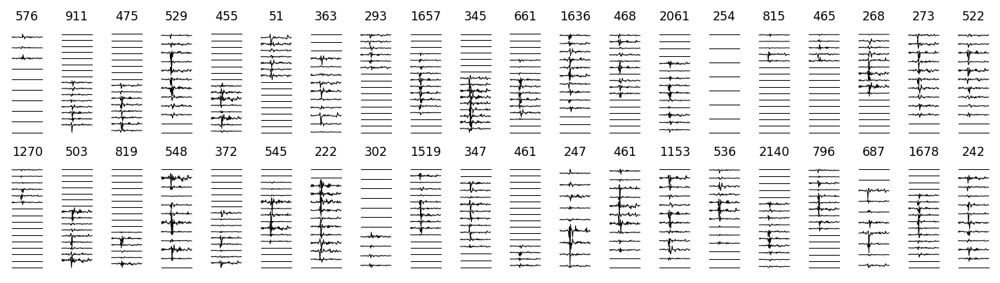

Saved plot for trial VF_3_250422_125632, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_summmary_plots.png


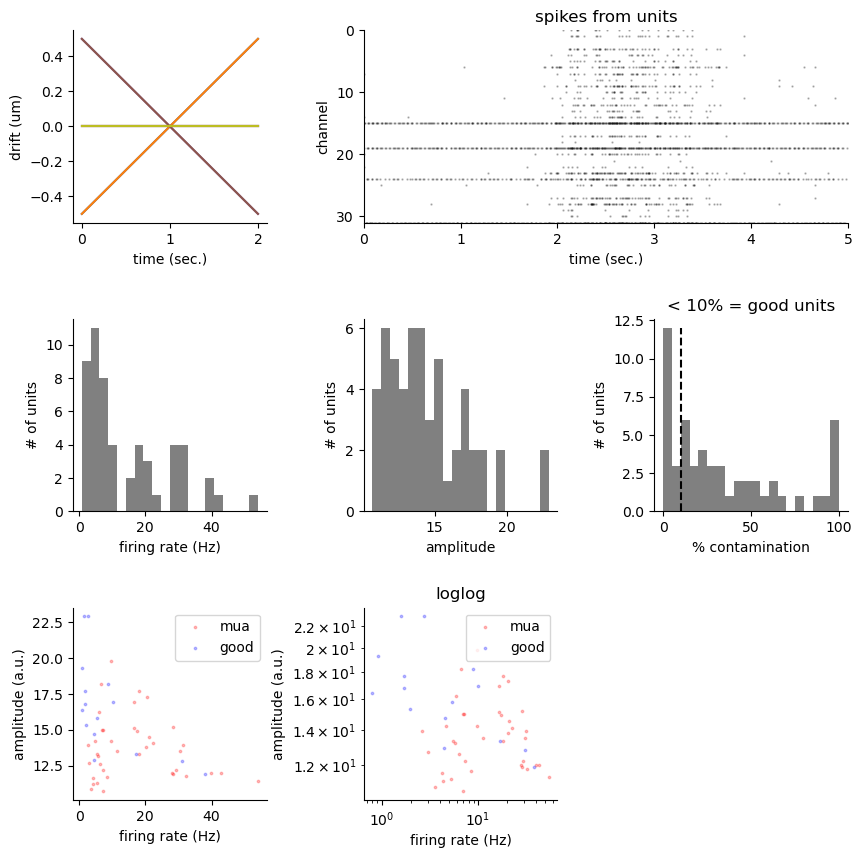

Plotting good units for trial: VF_3_250422_125632
Saved plot for trial VF_3_250422_125632, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_good_waveforms_on_probe.png


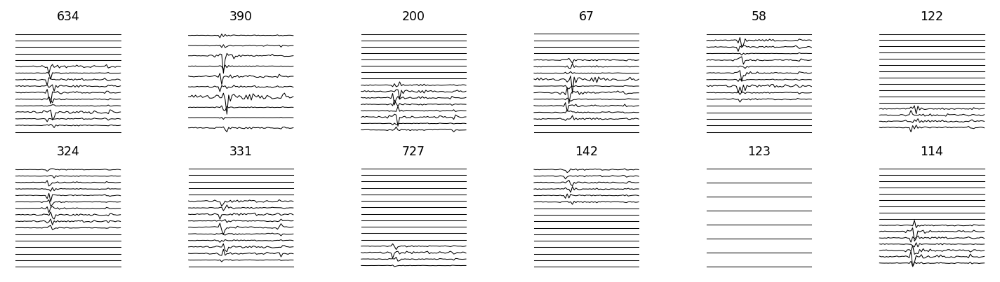

Plotting mua units for trial: VF_3_250422_125632
Saved plot for trial VF_3_250422_125632, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_mua_waveforms_on_probe.png


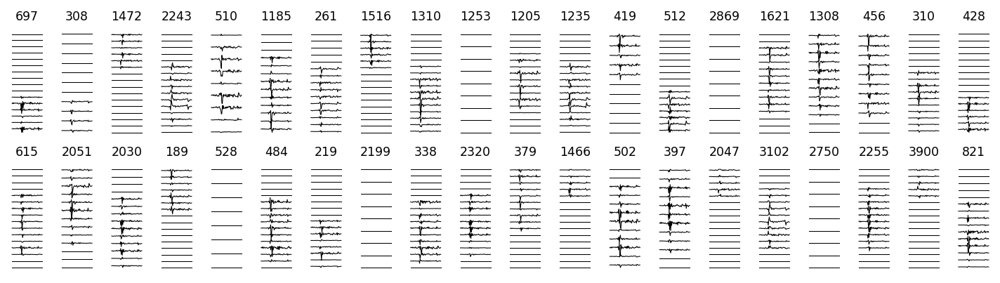

Saved plot for trial VF_4_250422_130213, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_summmary_plots.png


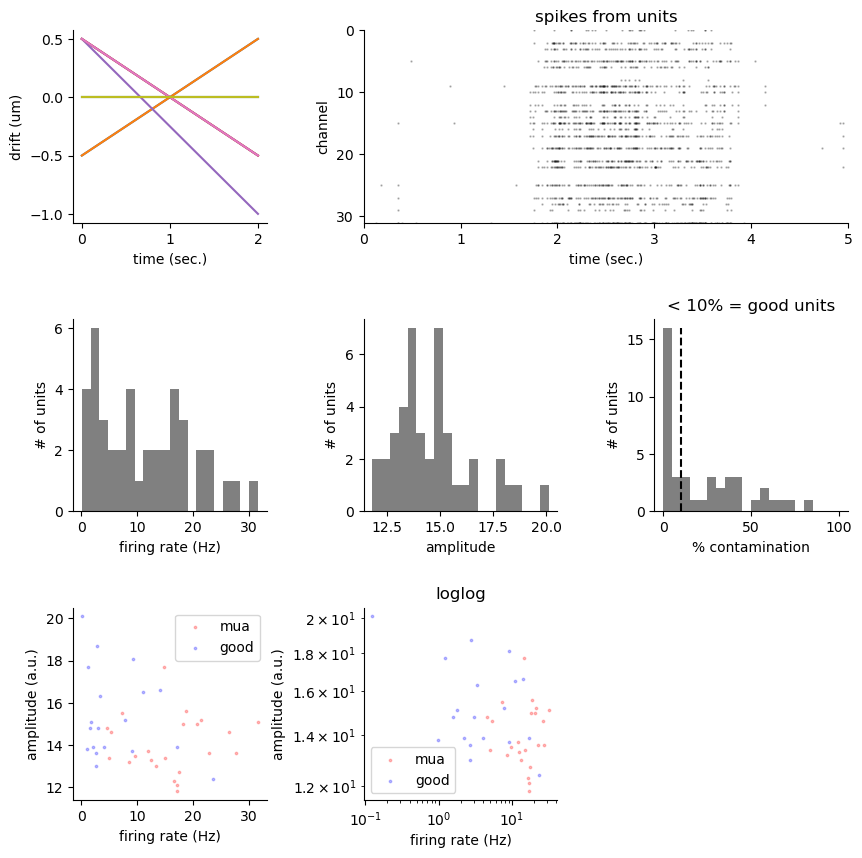

Plotting good units for trial: VF_4_250422_130213
Saved plot for trial VF_4_250422_130213, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_good_waveforms_on_probe.png


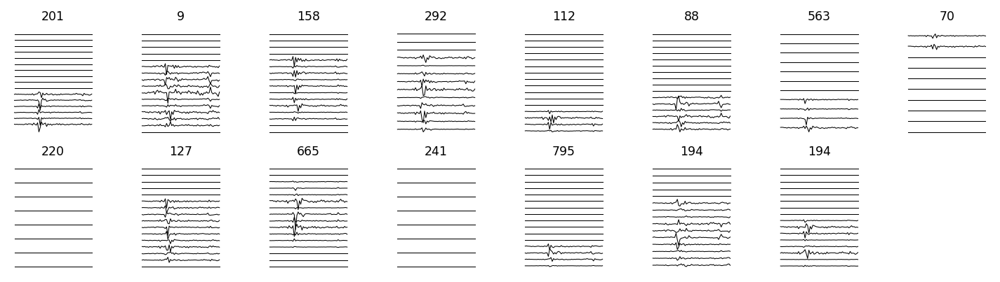

Plotting mua units for trial: VF_4_250422_130213
Saved plot for trial VF_4_250422_130213, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_mua_waveforms_on_probe.png


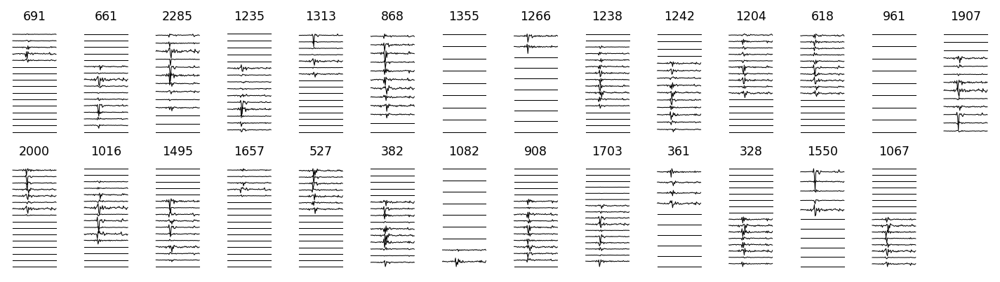

Saved plot for trial VF_5_250422_130729, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_summmary_plots.png


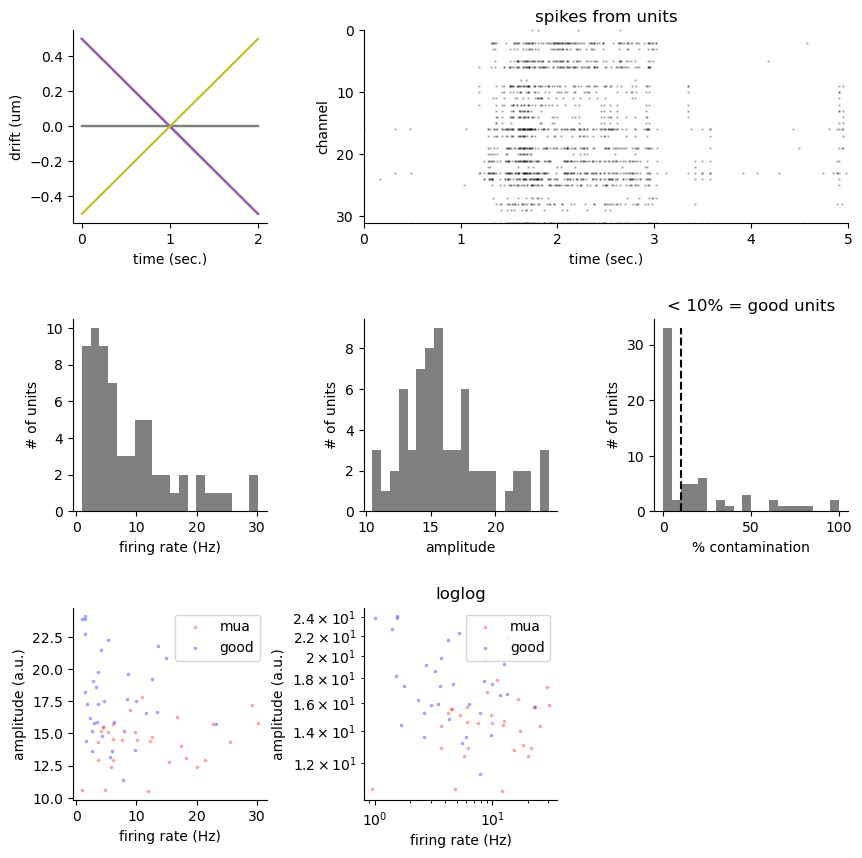

Plotting good units for trial: VF_5_250422_130729
Saved plot for trial VF_5_250422_130729, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_good_waveforms_on_probe.png


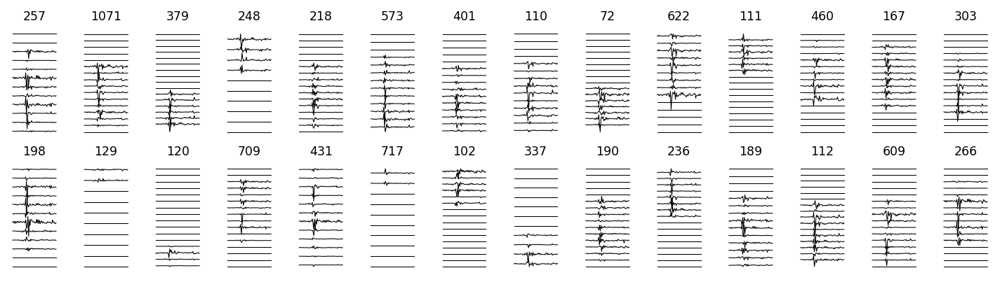

Plotting mua units for trial: VF_5_250422_130729
Saved plot for trial VF_5_250422_130729, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_mua_waveforms_on_probe.png


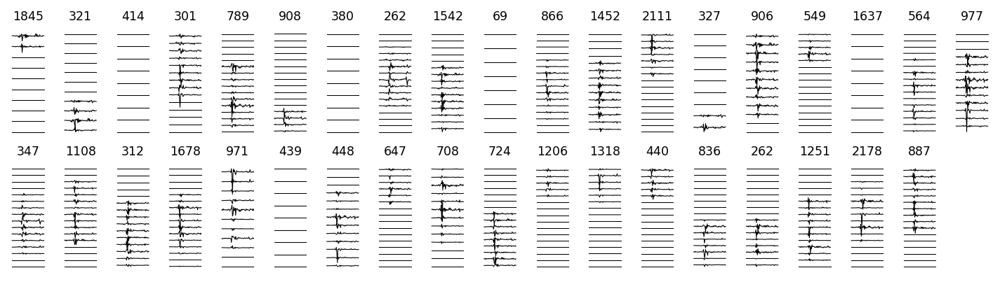

Saved plot for trial VF_6_250422_131240, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_summmary_plots.png


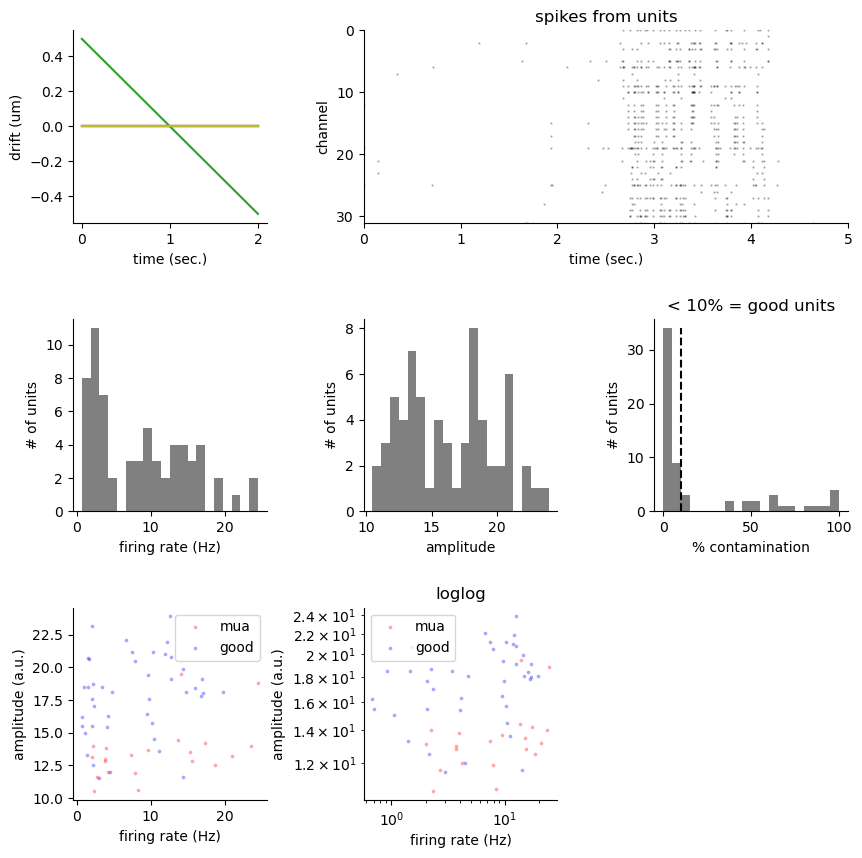

Plotting good units for trial: VF_6_250422_131240
Saved plot for trial VF_6_250422_131240, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_good_waveforms_on_probe.png


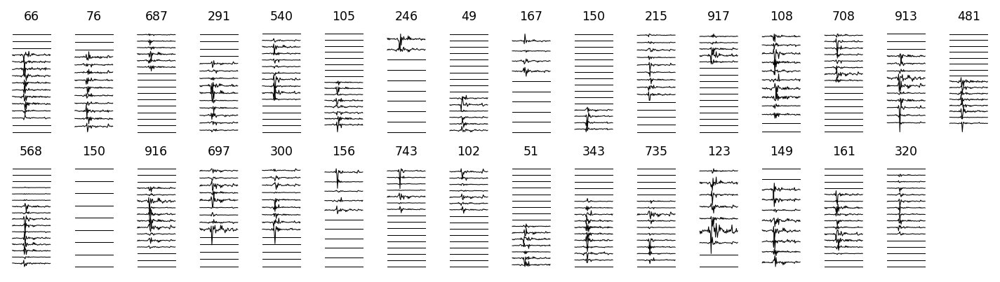

Plotting mua units for trial: VF_6_250422_131240
Saved plot for trial VF_6_250422_131240, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_mua_waveforms_on_probe.png


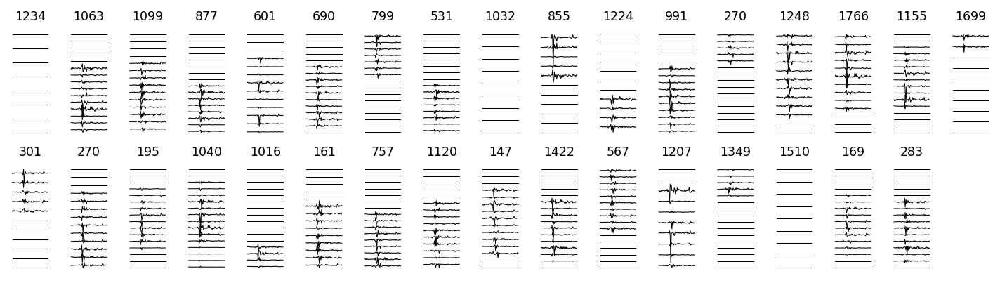

Saved plot for trial VF_7_250422_131739, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_summmary_plots.png


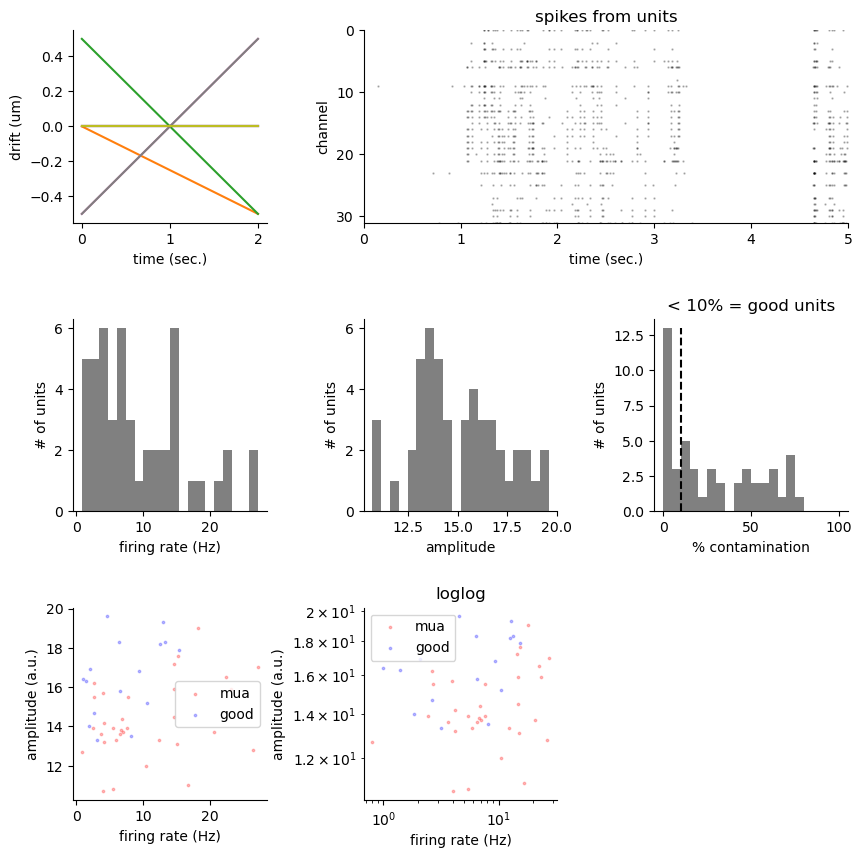

Plotting good units for trial: VF_7_250422_131739
Saved plot for trial VF_7_250422_131739, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_good_waveforms_on_probe.png


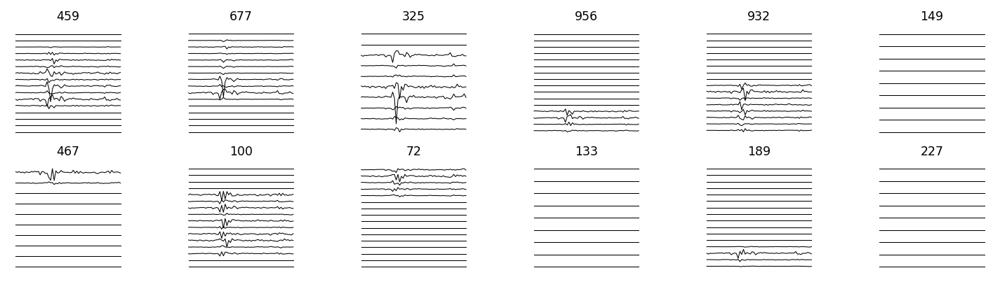

Plotting mua units for trial: VF_7_250422_131739
Saved plot for trial VF_7_250422_131739, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_mua_waveforms_on_probe.png


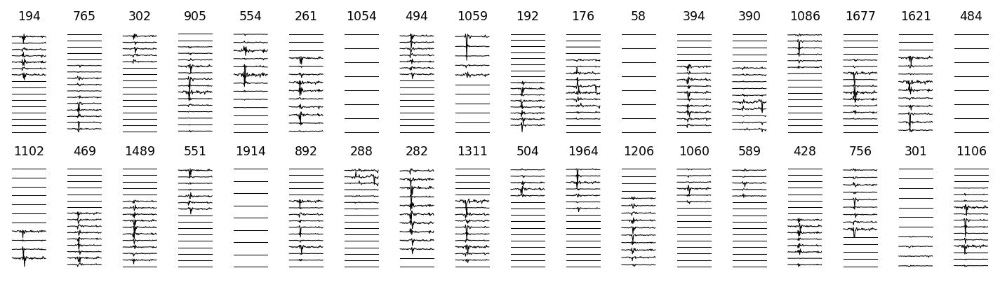

Saved plot for trial VF_8_250422_132231, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_summmary_plots.png


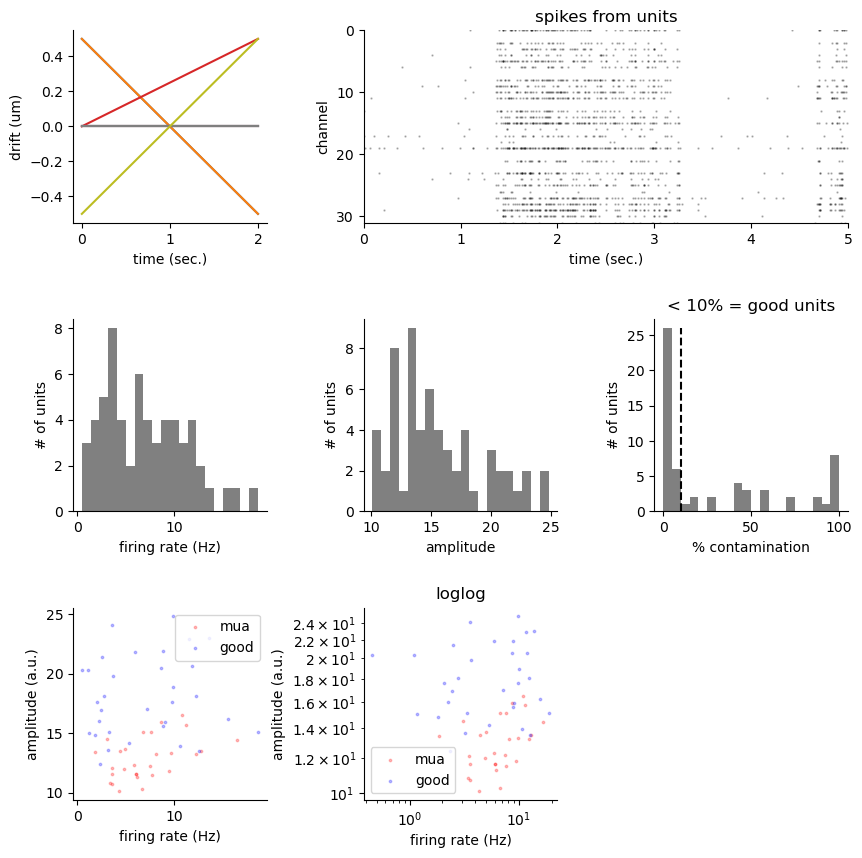

Plotting good units for trial: VF_8_250422_132231
Saved plot for trial VF_8_250422_132231, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_good_waveforms_on_probe.png


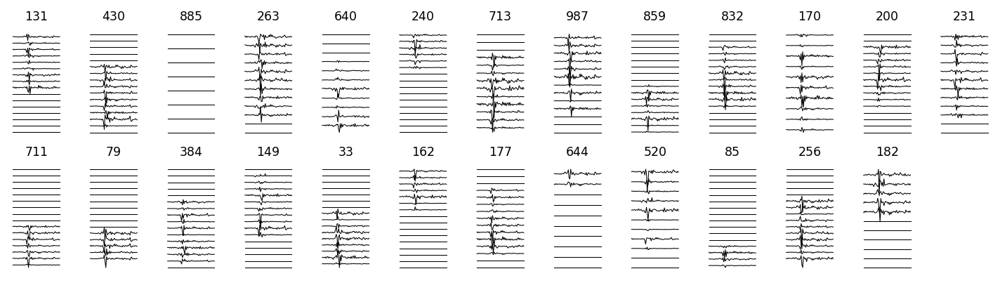

Plotting mua units for trial: VF_8_250422_132231
Saved plot for trial VF_8_250422_132231, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_mua_waveforms_on_probe.png


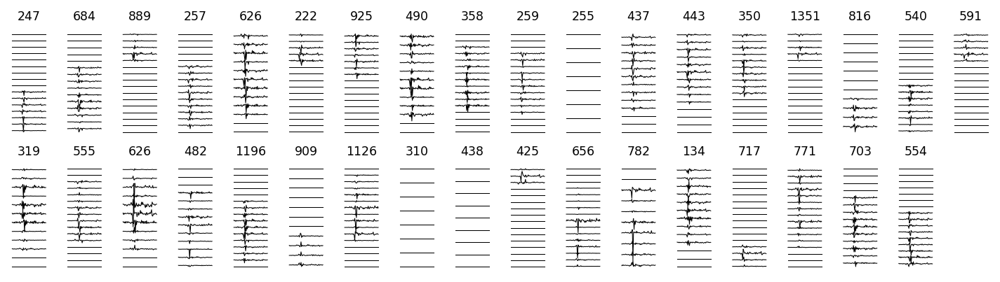

Saved plot for trial VF_9_250422_132717, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_summmary_plots.png


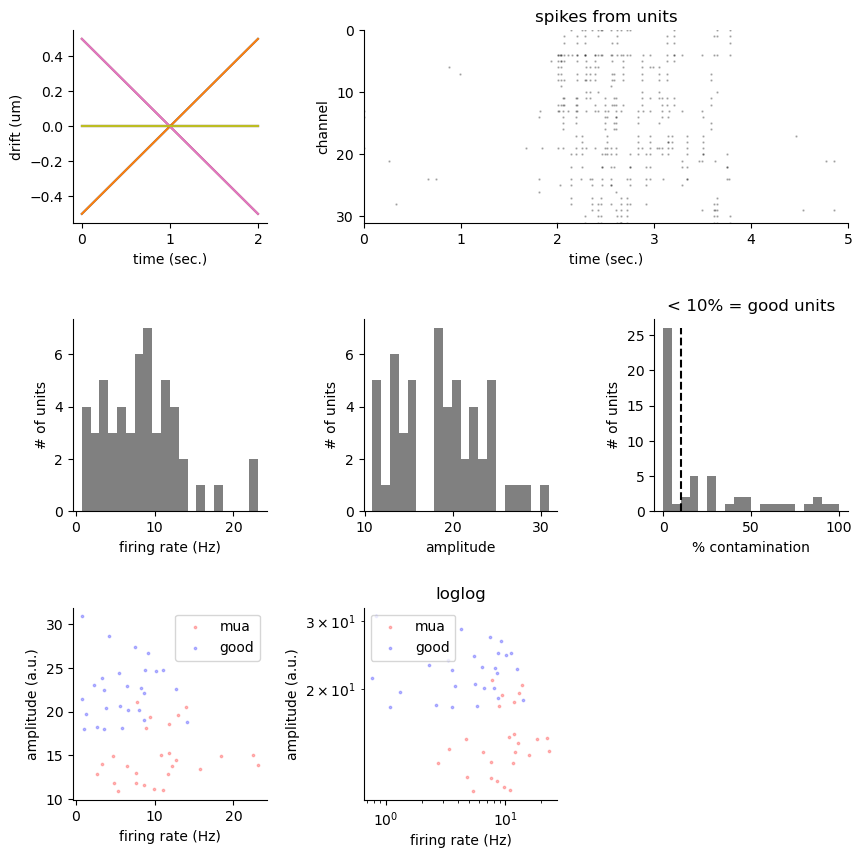

Plotting good units for trial: VF_9_250422_132717
Saved plot for trial VF_9_250422_132717, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_good_waveforms_on_probe.png


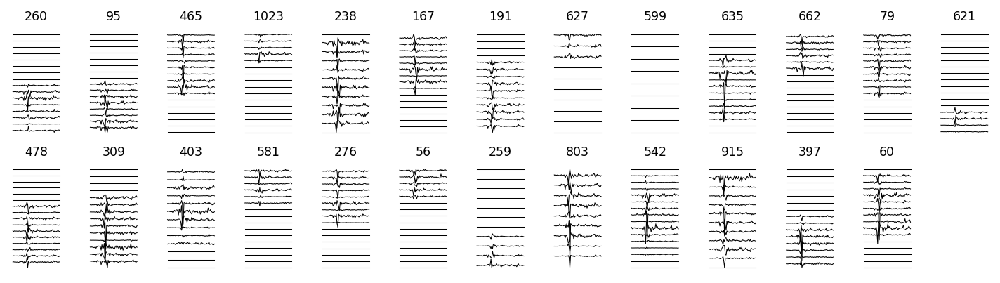

Plotting mua units for trial: VF_9_250422_132717
Saved plot for trial VF_9_250422_132717, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_mua_waveforms_on_probe.png


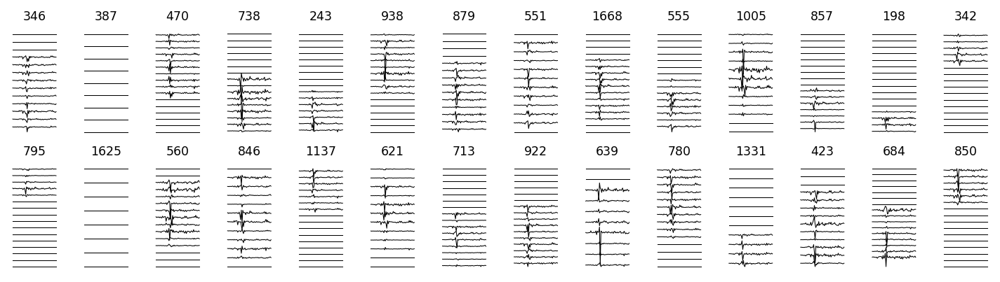

Saved plot for trial VF_10_250422_133218, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_summmary_plots.png


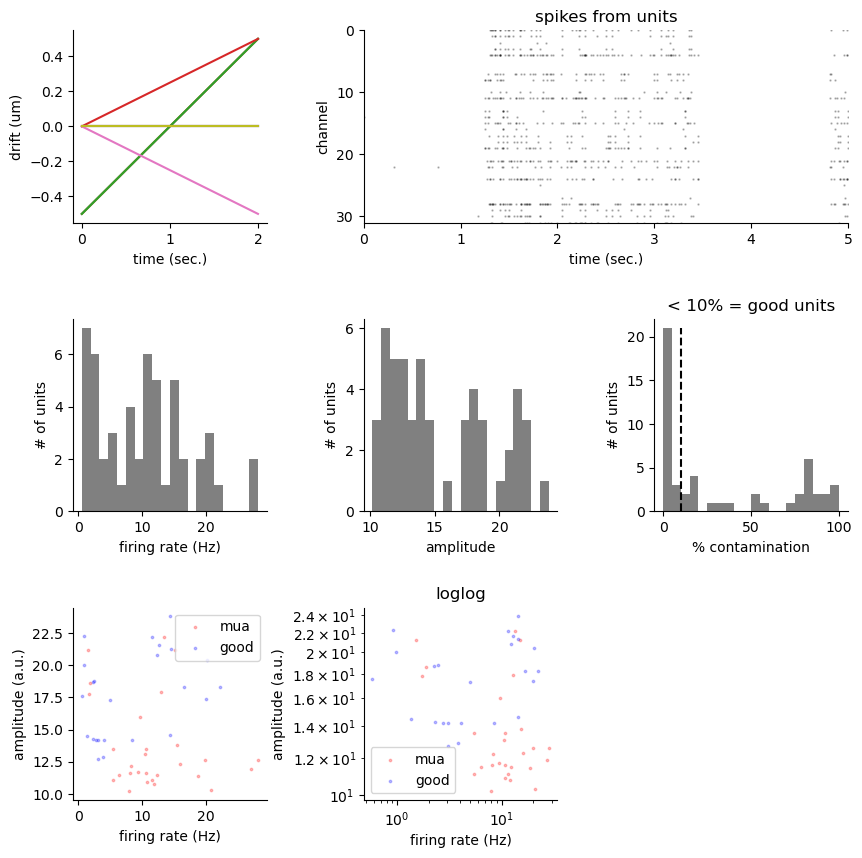

Plotting good units for trial: VF_10_250422_133218
Saved plot for trial VF_10_250422_133218, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_good_waveforms_on_probe.png


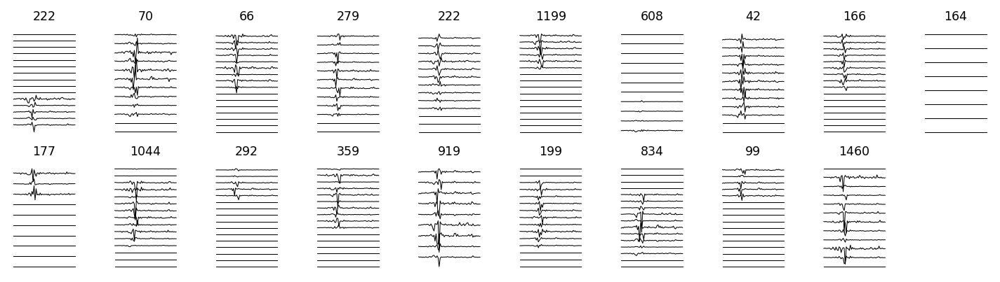

Plotting mua units for trial: VF_10_250422_133218
Saved plot for trial VF_10_250422_133218, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_mua_waveforms_on_probe.png


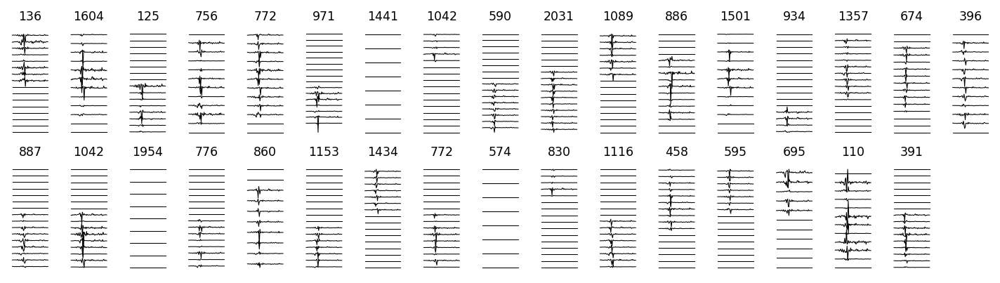

Saved plot for trial VF_11_250422_133722, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_summmary_plots.png


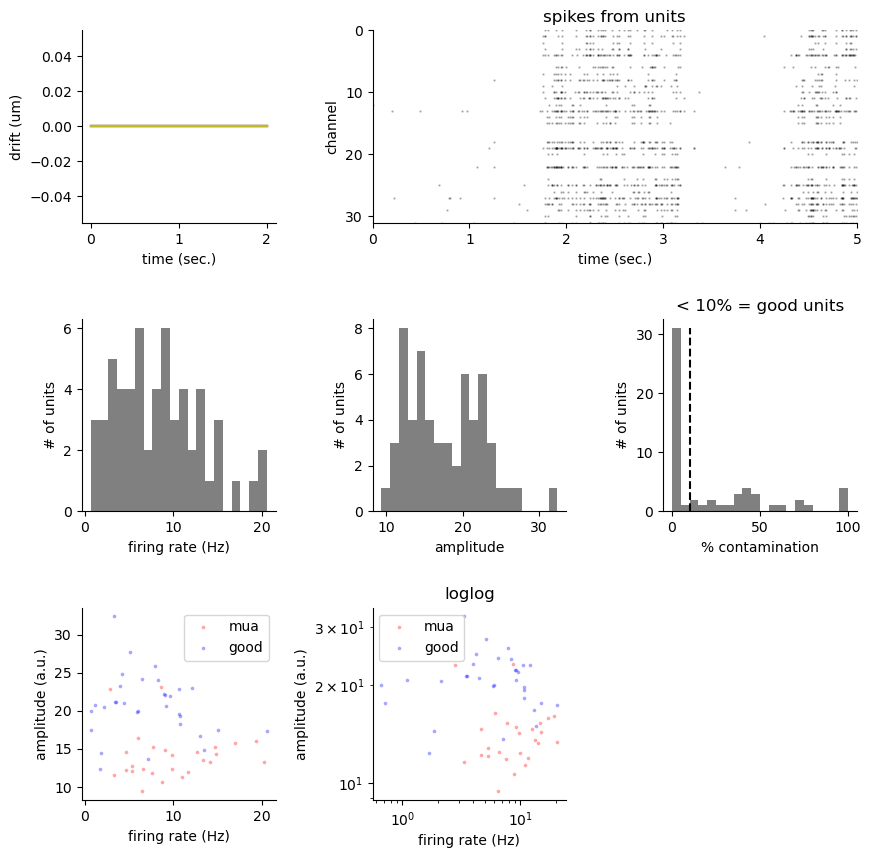

Plotting good units for trial: VF_11_250422_133722
Saved plot for trial VF_11_250422_133722, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_good_waveforms_on_probe.png


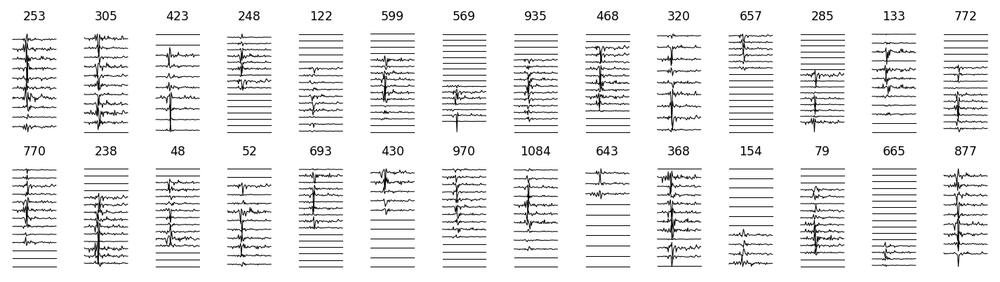

Plotting mua units for trial: VF_11_250422_133722
Saved plot for trial VF_11_250422_133722, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_mua_waveforms_on_probe.png


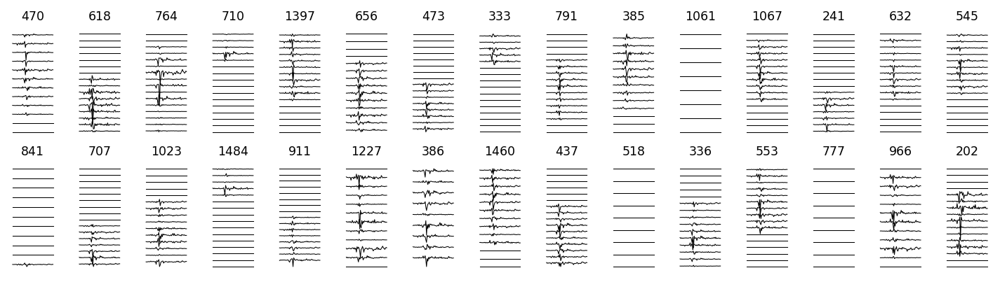

Saved plot for trial VF_12_250422_134214, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_summmary_plots.png


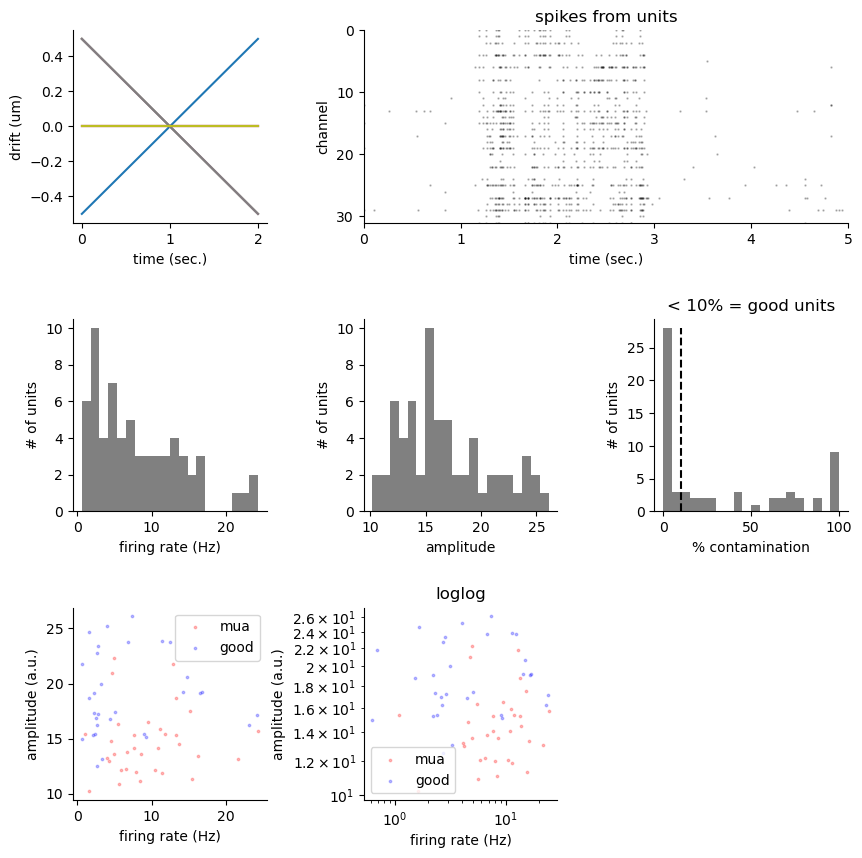

Plotting good units for trial: VF_12_250422_134214
Saved plot for trial VF_12_250422_134214, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_good_waveforms_on_probe.png


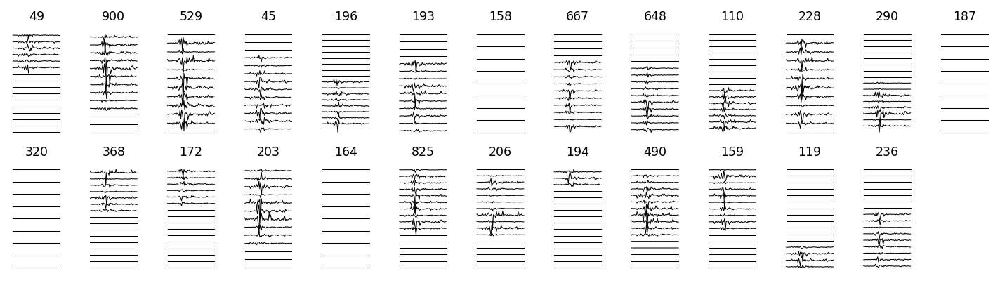

Plotting mua units for trial: VF_12_250422_134214
Saved plot for trial VF_12_250422_134214, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_mua_waveforms_on_probe.png


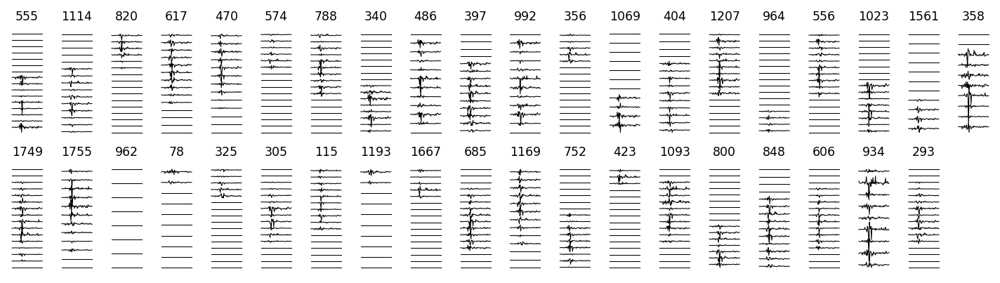

Saved plot for trial VF_13_250422_134725, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_summmary_plots.png


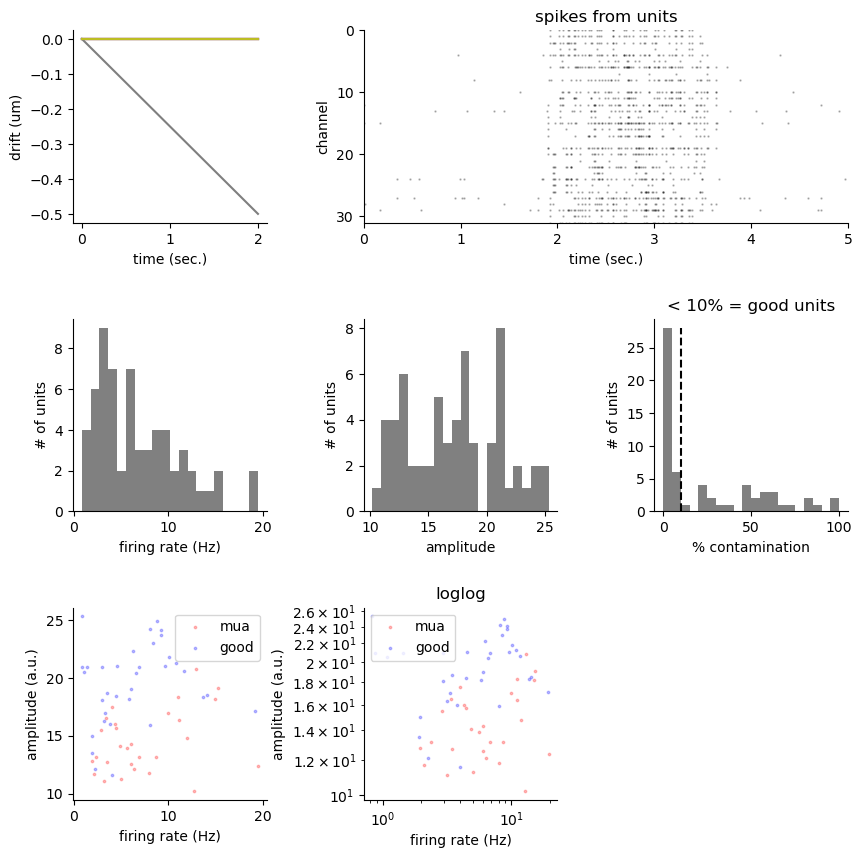

Plotting good units for trial: VF_13_250422_134725
Saved plot for trial VF_13_250422_134725, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_good_waveforms_on_probe.png


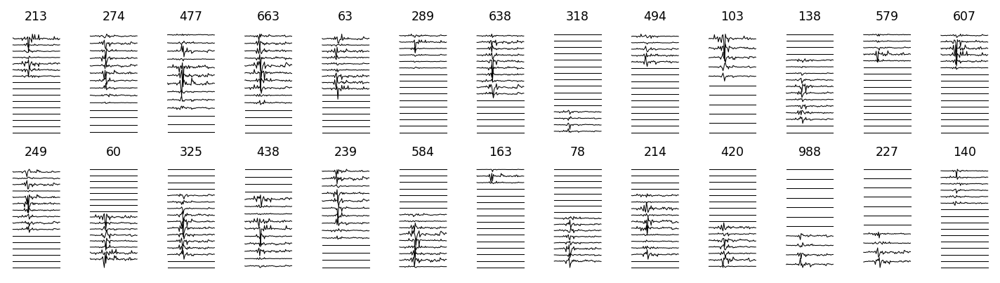

Plotting mua units for trial: VF_13_250422_134725
Saved plot for trial VF_13_250422_134725, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_mua_waveforms_on_probe.png


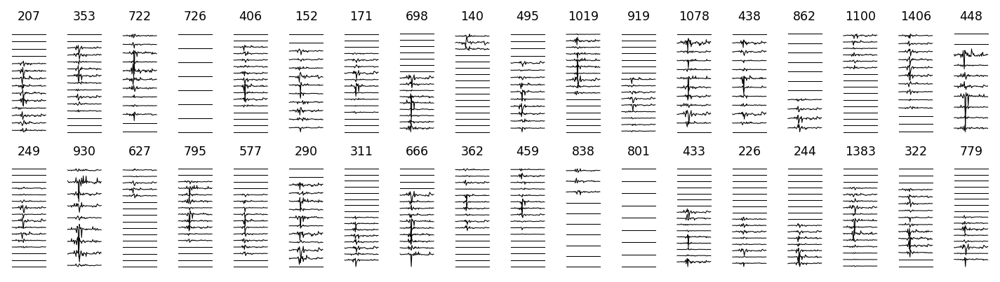

Saved plot for trial VF_14_250422_154410, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_summmary_plots.png


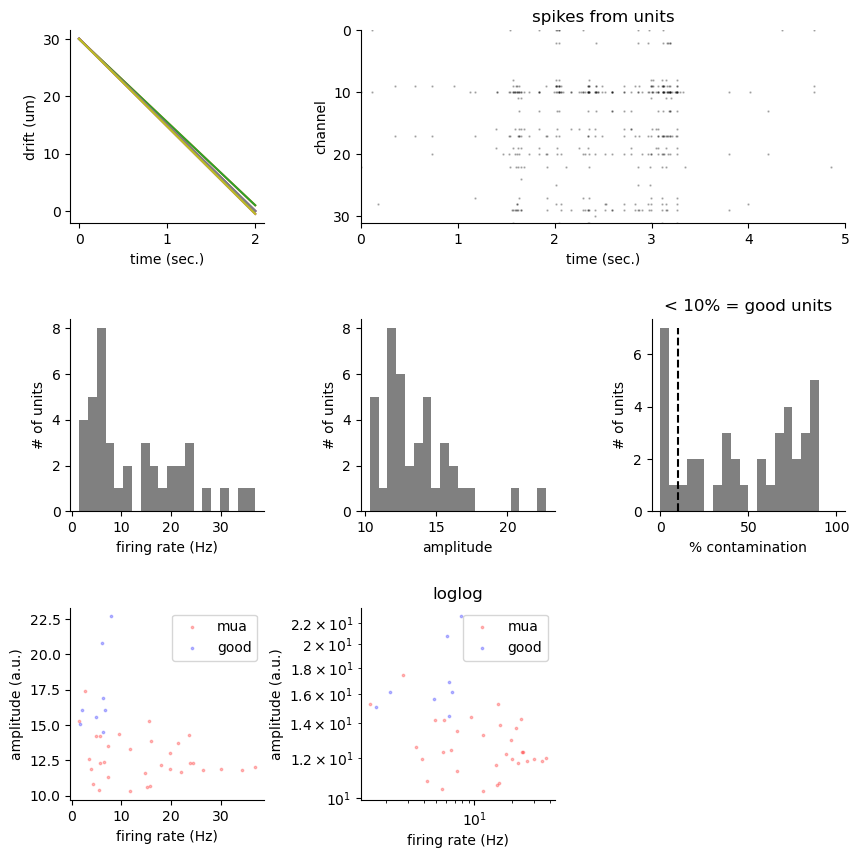

Plotting good units for trial: VF_14_250422_154410
Saved plot for trial VF_14_250422_154410, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_good_waveforms_on_probe.png


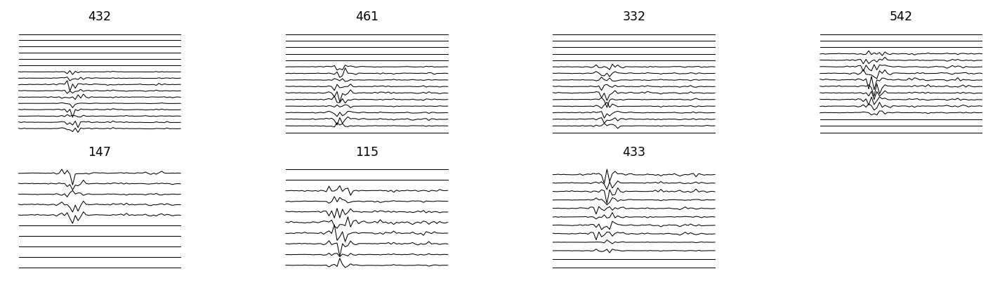

Plotting mua units for trial: VF_14_250422_154410
Saved plot for trial VF_14_250422_154410, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_mua_waveforms_on_probe.png


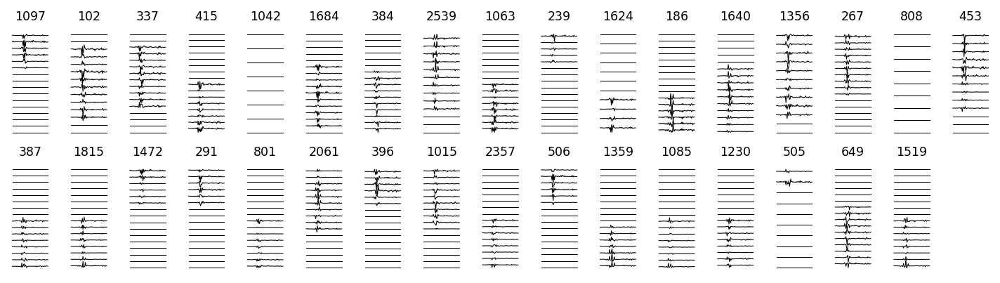

Saved plot for trial VF_14_250422_154410, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_summmary_plots.png


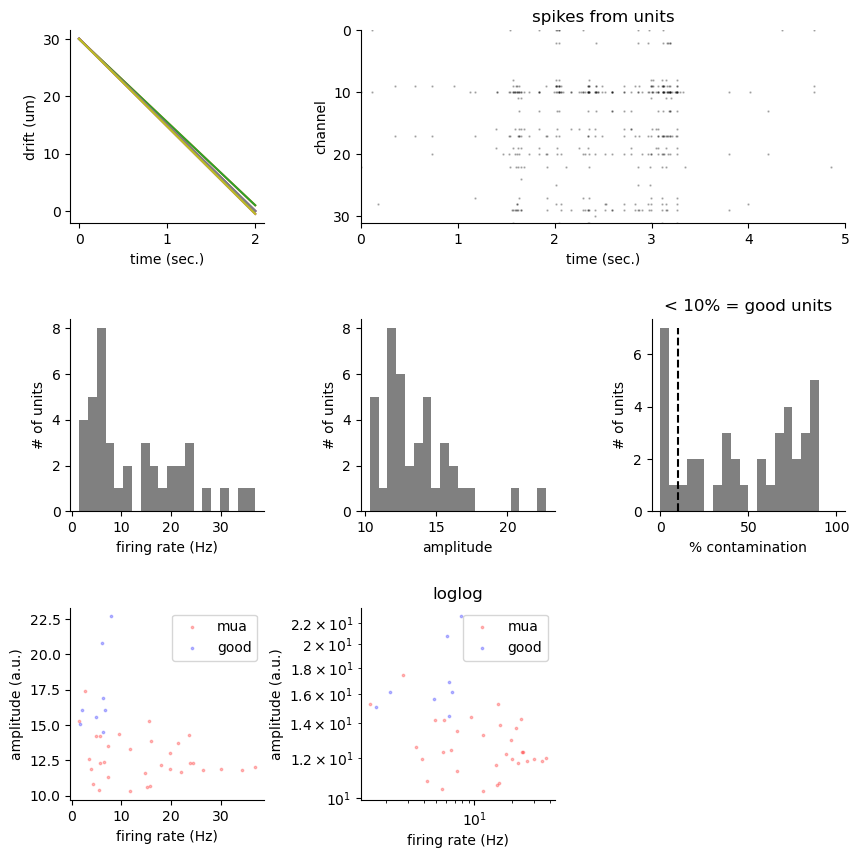

Plotting good units for trial: VF_14_250422_154410
Saved plot for trial VF_14_250422_154410, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_good_waveforms_on_probe.png


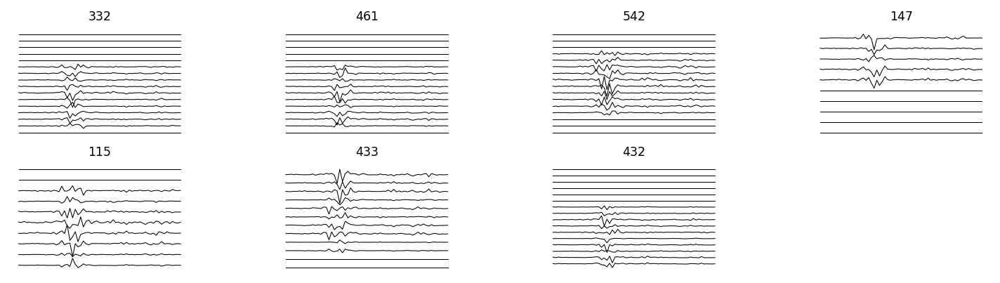

Plotting mua units for trial: VF_14_250422_154410
Saved plot for trial VF_14_250422_154410, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_mua_waveforms_on_probe.png


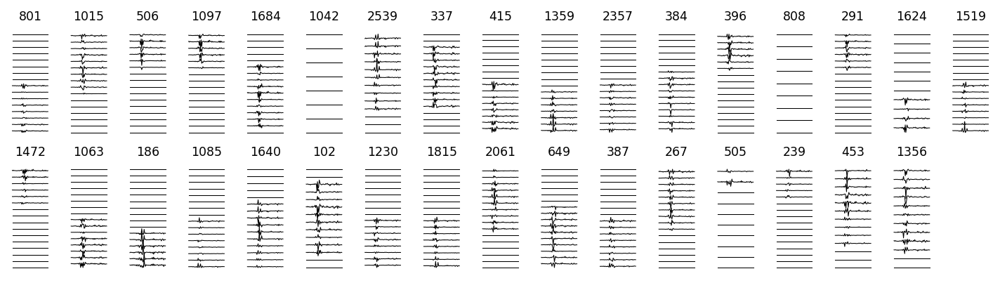

Saved plot for trial VF_15_250422_154935, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_summmary_plots.png


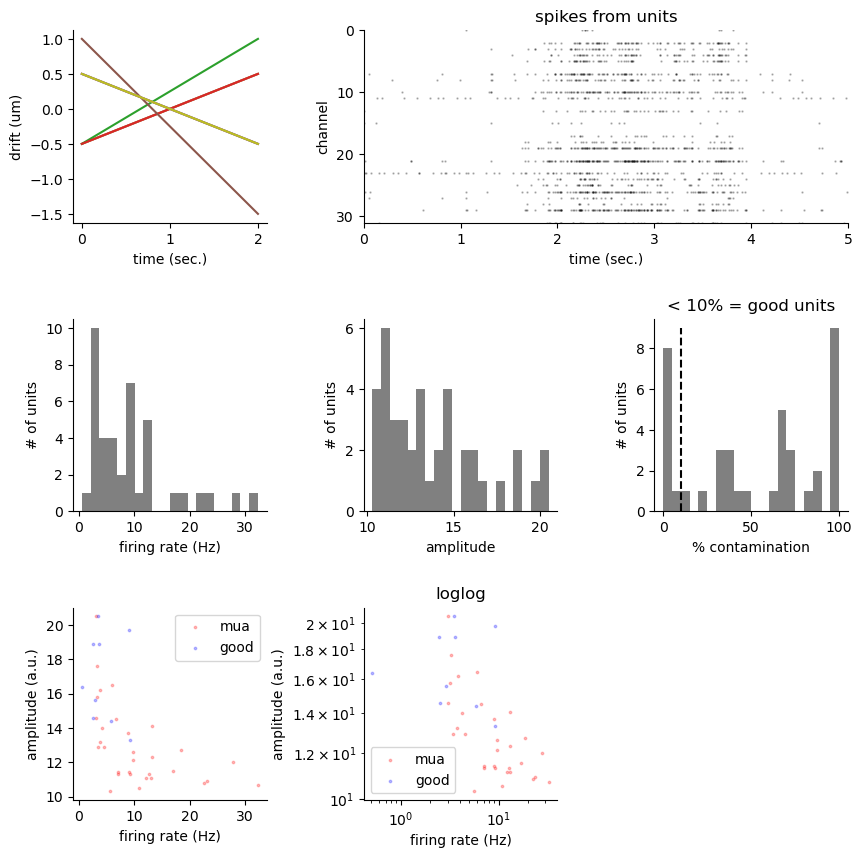

Plotting good units for trial: VF_15_250422_154935
Saved plot for trial VF_15_250422_154935, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_good_waveforms_on_probe.png


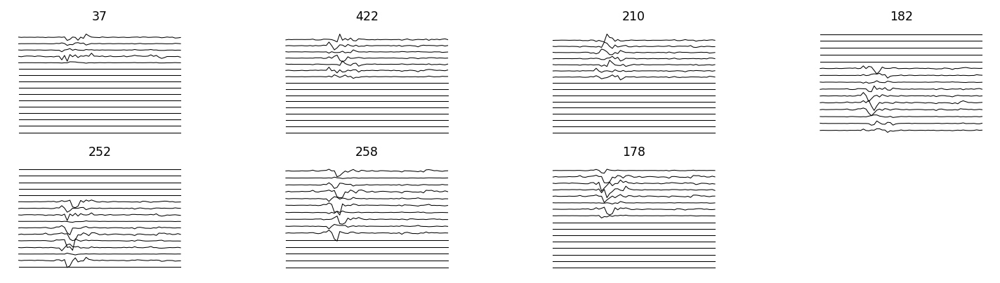

Plotting mua units for trial: VF_15_250422_154935
Saved plot for trial VF_15_250422_154935, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_mua_waveforms_on_probe.png


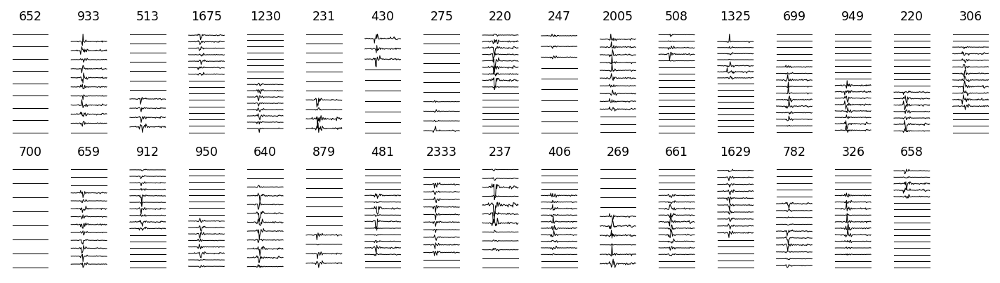

Saved plot for trial VF_16_250422_155509, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_summmary_plots.png


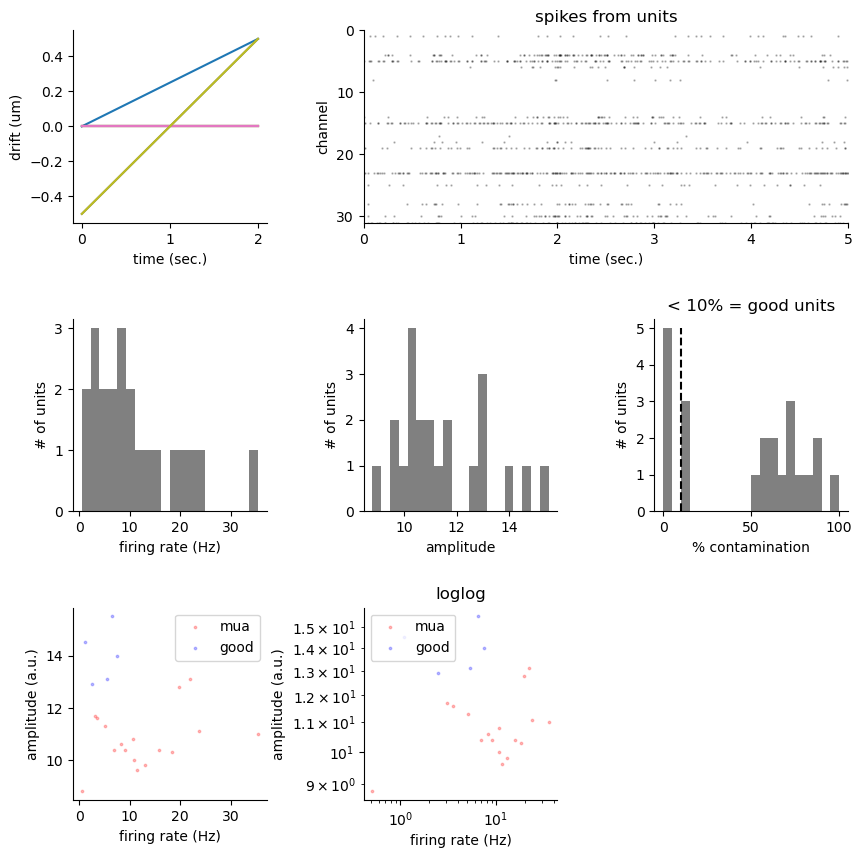

Plotting good units for trial: VF_16_250422_155509
Saved plot for trial VF_16_250422_155509, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_good_waveforms_on_probe.png


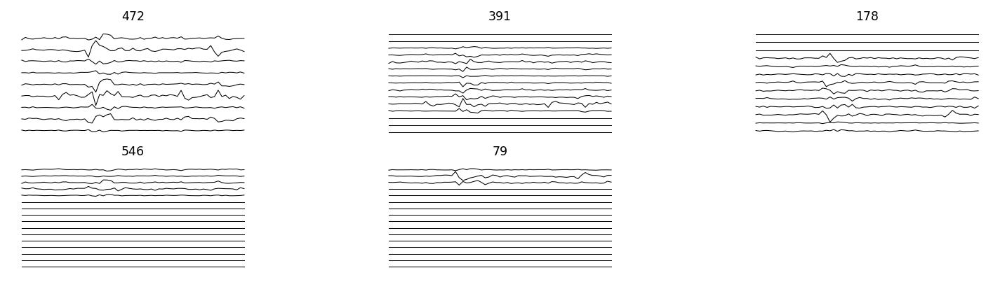

Plotting mua units for trial: VF_16_250422_155509
Saved plot for trial VF_16_250422_155509, at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_mua_waveforms_on_probe.png


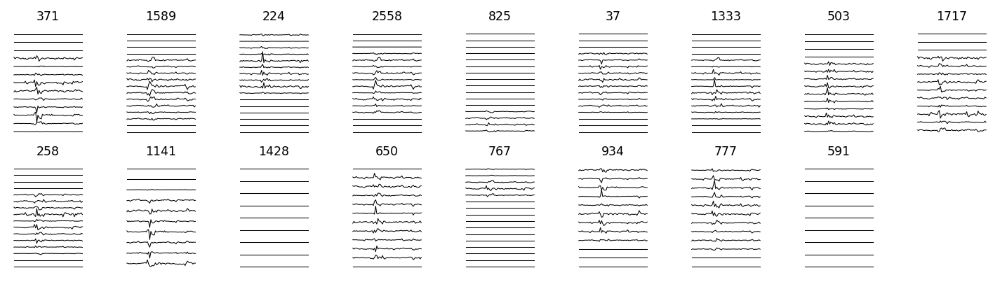

In [13]:
ks_wrappers["DW361"].plot_trial_results(dw361_trials)

### plot characteristic waveform for each neuron

#### DW322

In [14]:
# ks_wrappers["DW322"].plot_cluster_waveforms(dw322_trials)

#### DW323

In [15]:
# ks_wrappers["DW323"].plot_cluster_waveforms(dw323_trials)

#### DW327

In [16]:
# ks_wrappers["DW327"].plot_cluster_waveforms(dw327_trials)

#### DW361

Plotting waveforms for trial VF_1_250422_124925: Good clusters found: [0, 3, 4, 10, 11, 21, 23, 26, 28, 30, 32, 33, 36]
Saved plot for trial VF_1_250422_124925, cluster 0 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_0.png


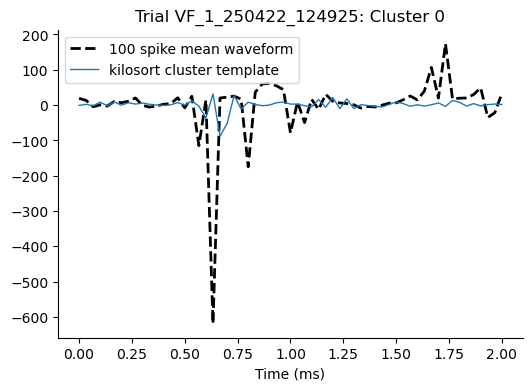

Error generating waveform for cluster 3 in trial VF_1_250422_124925: Invalid number of data points (0) specified
Saved plot for trial VF_1_250422_124925, cluster 4 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_4.png


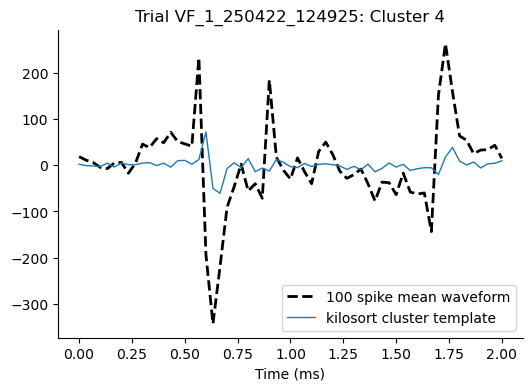

Saved plot for trial VF_1_250422_124925, cluster 10 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_10.png


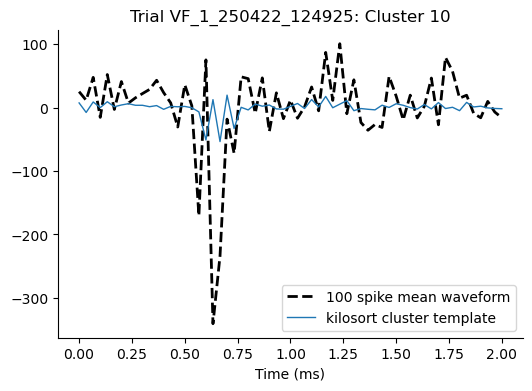

Saved plot for trial VF_1_250422_124925, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_11.png


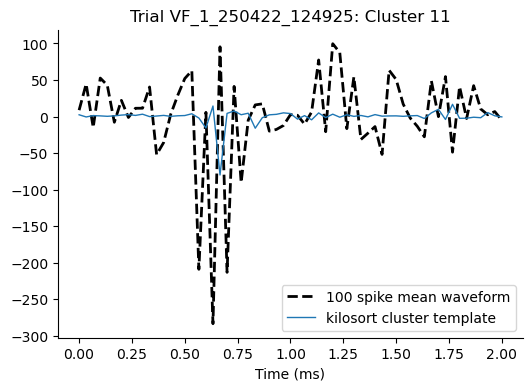

Saved plot for trial VF_1_250422_124925, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_21.png


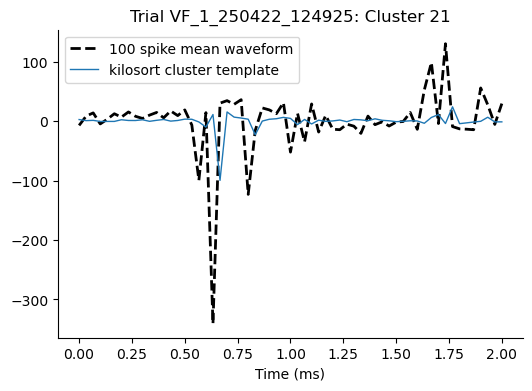

Saved plot for trial VF_1_250422_124925, cluster 23 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_23.png


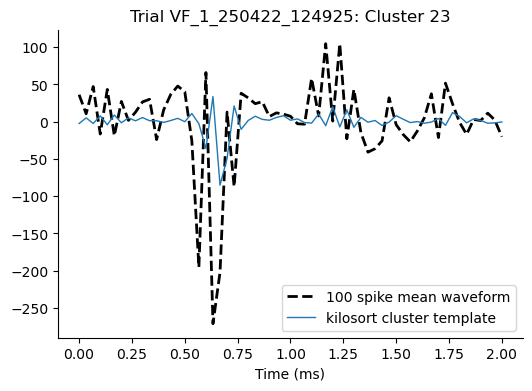

Saved plot for trial VF_1_250422_124925, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_26.png


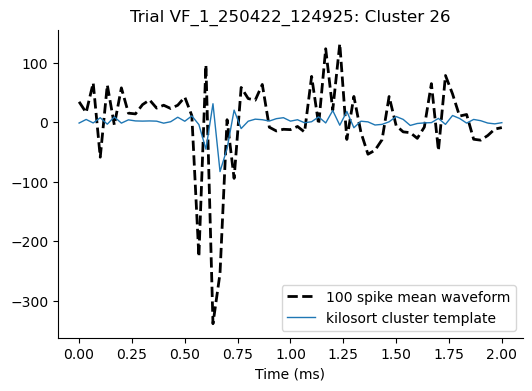

Saved plot for trial VF_1_250422_124925, cluster 28 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_28.png


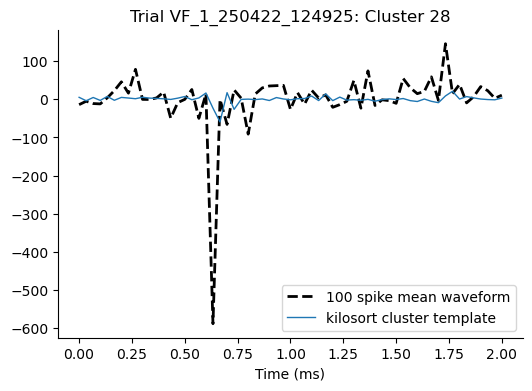

Saved plot for trial VF_1_250422_124925, cluster 30 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_30.png


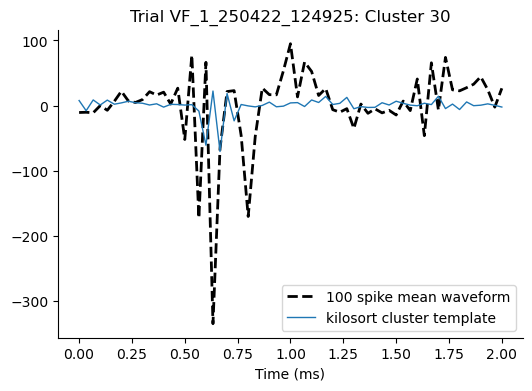

Saved plot for trial VF_1_250422_124925, cluster 32 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_32.png


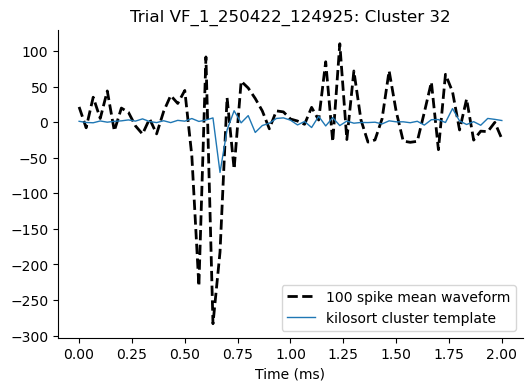

Saved plot for trial VF_1_250422_124925, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_33.png


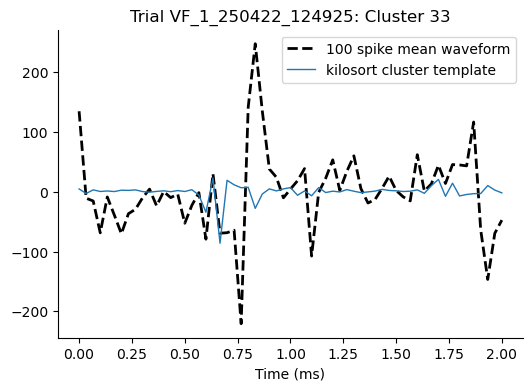

Saved plot for trial VF_1_250422_124925, cluster 36 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_1_250422_124925_cluster_36.png


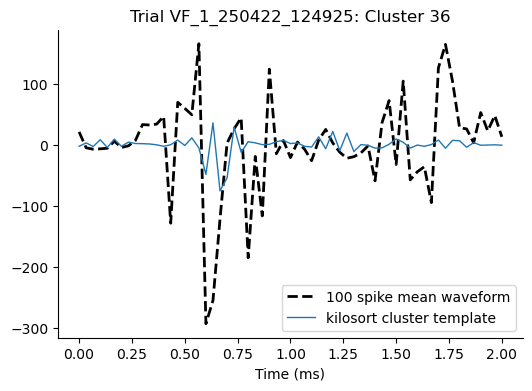

Plotting waveforms for trial VF_2_250422_125146: Good clusters found: [0, 5, 11, 12, 13, 16, 17, 22, 27, 28, 29, 31, 33, 36, 38, 42, 43, 51, 56, 59, 61]
Saved plot for trial VF_2_250422_125146, cluster 0 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_0.png


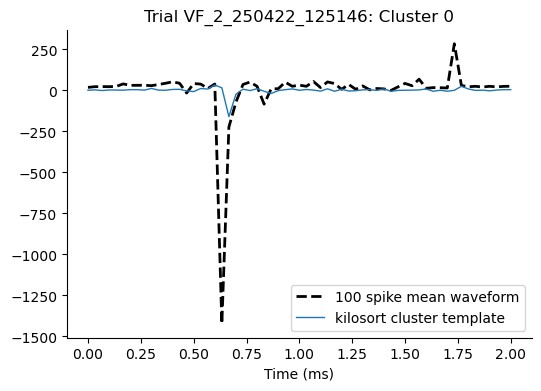

Saved plot for trial VF_2_250422_125146, cluster 5 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_5.png


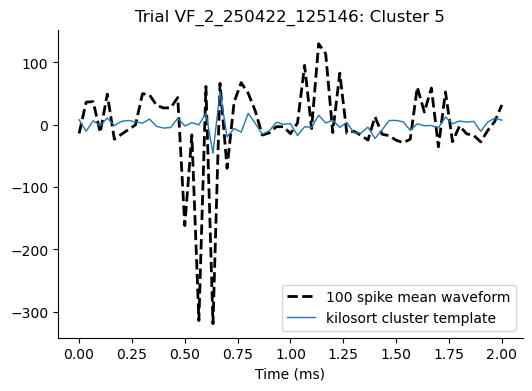

Saved plot for trial VF_2_250422_125146, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_11.png


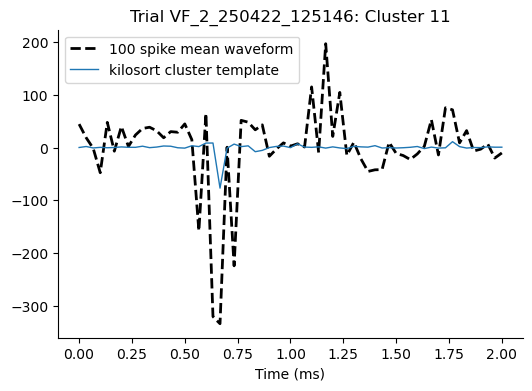

Saved plot for trial VF_2_250422_125146, cluster 12 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_12.png


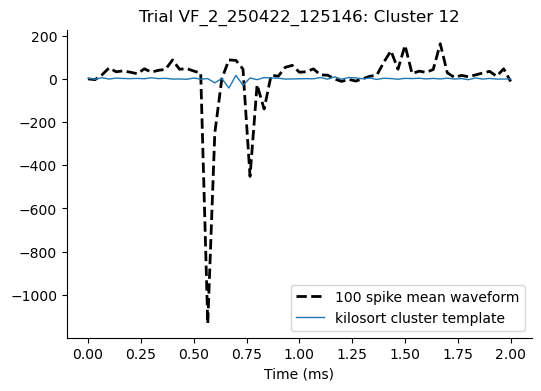

Saved plot for trial VF_2_250422_125146, cluster 13 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_13.png


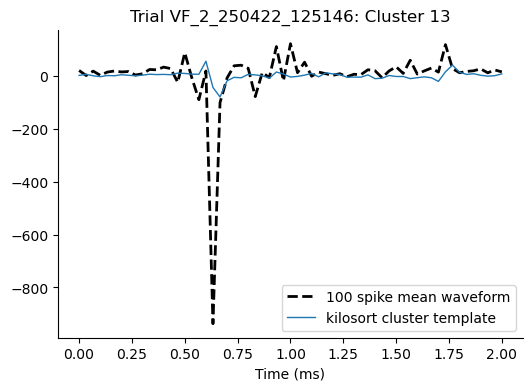

Saved plot for trial VF_2_250422_125146, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_16.png


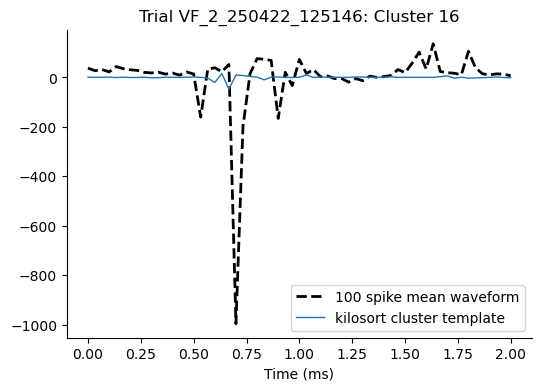

Saved plot for trial VF_2_250422_125146, cluster 17 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_17.png


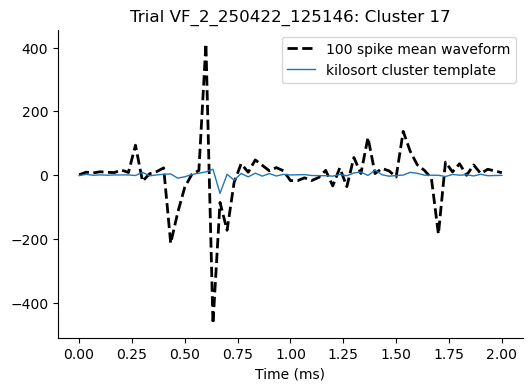

Saved plot for trial VF_2_250422_125146, cluster 22 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_22.png


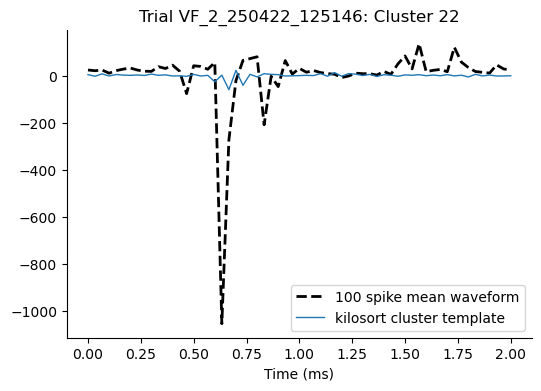

Saved plot for trial VF_2_250422_125146, cluster 27 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_27.png


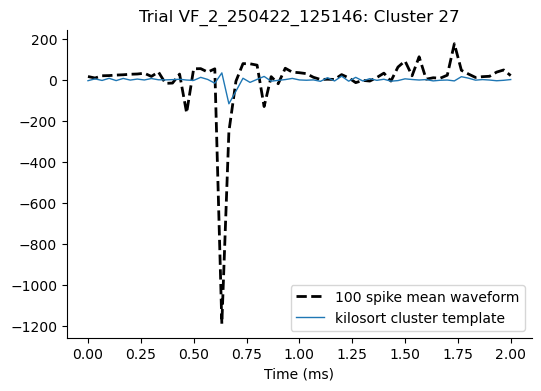

Saved plot for trial VF_2_250422_125146, cluster 28 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_28.png


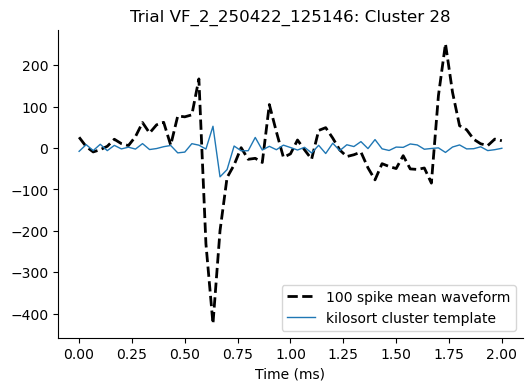

Saved plot for trial VF_2_250422_125146, cluster 29 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_29.png


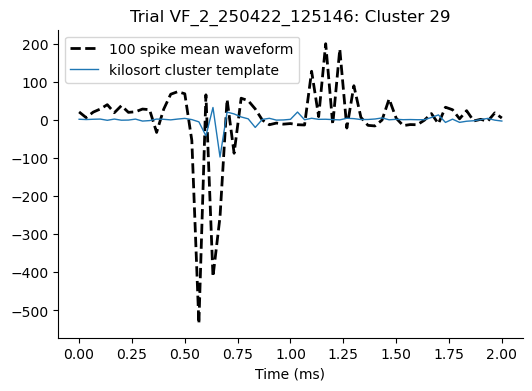

Saved plot for trial VF_2_250422_125146, cluster 31 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_31.png


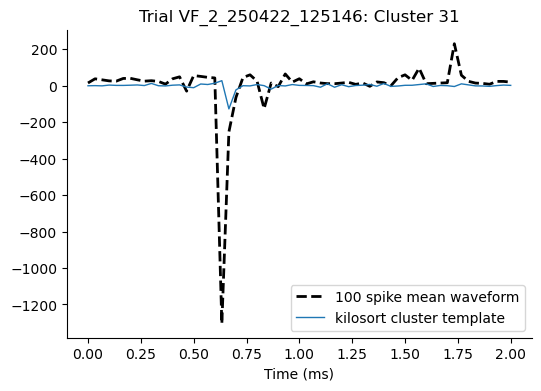

Saved plot for trial VF_2_250422_125146, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_33.png


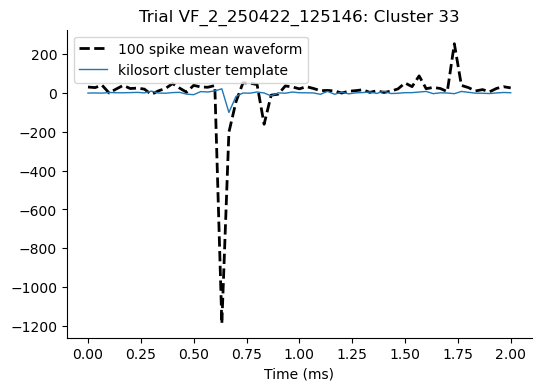

Saved plot for trial VF_2_250422_125146, cluster 36 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_36.png


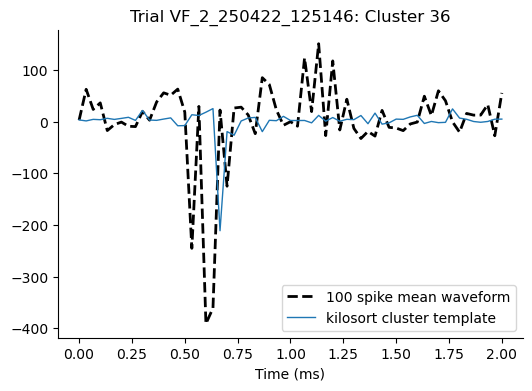

Saved plot for trial VF_2_250422_125146, cluster 38 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_38.png


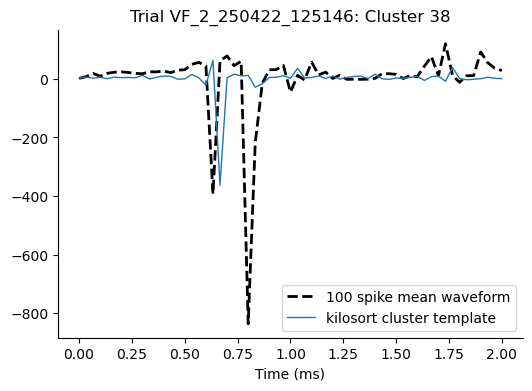

Saved plot for trial VF_2_250422_125146, cluster 42 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_42.png


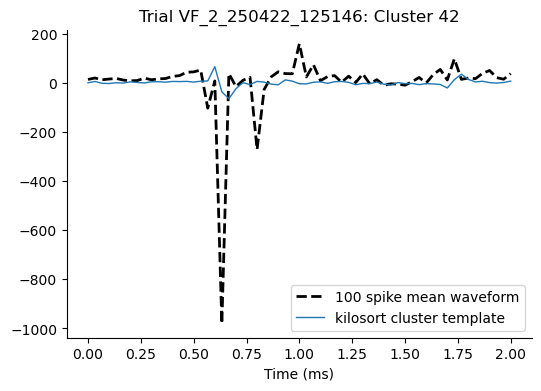

Saved plot for trial VF_2_250422_125146, cluster 43 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_43.png


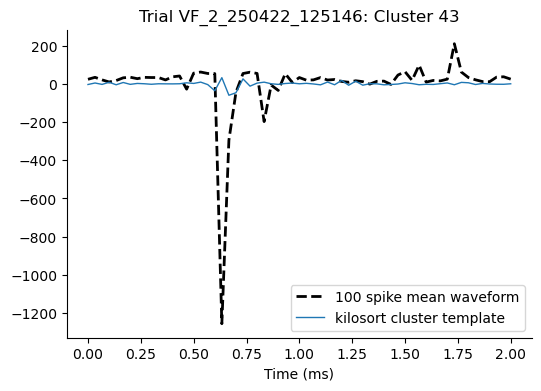

Saved plot for trial VF_2_250422_125146, cluster 51 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_51.png


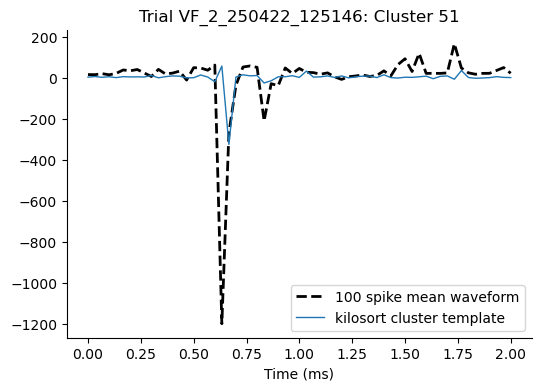

Saved plot for trial VF_2_250422_125146, cluster 56 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_56.png


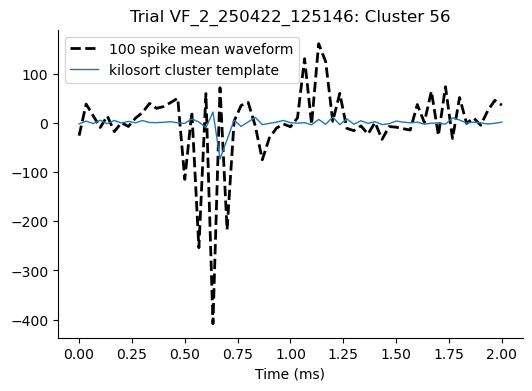

Saved plot for trial VF_2_250422_125146, cluster 59 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_59.png


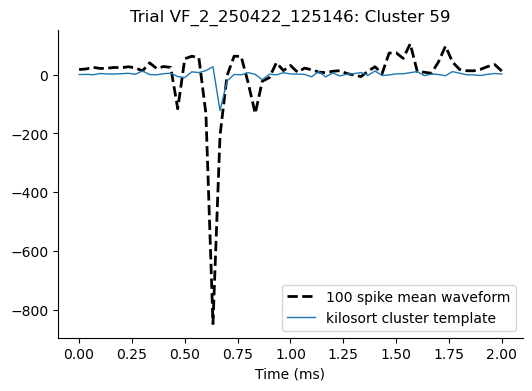

Saved plot for trial VF_2_250422_125146, cluster 61 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_2_250422_125146_cluster_61.png


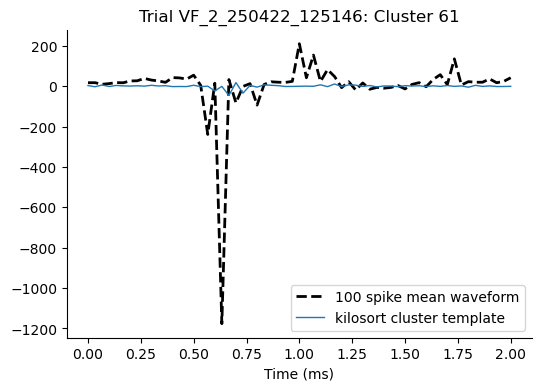

Plotting waveforms for trial VF_3_250422_125632: Good clusters found: [1, 3, 8, 11, 14, 15, 16, 18, 20, 22, 23, 25, 27, 28, 30, 31, 32, 39, 40, 48]
Saved plot for trial VF_3_250422_125632, cluster 1 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_1.png


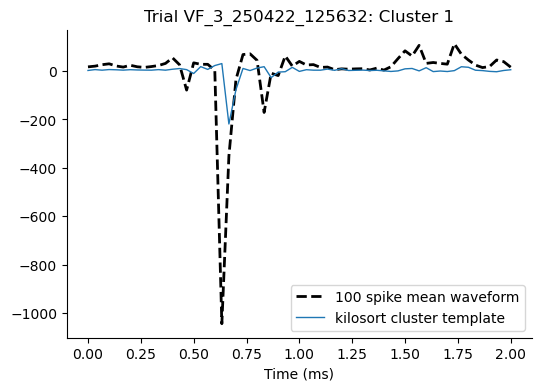

Saved plot for trial VF_3_250422_125632, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_3.png


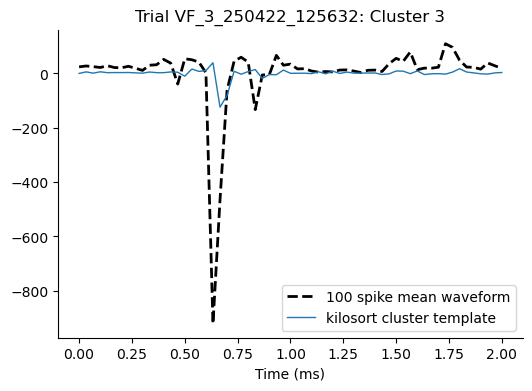

Saved plot for trial VF_3_250422_125632, cluster 8 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_8.png


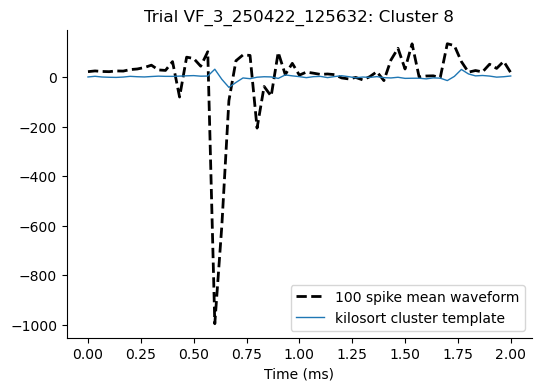

Saved plot for trial VF_3_250422_125632, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_11.png


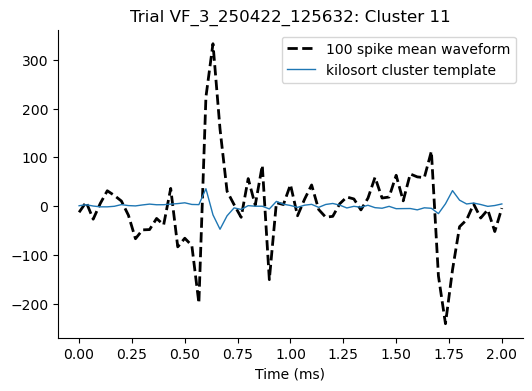

Saved plot for trial VF_3_250422_125632, cluster 14 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_14.png


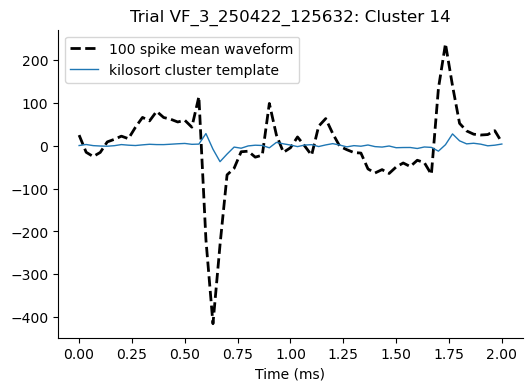

Saved plot for trial VF_3_250422_125632, cluster 15 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_15.png


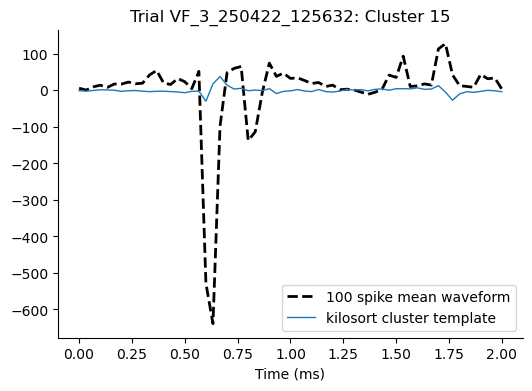

Saved plot for trial VF_3_250422_125632, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_16.png


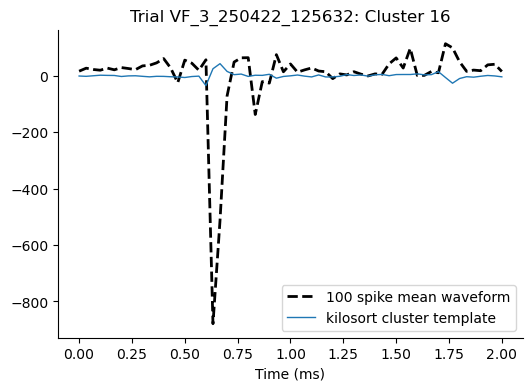

Saved plot for trial VF_3_250422_125632, cluster 18 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_18.png


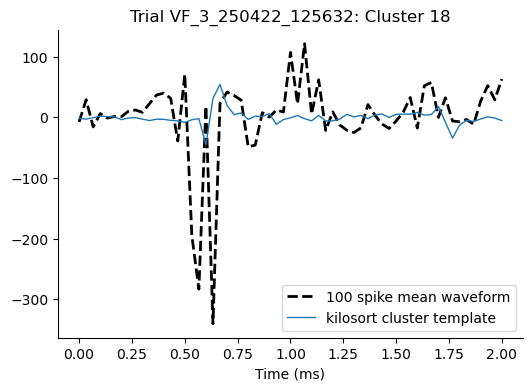

Saved plot for trial VF_3_250422_125632, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_20.png


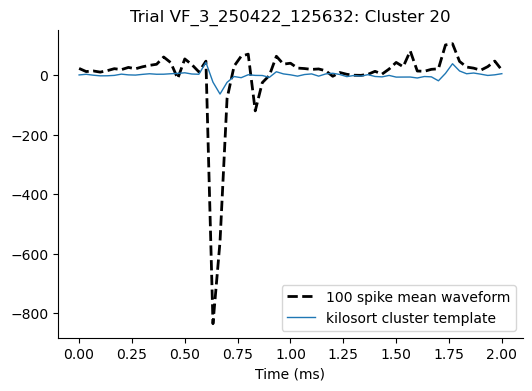

Saved plot for trial VF_3_250422_125632, cluster 22 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_22.png


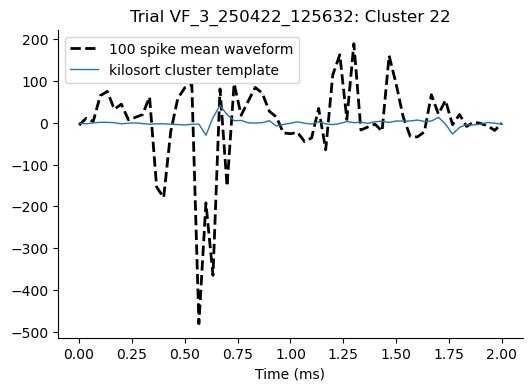

Saved plot for trial VF_3_250422_125632, cluster 23 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_23.png


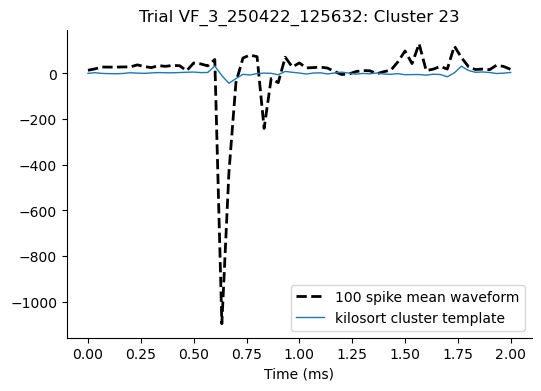

Saved plot for trial VF_3_250422_125632, cluster 25 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_25.png


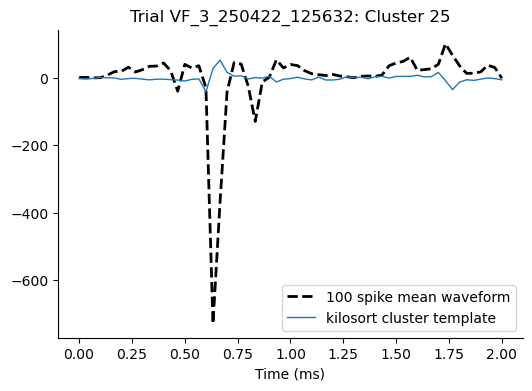

Saved plot for trial VF_3_250422_125632, cluster 27 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_27.png


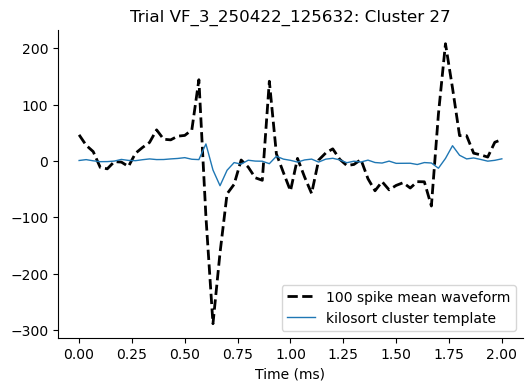

Saved plot for trial VF_3_250422_125632, cluster 28 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_28.png


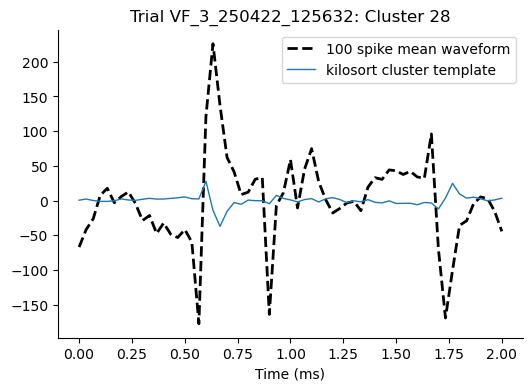

Saved plot for trial VF_3_250422_125632, cluster 30 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_30.png


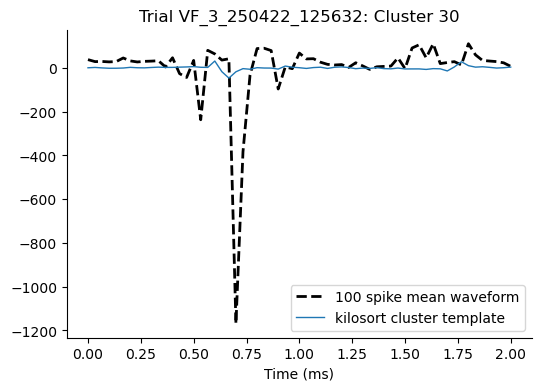

Saved plot for trial VF_3_250422_125632, cluster 31 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_31.png


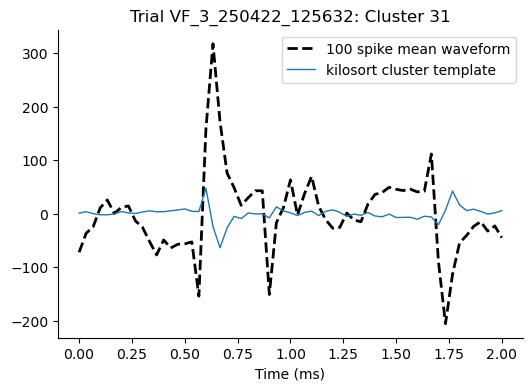

Saved plot for trial VF_3_250422_125632, cluster 32 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_32.png


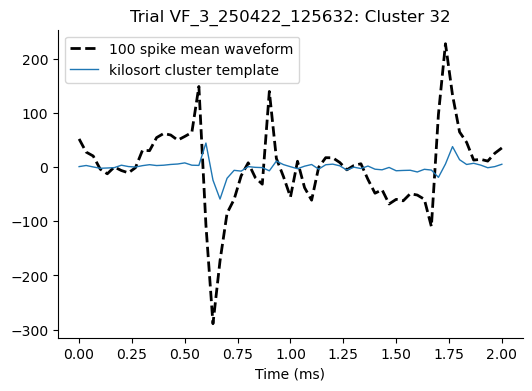

Saved plot for trial VF_3_250422_125632, cluster 39 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_39.png


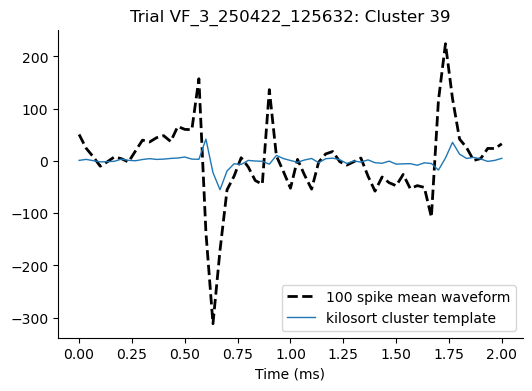

Saved plot for trial VF_3_250422_125632, cluster 40 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_40.png


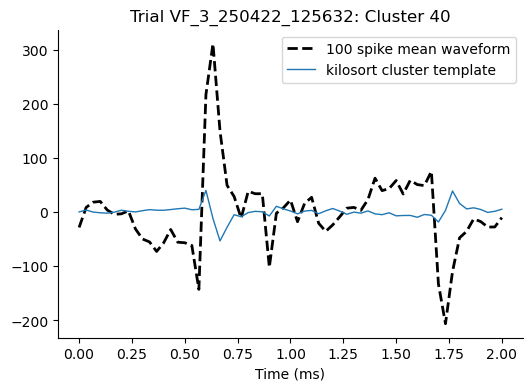

Saved plot for trial VF_3_250422_125632, cluster 48 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_3_250422_125632_cluster_48.png


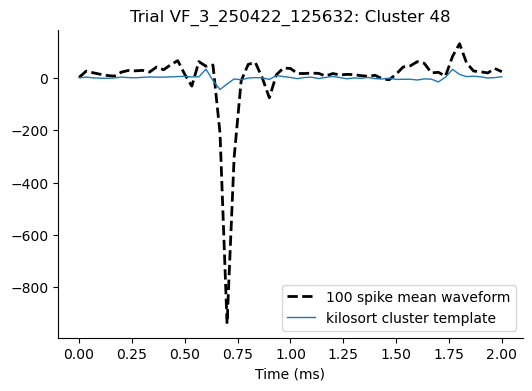

Plotting waveforms for trial VF_4_250422_130213: Good clusters found: [0, 1, 3, 4, 5, 6, 8, 12, 13, 15, 16, 19, 21, 23, 24, 26, 27, 29, 30, 31, 33]
Saved plot for trial VF_4_250422_130213, cluster 0 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_0.png


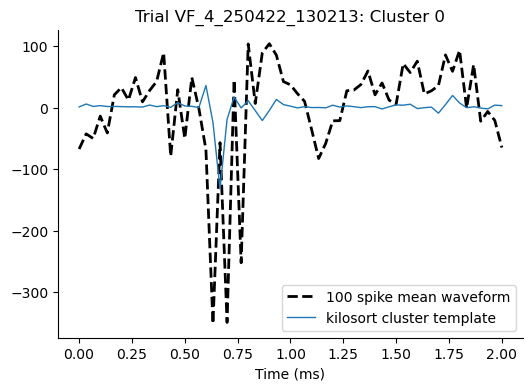

Saved plot for trial VF_4_250422_130213, cluster 1 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_1.png


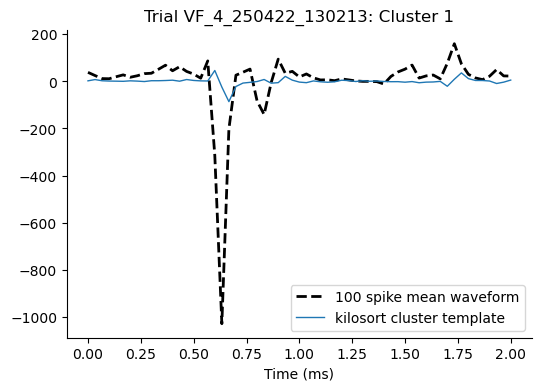

Saved plot for trial VF_4_250422_130213, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_3.png


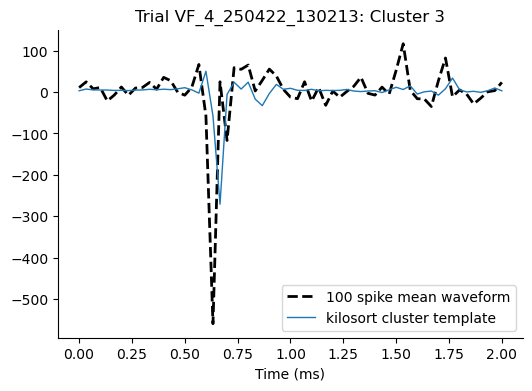

Saved plot for trial VF_4_250422_130213, cluster 4 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_4.png


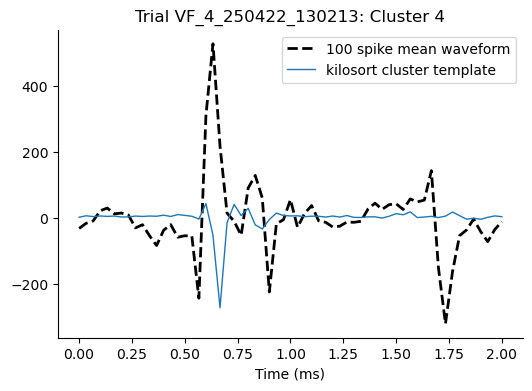

Saved plot for trial VF_4_250422_130213, cluster 5 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_5.png


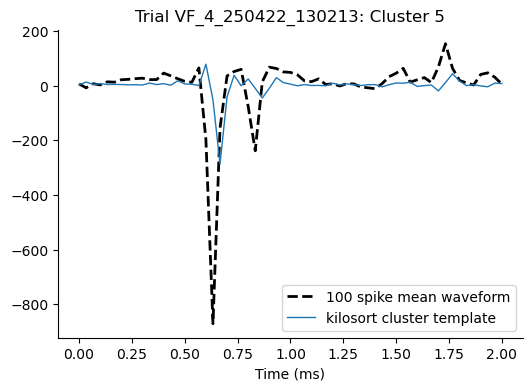

Saved plot for trial VF_4_250422_130213, cluster 6 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_6.png


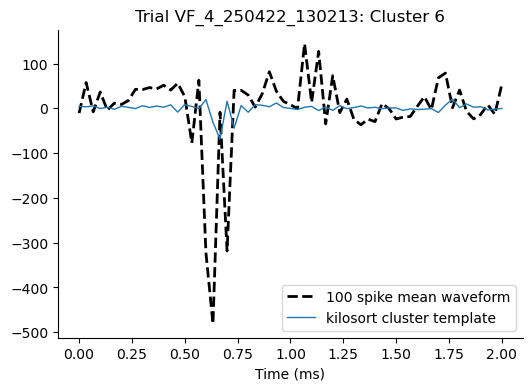

Saved plot for trial VF_4_250422_130213, cluster 8 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_8.png


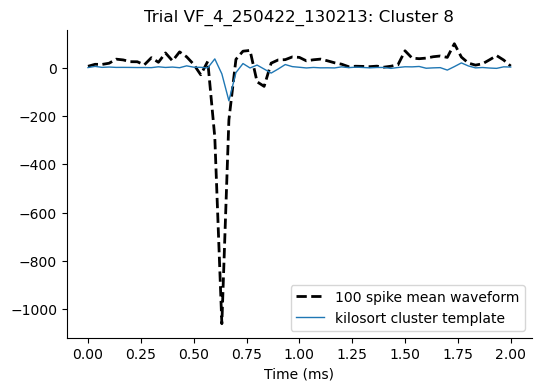

Saved plot for trial VF_4_250422_130213, cluster 12 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_12.png


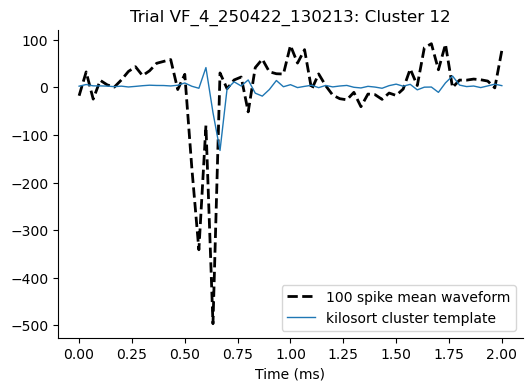

Saved plot for trial VF_4_250422_130213, cluster 13 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_13.png


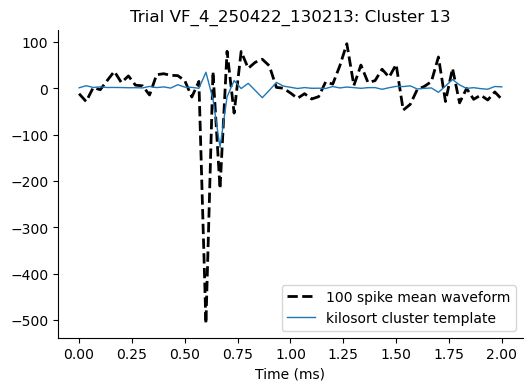

Saved plot for trial VF_4_250422_130213, cluster 15 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_15.png


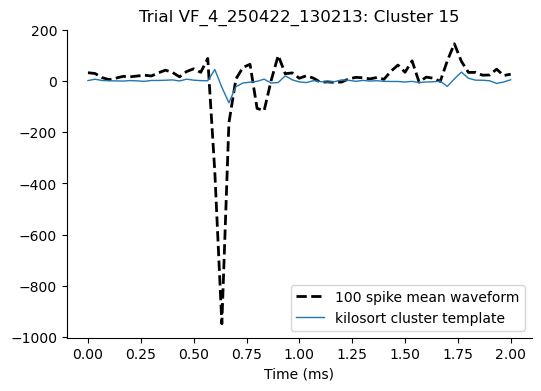

Saved plot for trial VF_4_250422_130213, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_16.png


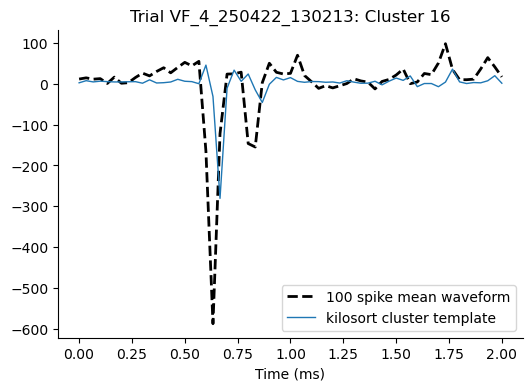

Saved plot for trial VF_4_250422_130213, cluster 19 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_19.png


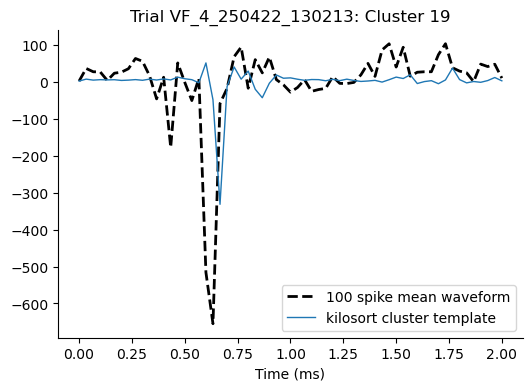

Saved plot for trial VF_4_250422_130213, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_21.png


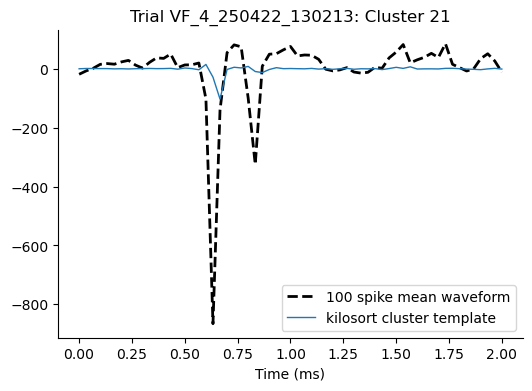

Saved plot for trial VF_4_250422_130213, cluster 23 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_23.png


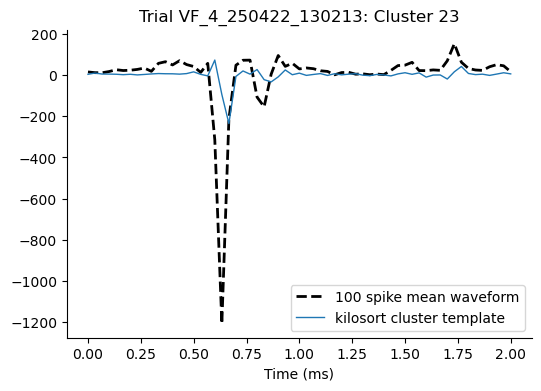

Saved plot for trial VF_4_250422_130213, cluster 24 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_24.png


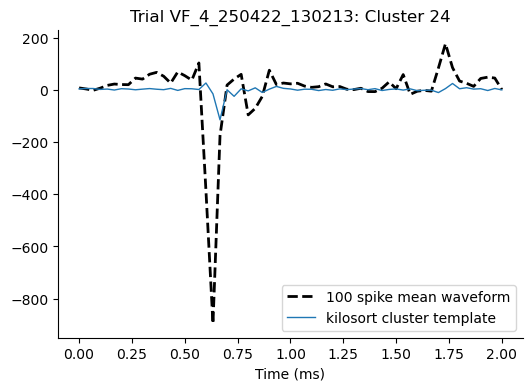

Saved plot for trial VF_4_250422_130213, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_26.png


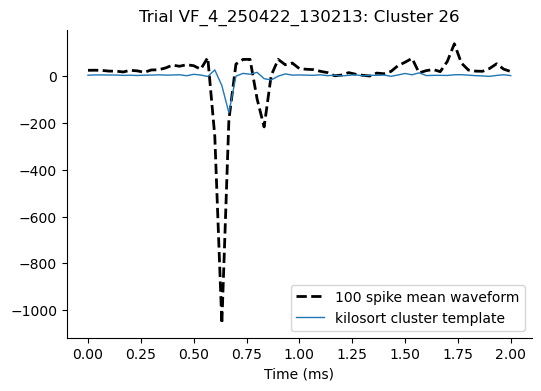

Saved plot for trial VF_4_250422_130213, cluster 27 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_27.png


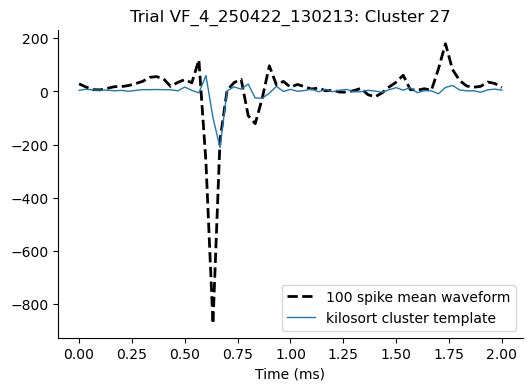

Saved plot for trial VF_4_250422_130213, cluster 29 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_29.png


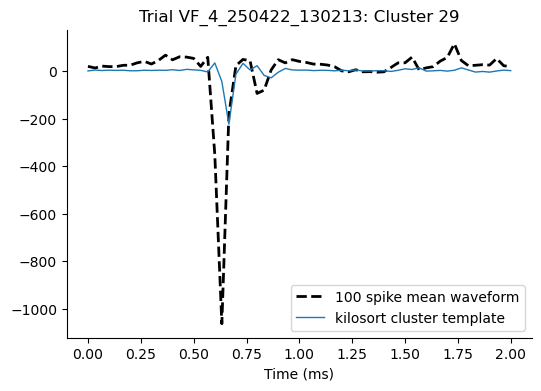

Saved plot for trial VF_4_250422_130213, cluster 30 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_30.png


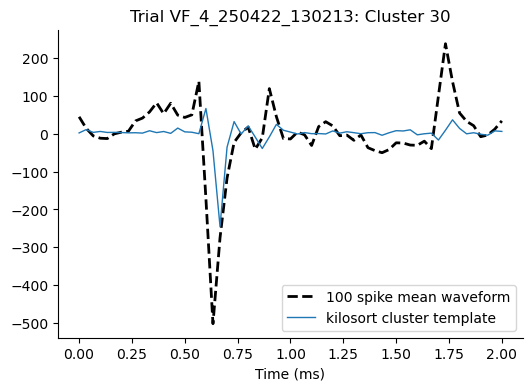

Saved plot for trial VF_4_250422_130213, cluster 31 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_31.png


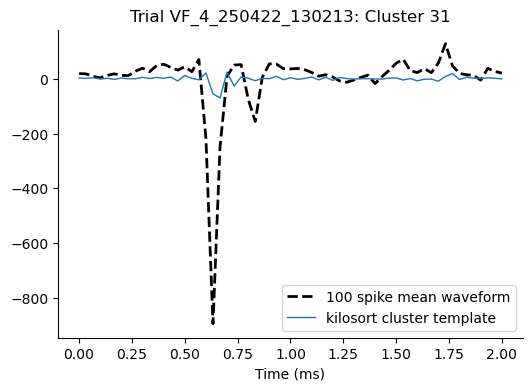

Saved plot for trial VF_4_250422_130213, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_4_250422_130213_cluster_33.png


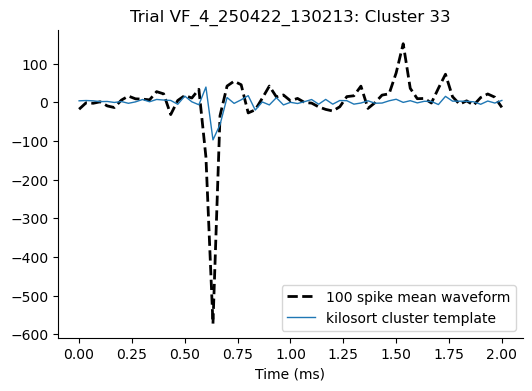

Plotting waveforms for trial VF_5_250422_130729: Good clusters found: [0, 2, 3, 4, 6, 7, 9, 11, 12, 14, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 34, 35, 36, 41, 43, 44, 45, 46, 47, 50, 53, 55, 57, 58, 59, 60, 61, 62]
Saved plot for trial VF_5_250422_130729, cluster 0 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_0.png


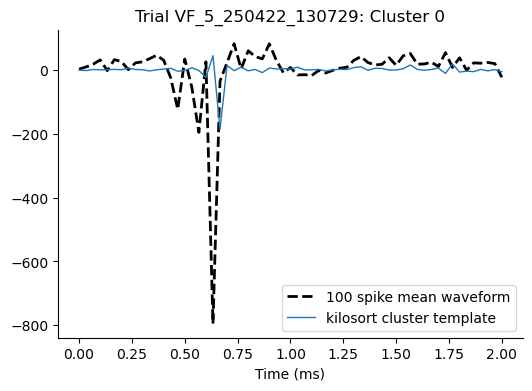

Saved plot for trial VF_5_250422_130729, cluster 2 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_2.png


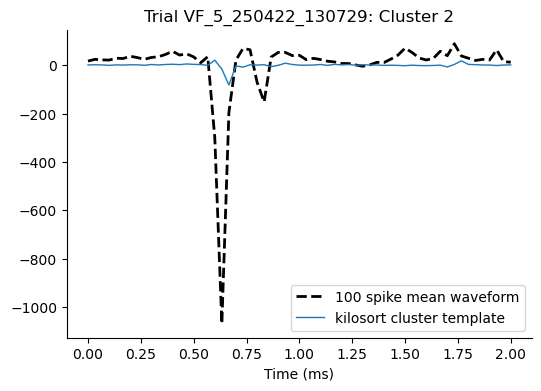

Saved plot for trial VF_5_250422_130729, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_3.png


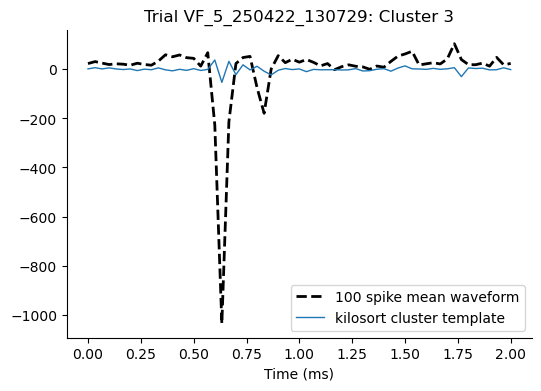

Saved plot for trial VF_5_250422_130729, cluster 4 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_4.png


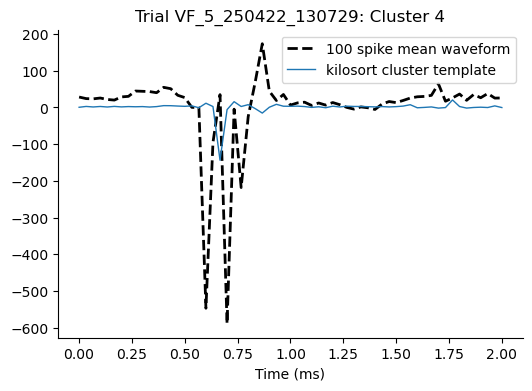

Saved plot for trial VF_5_250422_130729, cluster 6 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_6.png


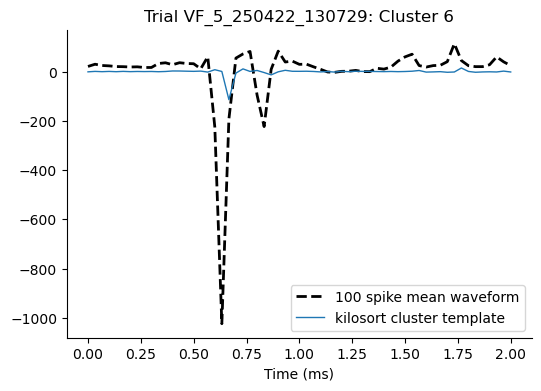

Saved plot for trial VF_5_250422_130729, cluster 7 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_7.png


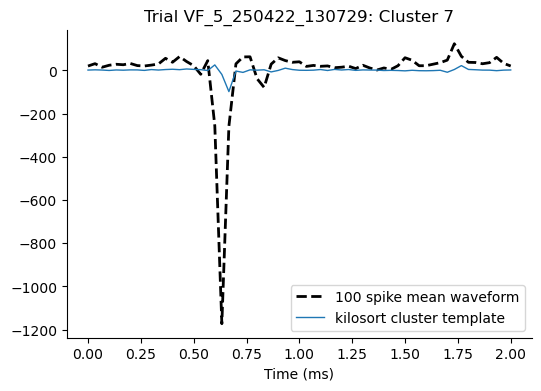

Saved plot for trial VF_5_250422_130729, cluster 9 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_9.png


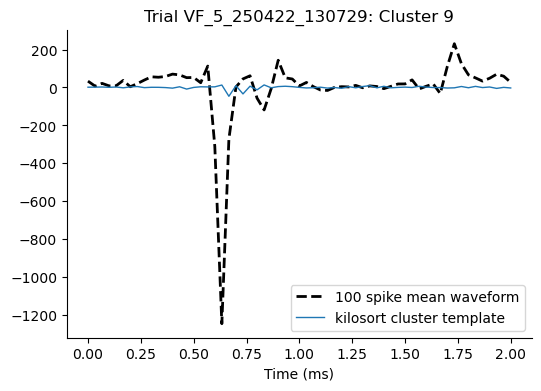

Saved plot for trial VF_5_250422_130729, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_11.png


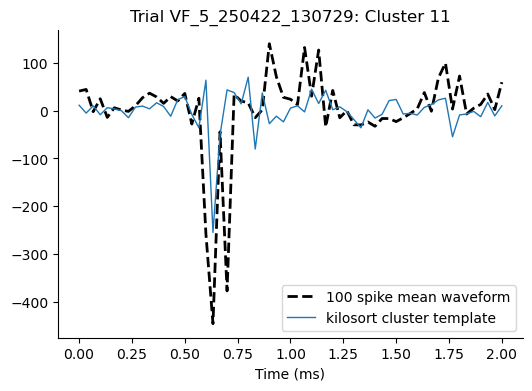

Saved plot for trial VF_5_250422_130729, cluster 12 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_12.png


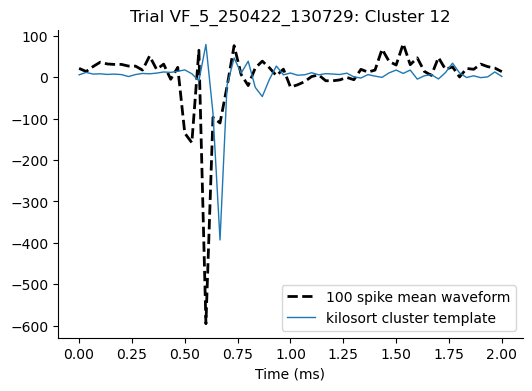

Saved plot for trial VF_5_250422_130729, cluster 14 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_14.png


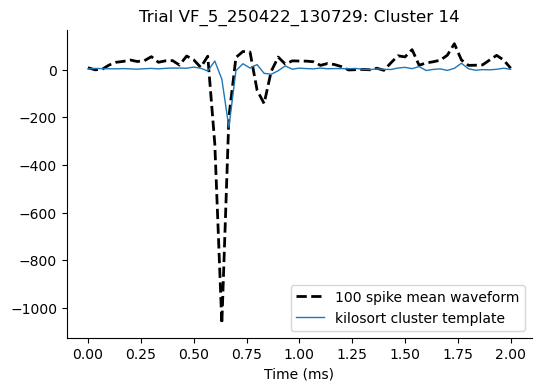

Saved plot for trial VF_5_250422_130729, cluster 17 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_17.png


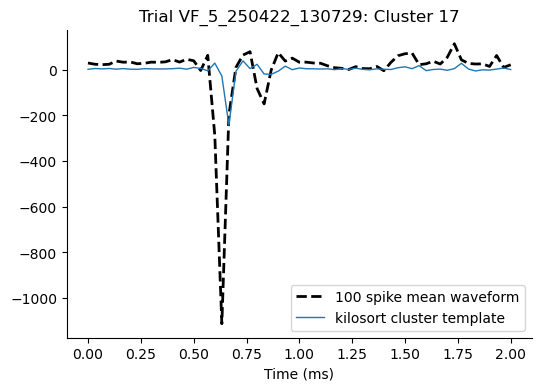

Saved plot for trial VF_5_250422_130729, cluster 18 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_18.png


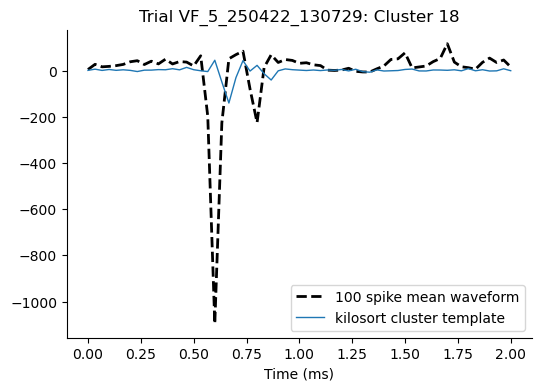

Saved plot for trial VF_5_250422_130729, cluster 19 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_19.png


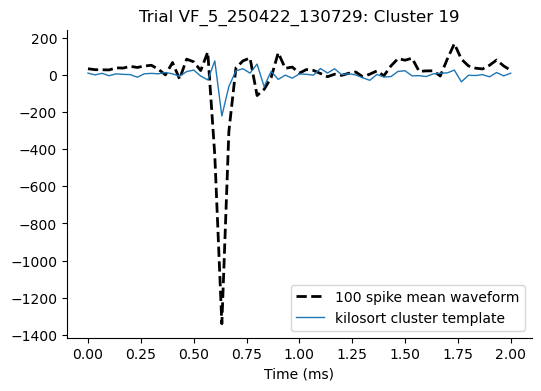

Saved plot for trial VF_5_250422_130729, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_20.png


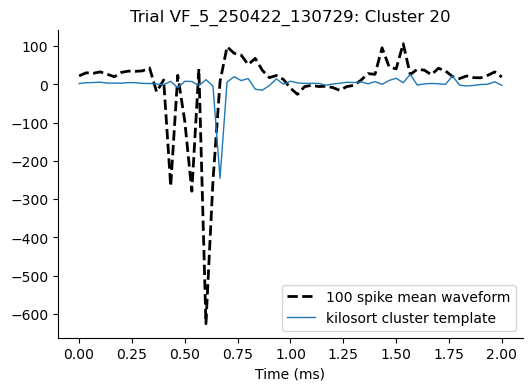

Saved plot for trial VF_5_250422_130729, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_21.png


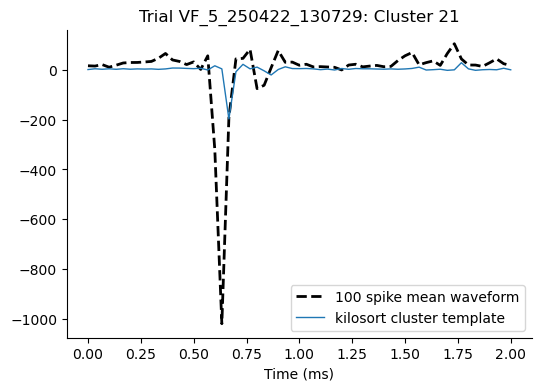

Saved plot for trial VF_5_250422_130729, cluster 22 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_22.png


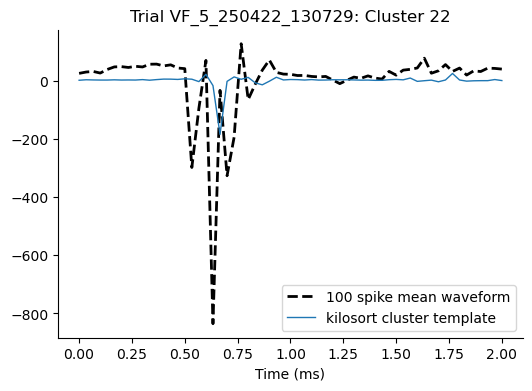

Saved plot for trial VF_5_250422_130729, cluster 23 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_23.png


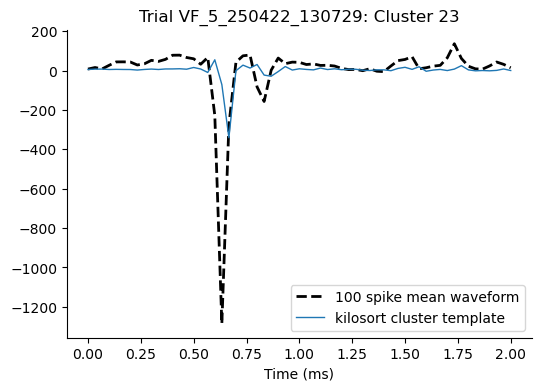

Saved plot for trial VF_5_250422_130729, cluster 24 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_24.png


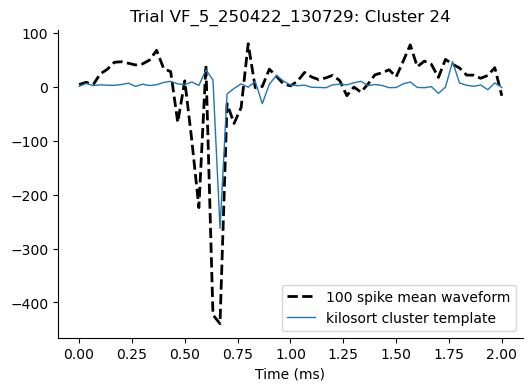

Saved plot for trial VF_5_250422_130729, cluster 25 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_25.png


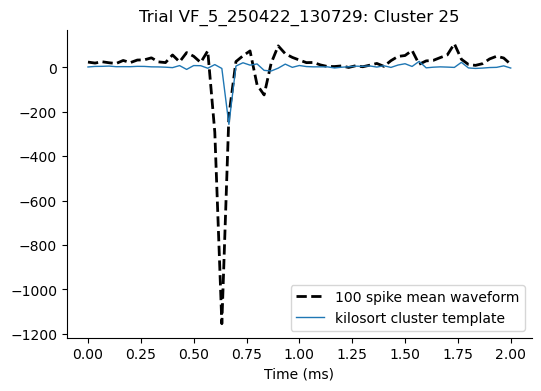

Saved plot for trial VF_5_250422_130729, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_26.png


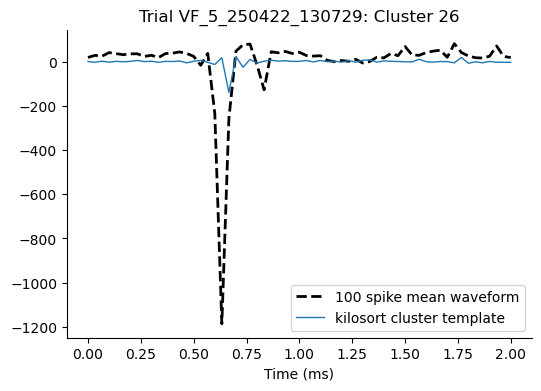

Saved plot for trial VF_5_250422_130729, cluster 34 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_34.png


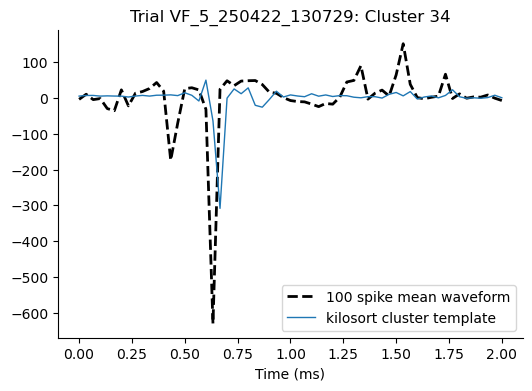

Saved plot for trial VF_5_250422_130729, cluster 35 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_35.png


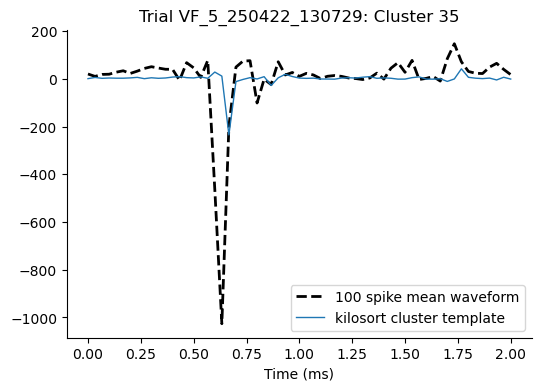

Saved plot for trial VF_5_250422_130729, cluster 36 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_36.png


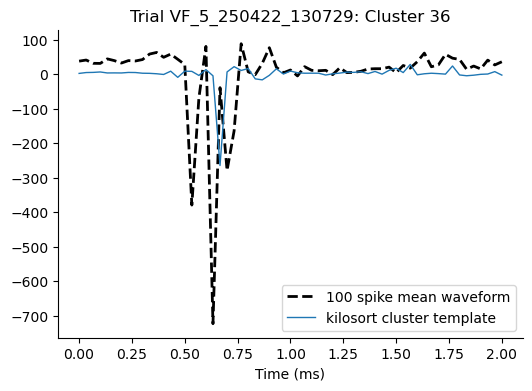

Saved plot for trial VF_5_250422_130729, cluster 41 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_41.png


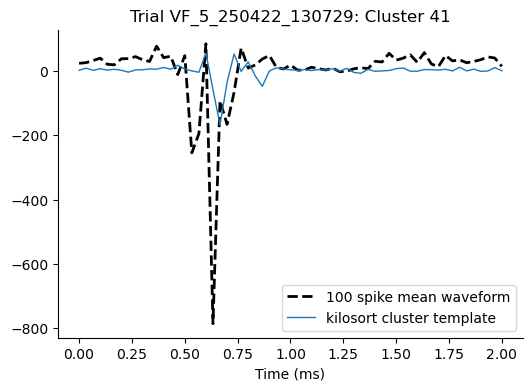

Saved plot for trial VF_5_250422_130729, cluster 43 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_43.png


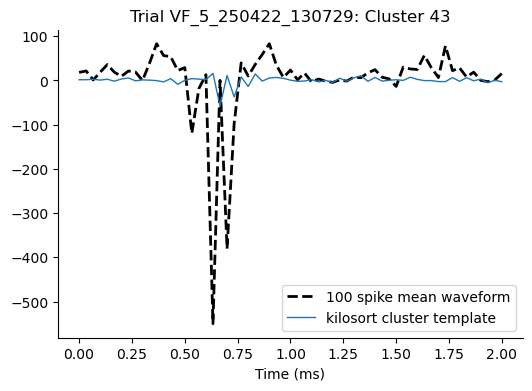

Saved plot for trial VF_5_250422_130729, cluster 44 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_44.png


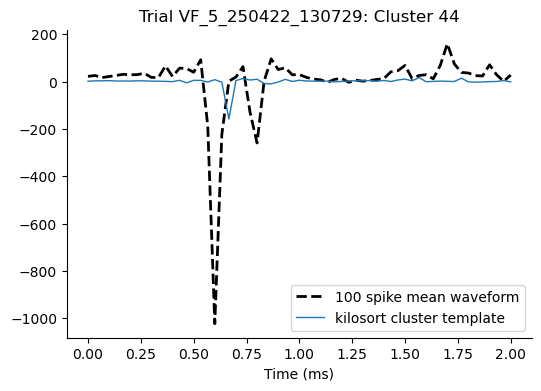

Saved plot for trial VF_5_250422_130729, cluster 45 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_45.png


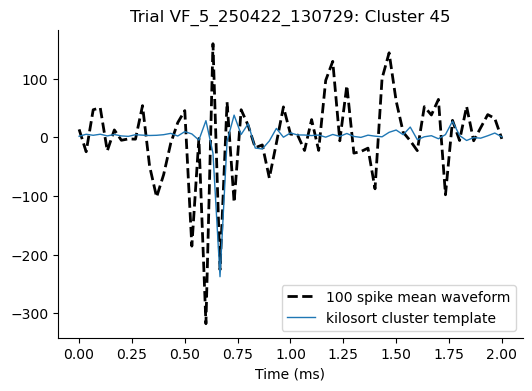

Saved plot for trial VF_5_250422_130729, cluster 46 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_46.png


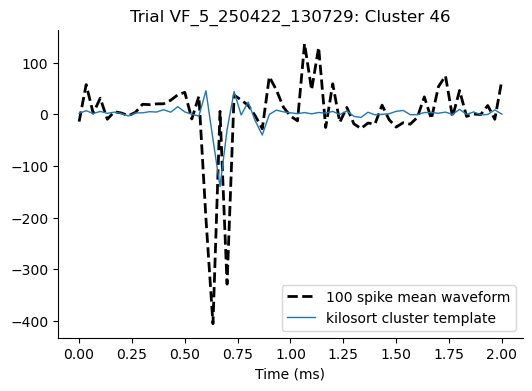

Saved plot for trial VF_5_250422_130729, cluster 47 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_47.png


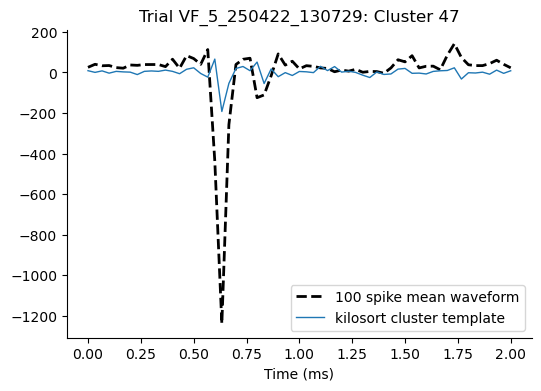

Saved plot for trial VF_5_250422_130729, cluster 50 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_50.png


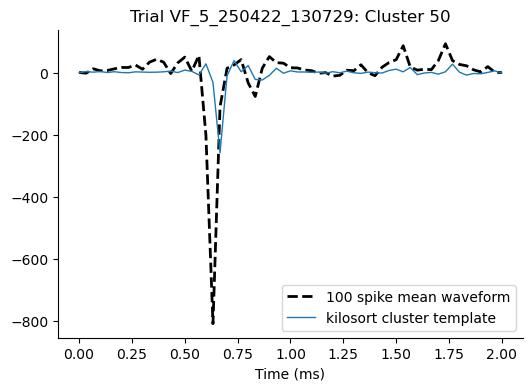

Saved plot for trial VF_5_250422_130729, cluster 53 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_53.png


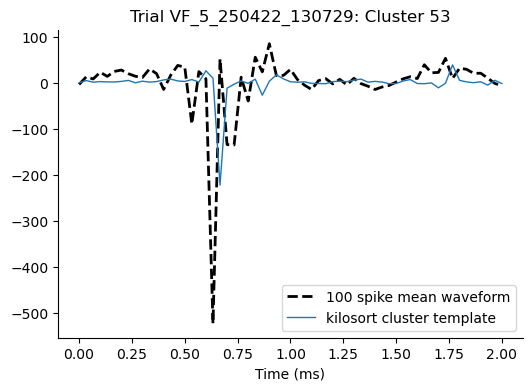

Saved plot for trial VF_5_250422_130729, cluster 55 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_55.png


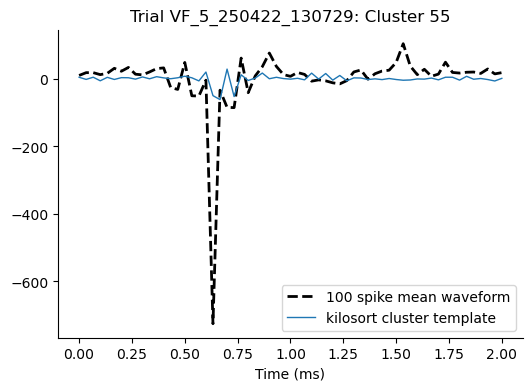

Saved plot for trial VF_5_250422_130729, cluster 57 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_57.png


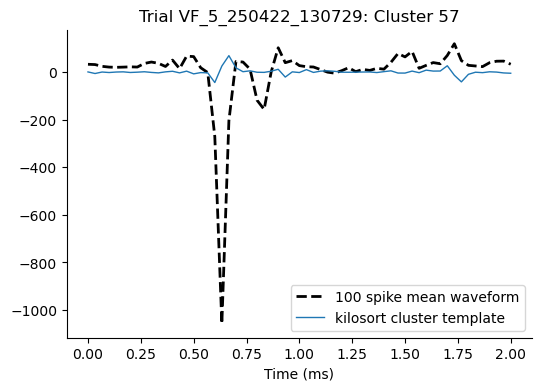

Saved plot for trial VF_5_250422_130729, cluster 58 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_58.png


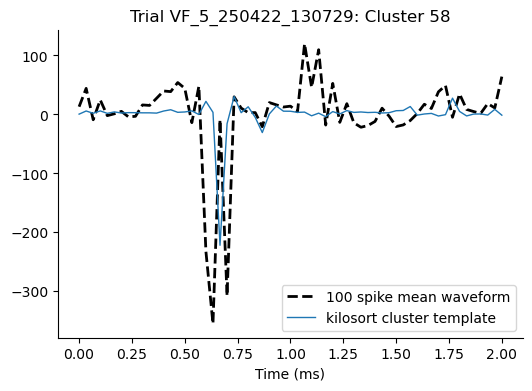

Saved plot for trial VF_5_250422_130729, cluster 59 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_59.png


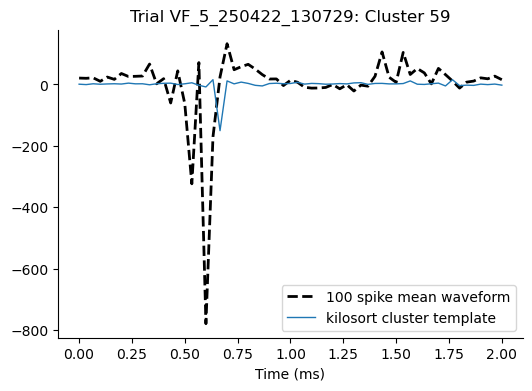

Saved plot for trial VF_5_250422_130729, cluster 60 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_60.png


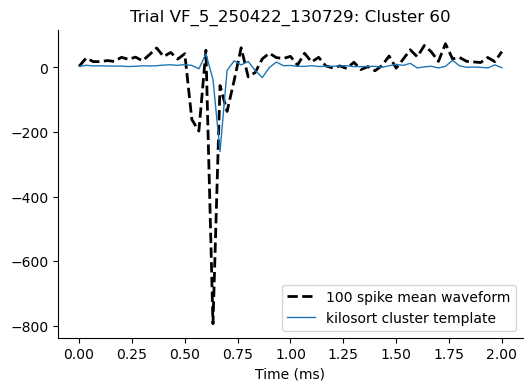

Saved plot for trial VF_5_250422_130729, cluster 61 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_61.png


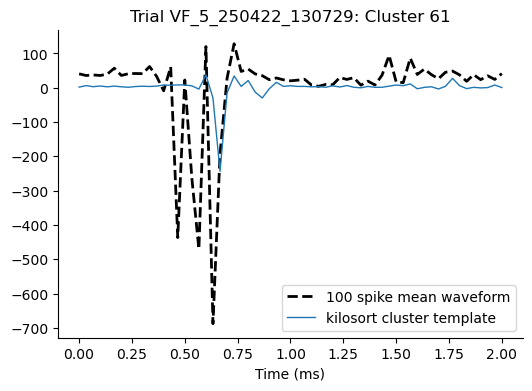

Saved plot for trial VF_5_250422_130729, cluster 62 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_5_250422_130729_cluster_62.png


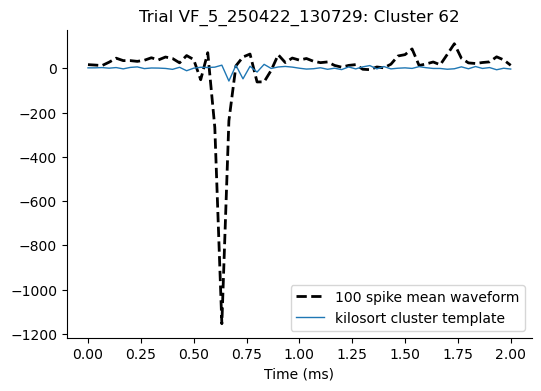

Plotting waveforms for trial VF_6_250422_131240: Good clusters found: [2, 3, 4, 5, 6, 8, 9, 11, 18, 19, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 34, 35, 37, 38, 39, 40, 41, 42, 43, 46, 47, 49, 50, 51, 53, 54, 55, 58, 60, 62, 63]
Saved plot for trial VF_6_250422_131240, cluster 2 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_2.png


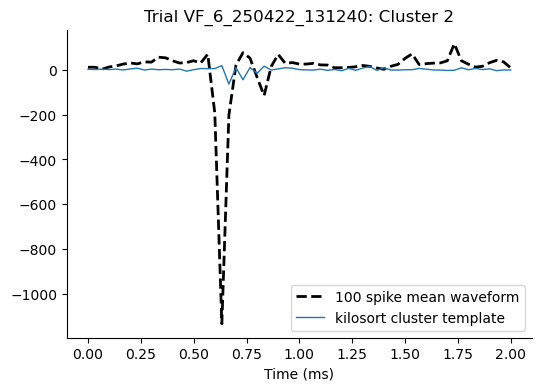

Saved plot for trial VF_6_250422_131240, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_3.png


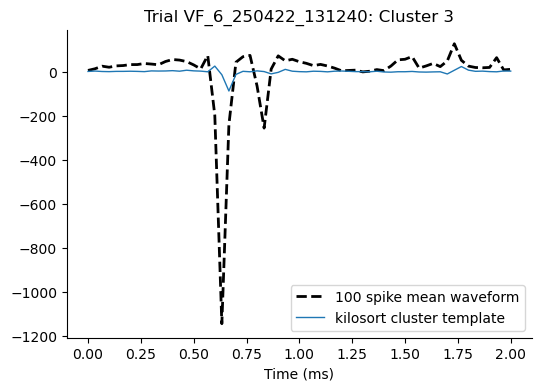

Saved plot for trial VF_6_250422_131240, cluster 4 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_4.png


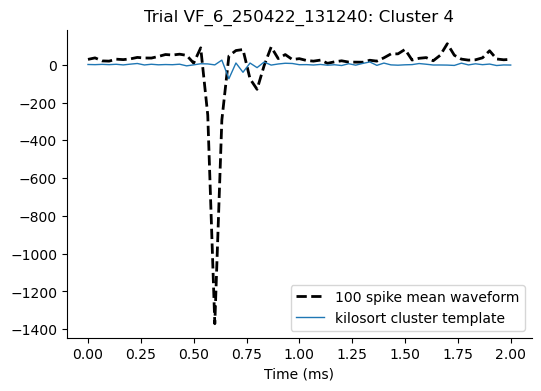

Saved plot for trial VF_6_250422_131240, cluster 5 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_5.png


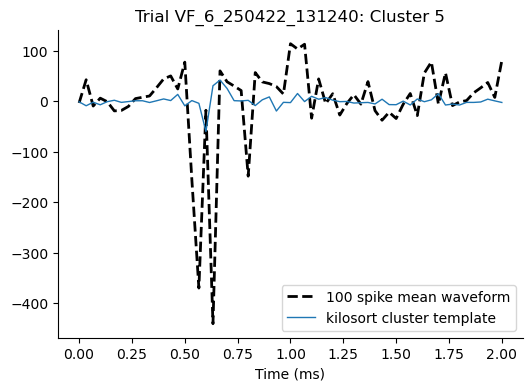

Saved plot for trial VF_6_250422_131240, cluster 6 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_6.png


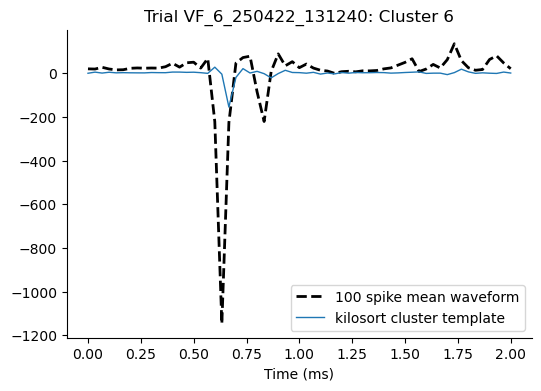

Saved plot for trial VF_6_250422_131240, cluster 8 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_8.png


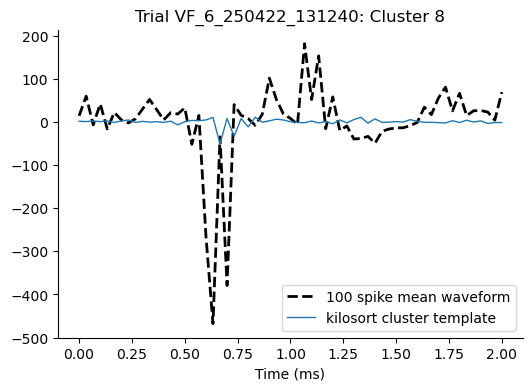

Saved plot for trial VF_6_250422_131240, cluster 9 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_9.png


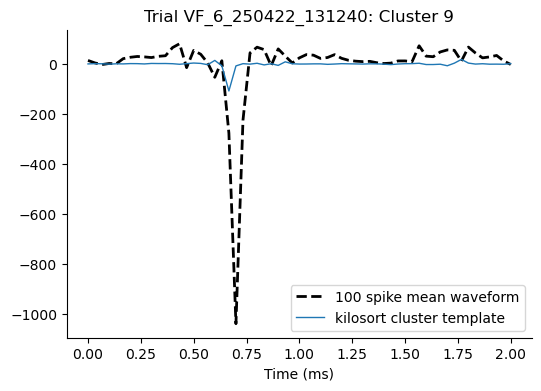

Saved plot for trial VF_6_250422_131240, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_11.png


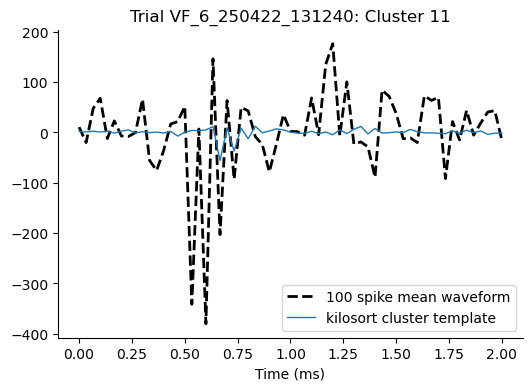

Saved plot for trial VF_6_250422_131240, cluster 18 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_18.png


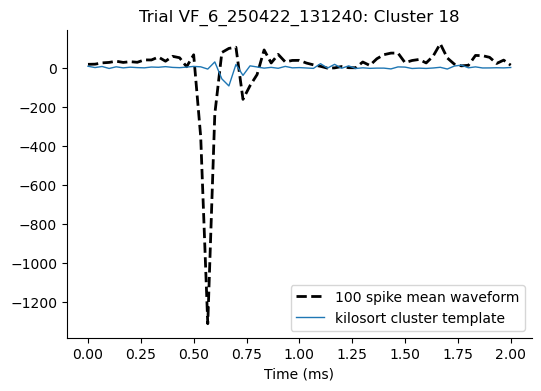

Saved plot for trial VF_6_250422_131240, cluster 19 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_19.png


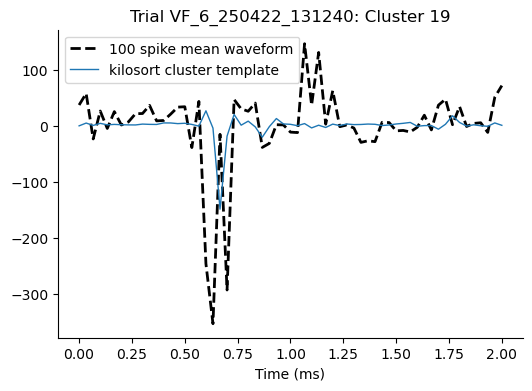

Saved plot for trial VF_6_250422_131240, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_21.png


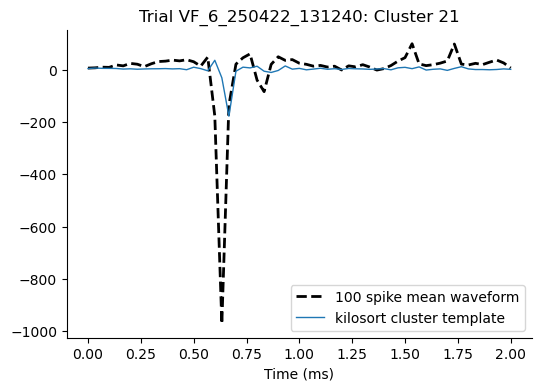

Saved plot for trial VF_6_250422_131240, cluster 22 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_22.png


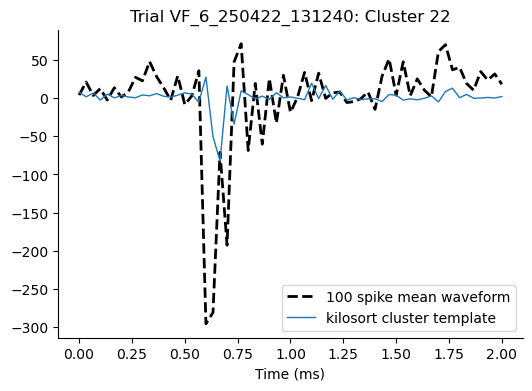

Saved plot for trial VF_6_250422_131240, cluster 23 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_23.png


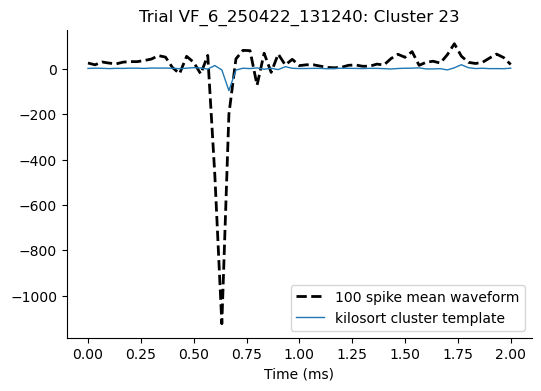

Saved plot for trial VF_6_250422_131240, cluster 24 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_24.png


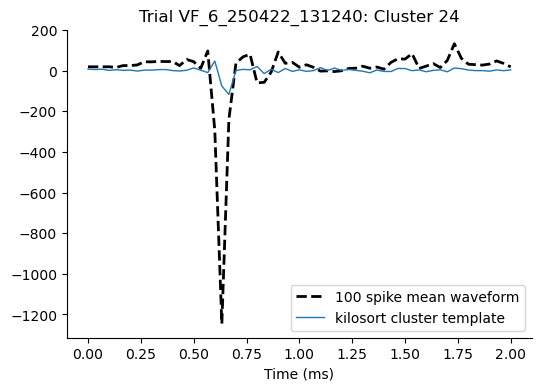

Saved plot for trial VF_6_250422_131240, cluster 25 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_25.png


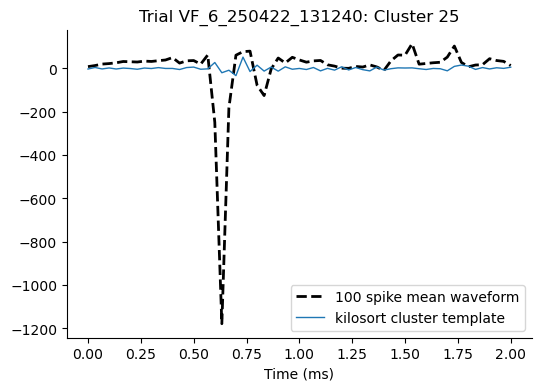

Saved plot for trial VF_6_250422_131240, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_26.png


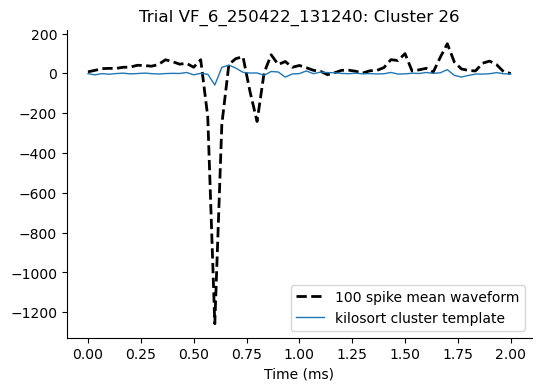

Saved plot for trial VF_6_250422_131240, cluster 27 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_27.png


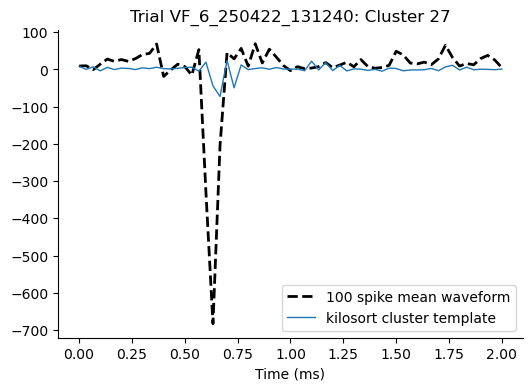

Saved plot for trial VF_6_250422_131240, cluster 28 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_28.png


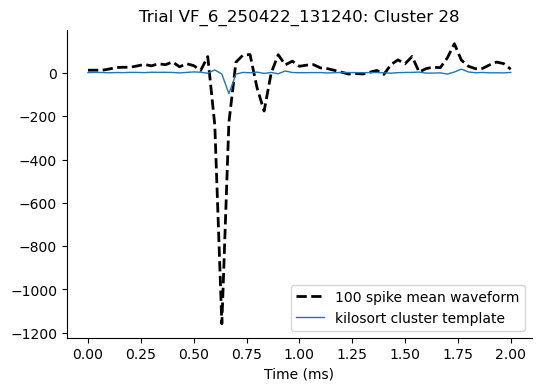

Saved plot for trial VF_6_250422_131240, cluster 30 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_30.png


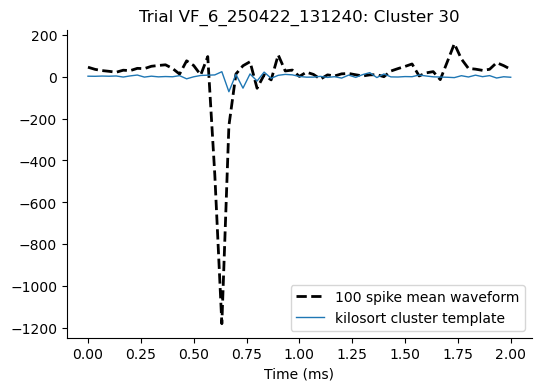

Saved plot for trial VF_6_250422_131240, cluster 31 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_31.png


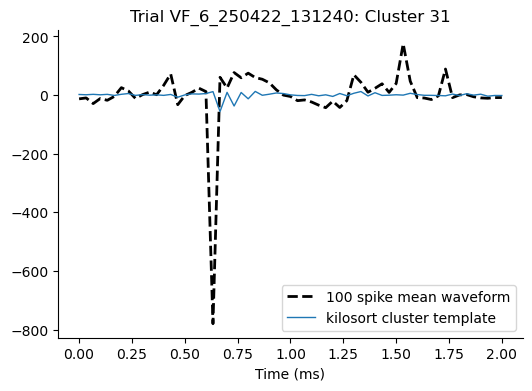

Saved plot for trial VF_6_250422_131240, cluster 34 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_34.png


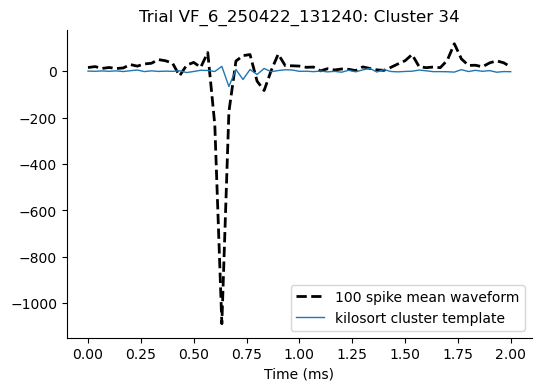

Saved plot for trial VF_6_250422_131240, cluster 35 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_35.png


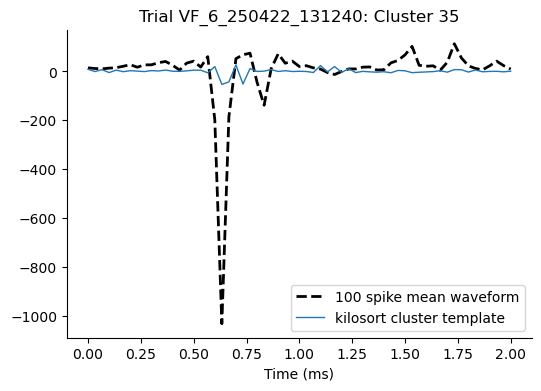

Saved plot for trial VF_6_250422_131240, cluster 37 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_37.png


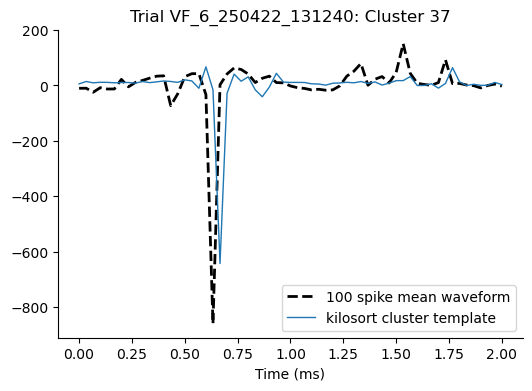

Saved plot for trial VF_6_250422_131240, cluster 38 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_38.png


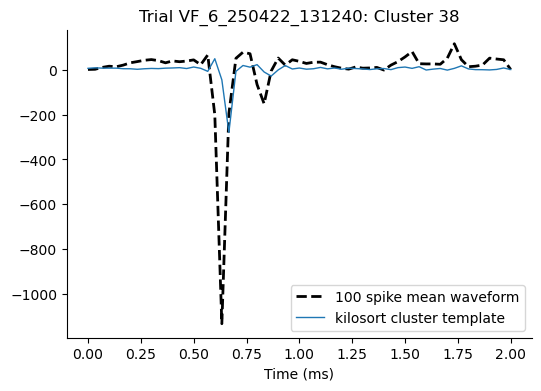

Saved plot for trial VF_6_250422_131240, cluster 39 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_39.png


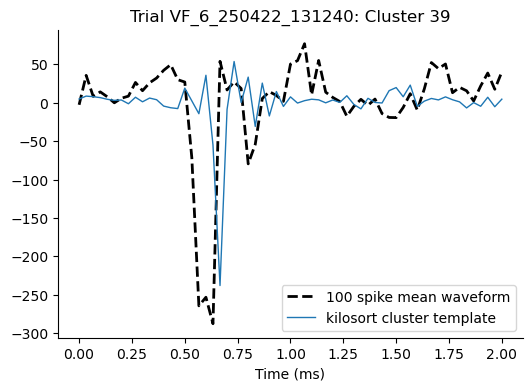

Saved plot for trial VF_6_250422_131240, cluster 40 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_40.png


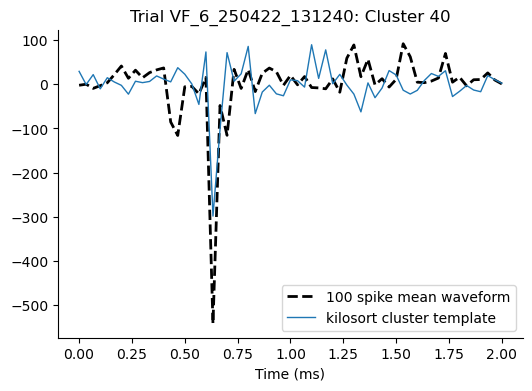

Saved plot for trial VF_6_250422_131240, cluster 41 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_41.png


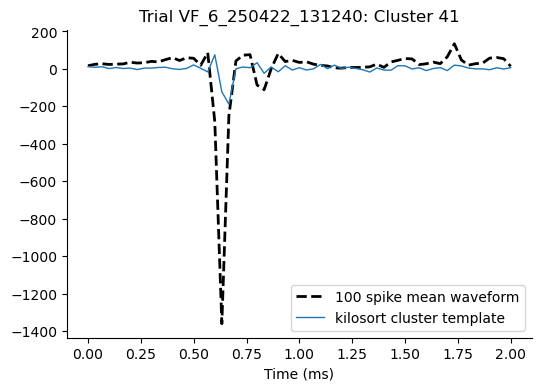

Saved plot for trial VF_6_250422_131240, cluster 42 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_42.png


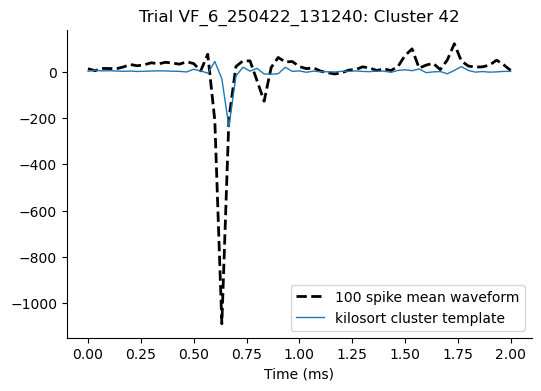

Saved plot for trial VF_6_250422_131240, cluster 43 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_43.png


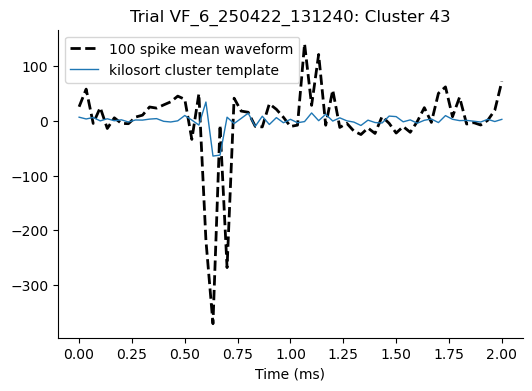

Saved plot for trial VF_6_250422_131240, cluster 46 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_46.png


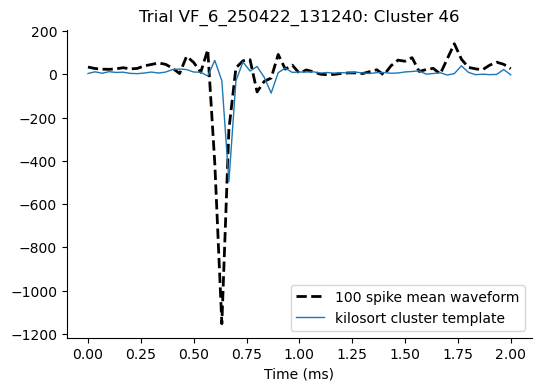

Saved plot for trial VF_6_250422_131240, cluster 47 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_47.png


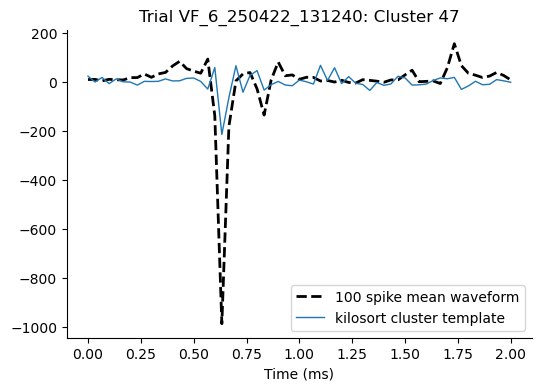

Saved plot for trial VF_6_250422_131240, cluster 49 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_49.png


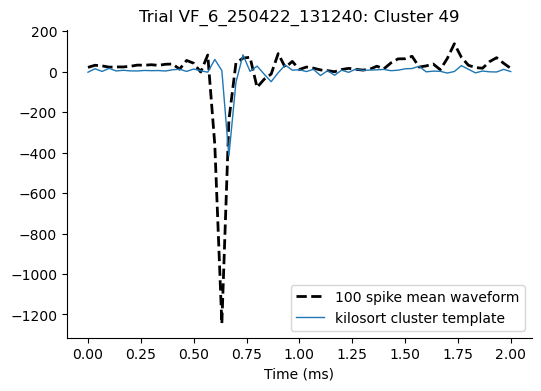

Saved plot for trial VF_6_250422_131240, cluster 50 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_50.png


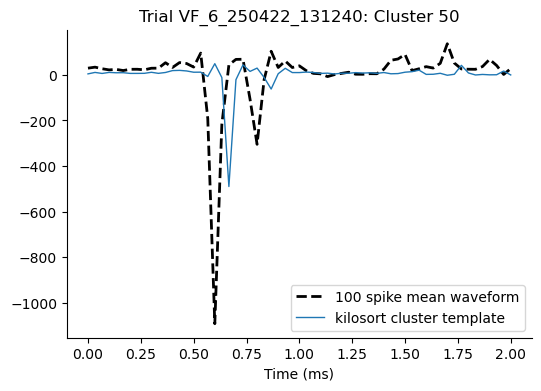

Saved plot for trial VF_6_250422_131240, cluster 51 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_51.png


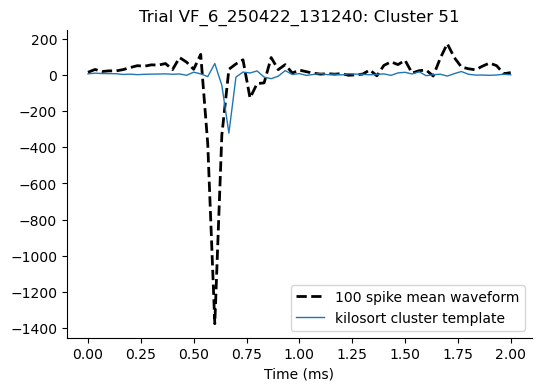

Saved plot for trial VF_6_250422_131240, cluster 53 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_53.png


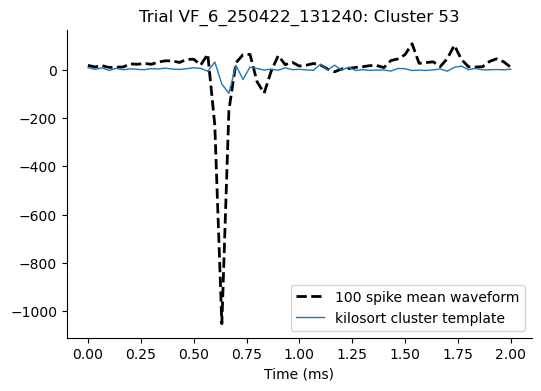

Saved plot for trial VF_6_250422_131240, cluster 54 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_54.png


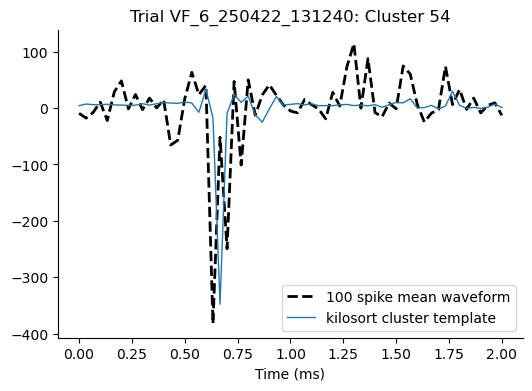

Saved plot for trial VF_6_250422_131240, cluster 55 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_55.png


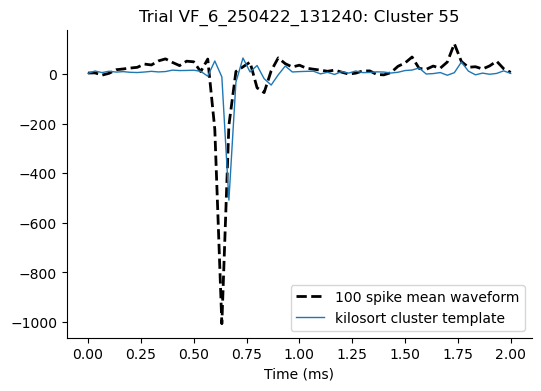

Saved plot for trial VF_6_250422_131240, cluster 58 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_58.png


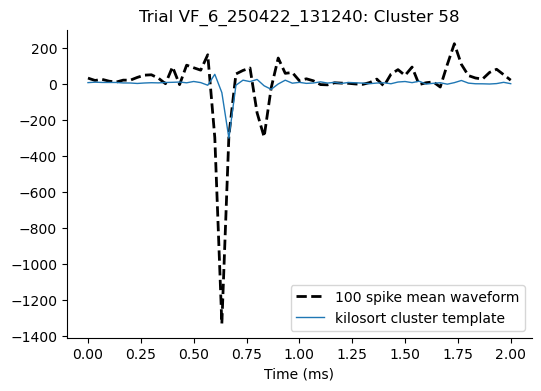

Saved plot for trial VF_6_250422_131240, cluster 60 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_60.png


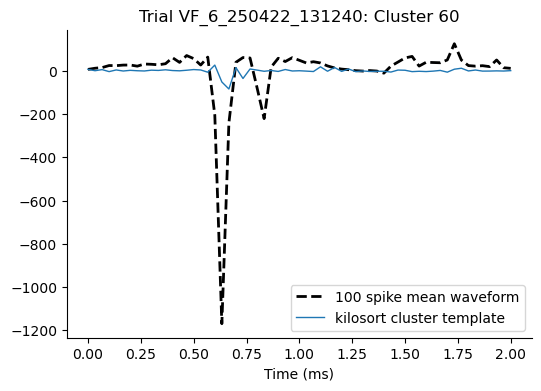

Saved plot for trial VF_6_250422_131240, cluster 62 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_62.png


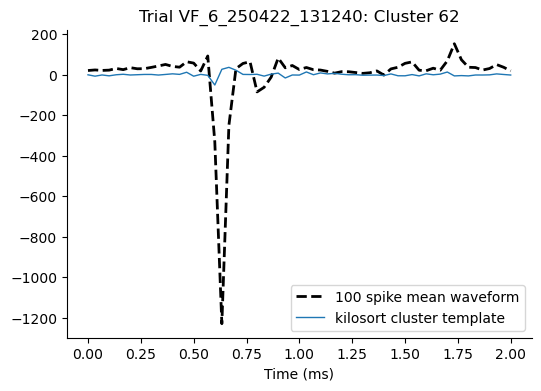

Saved plot for trial VF_6_250422_131240, cluster 63 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_6_250422_131240_cluster_63.png


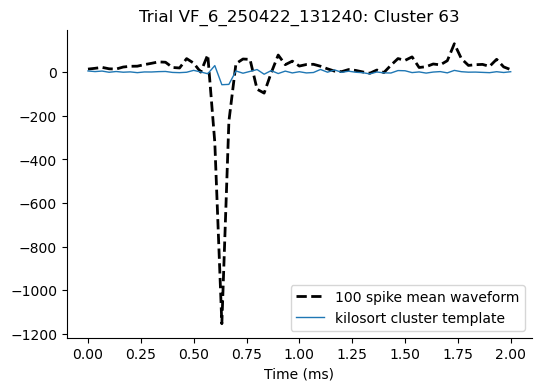

Plotting waveforms for trial VF_7_250422_131739: Good clusters found: [1, 2, 3, 9, 12, 13, 16, 17, 19, 20, 23, 24, 26, 30, 36, 38, 39, 44, 46, 47]
Saved plot for trial VF_7_250422_131739, cluster 1 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_1.png


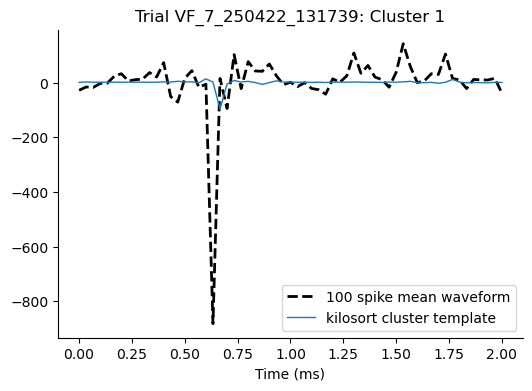

Saved plot for trial VF_7_250422_131739, cluster 2 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_2.png


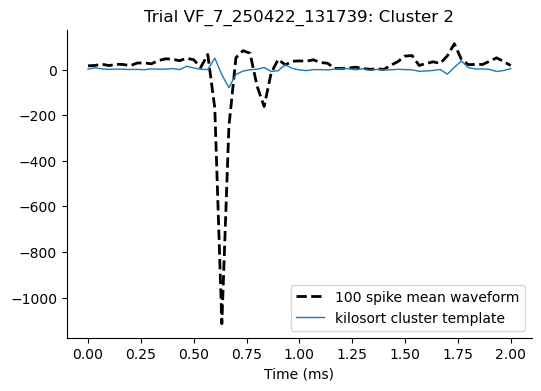

Saved plot for trial VF_7_250422_131739, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_3.png


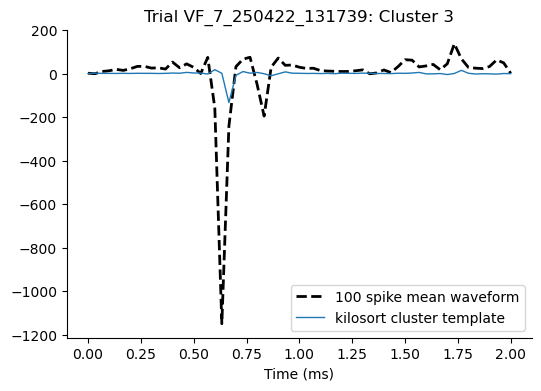

Saved plot for trial VF_7_250422_131739, cluster 9 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_9.png


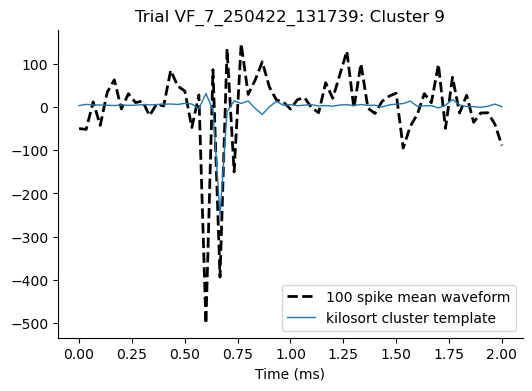

Saved plot for trial VF_7_250422_131739, cluster 12 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_12.png


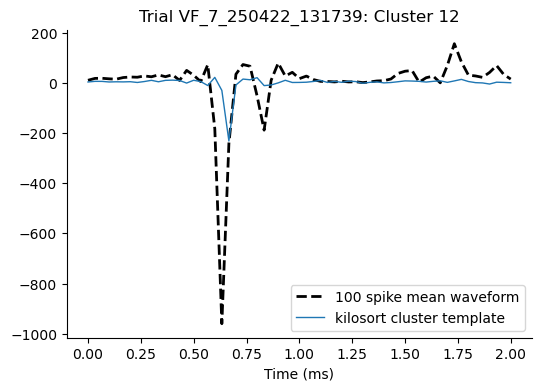

Saved plot for trial VF_7_250422_131739, cluster 13 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_13.png


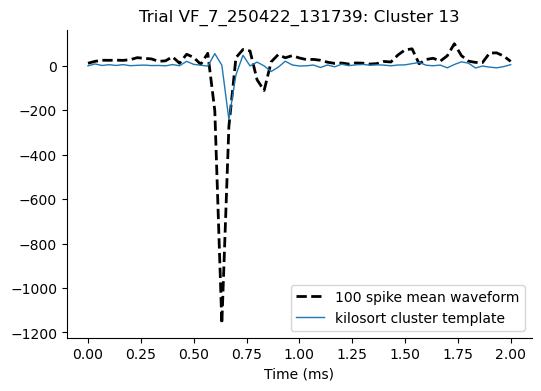

Saved plot for trial VF_7_250422_131739, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_16.png


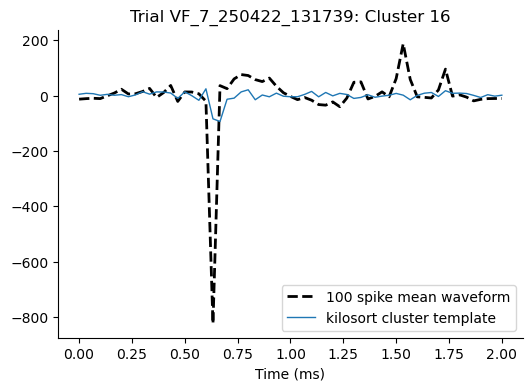

Saved plot for trial VF_7_250422_131739, cluster 17 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_17.png


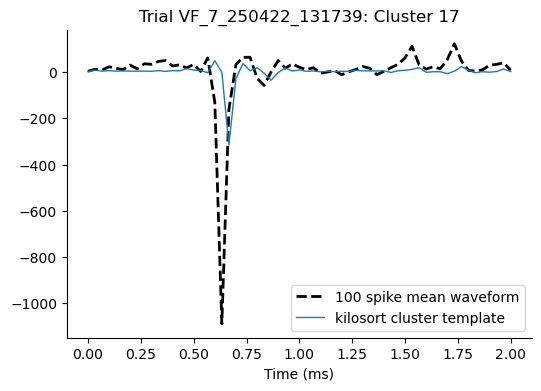

Saved plot for trial VF_7_250422_131739, cluster 19 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_19.png


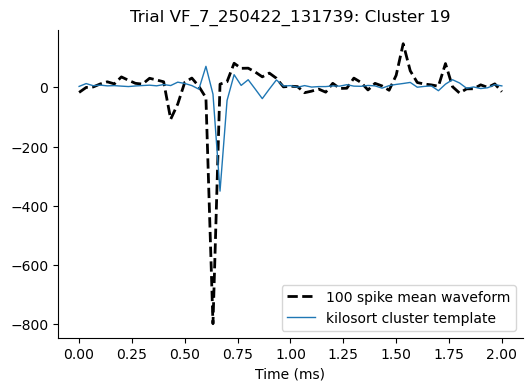

Saved plot for trial VF_7_250422_131739, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_20.png


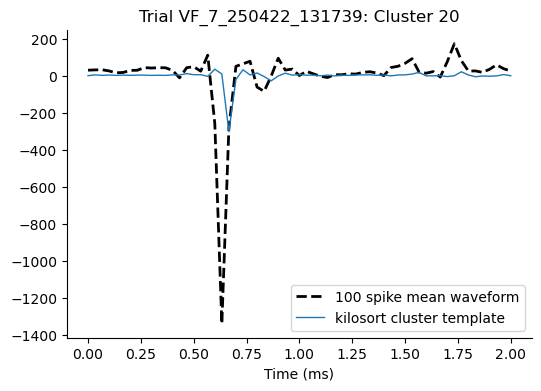

Saved plot for trial VF_7_250422_131739, cluster 23 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_23.png


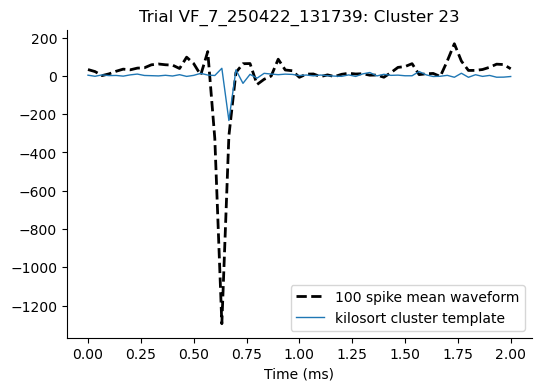

Saved plot for trial VF_7_250422_131739, cluster 24 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_24.png


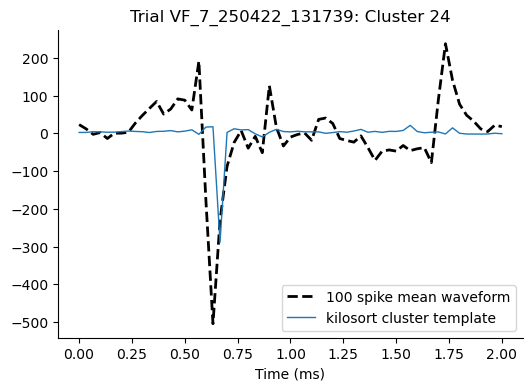

Saved plot for trial VF_7_250422_131739, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_26.png


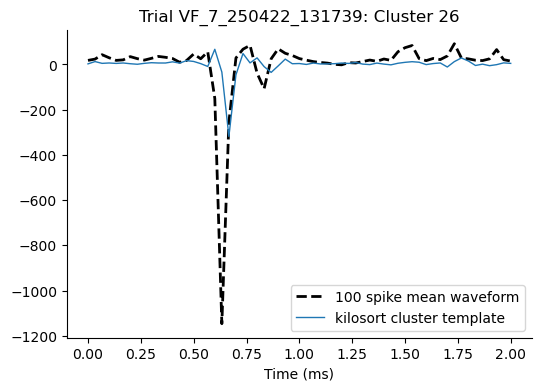

Saved plot for trial VF_7_250422_131739, cluster 30 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_30.png


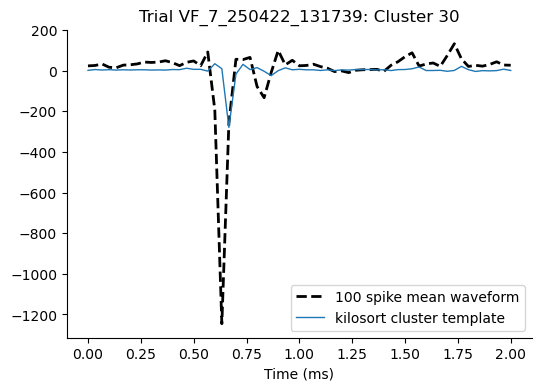

Saved plot for trial VF_7_250422_131739, cluster 36 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_36.png


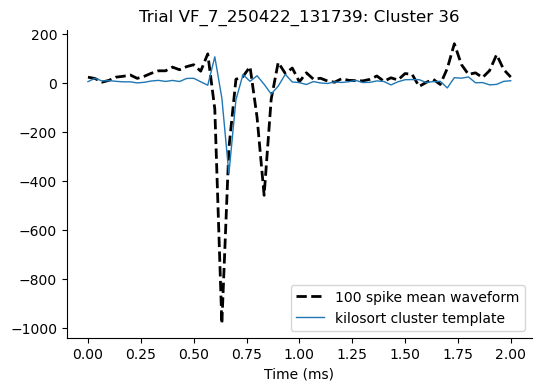

Saved plot for trial VF_7_250422_131739, cluster 38 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_38.png


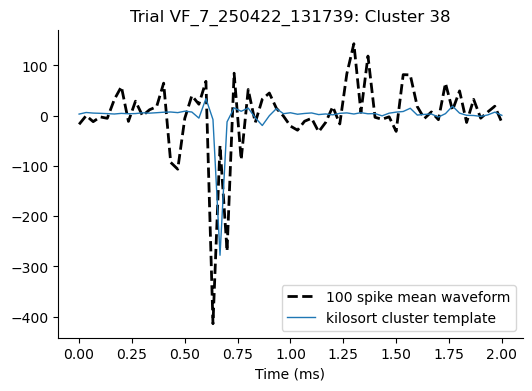

Saved plot for trial VF_7_250422_131739, cluster 39 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_39.png


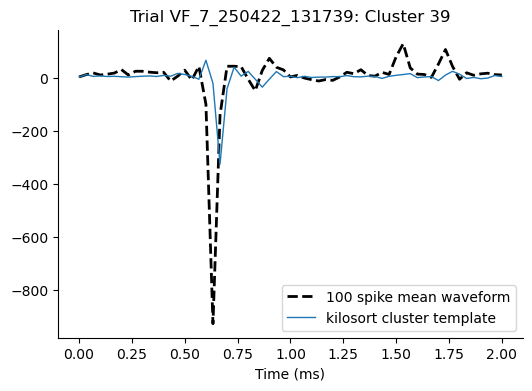

Saved plot for trial VF_7_250422_131739, cluster 44 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_44.png


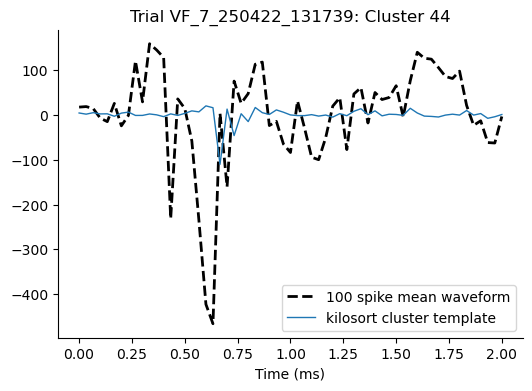

Saved plot for trial VF_7_250422_131739, cluster 46 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_46.png


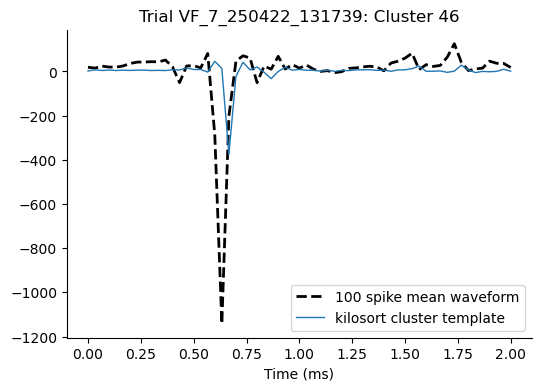

Saved plot for trial VF_7_250422_131739, cluster 47 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_7_250422_131739_cluster_47.png


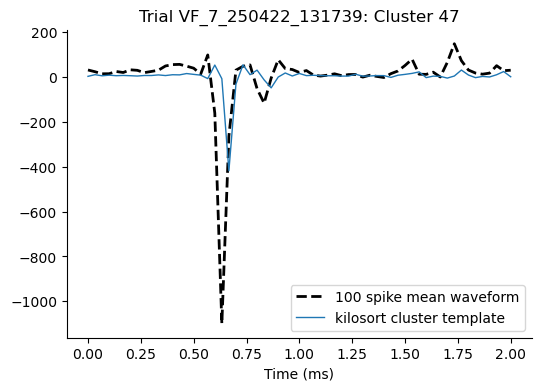

Plotting waveforms for trial VF_8_250422_132231: Good clusters found: [1, 2, 3, 5, 6, 9, 13, 14, 15, 16, 18, 20, 21, 22, 25, 26, 28, 29, 32, 33, 35, 36, 37, 39, 40, 41, 46, 48, 49, 52, 54, 59]
Saved plot for trial VF_8_250422_132231, cluster 1 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_1.png


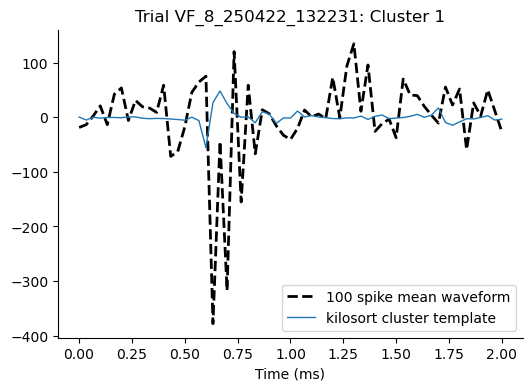

Saved plot for trial VF_8_250422_132231, cluster 2 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_2.png


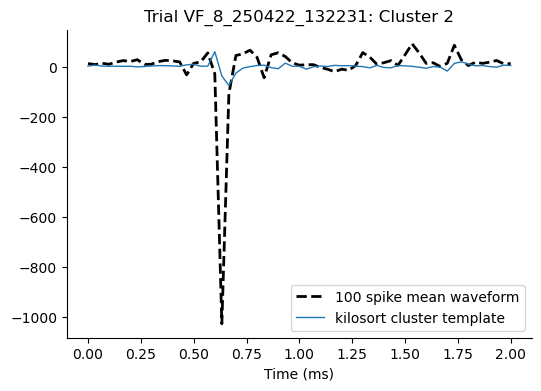

Saved plot for trial VF_8_250422_132231, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_3.png


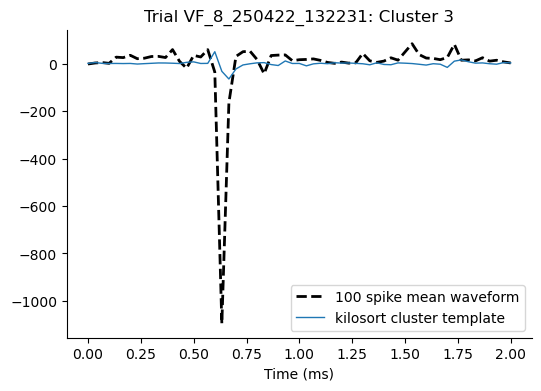

Saved plot for trial VF_8_250422_132231, cluster 5 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_5.png


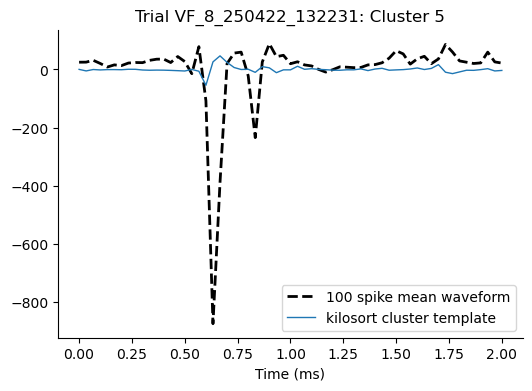

Saved plot for trial VF_8_250422_132231, cluster 6 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_6.png


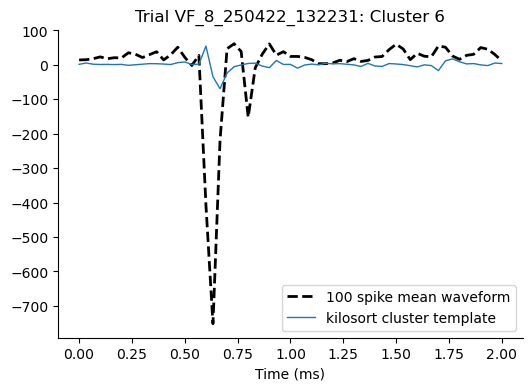

Saved plot for trial VF_8_250422_132231, cluster 9 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_9.png


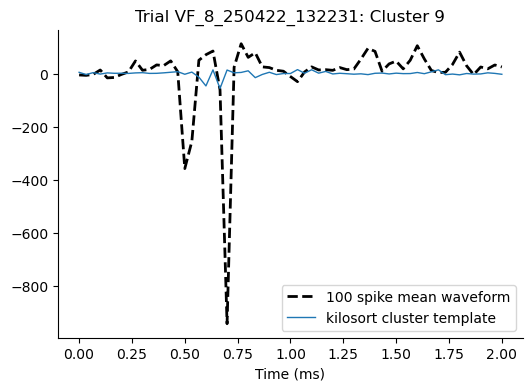

Saved plot for trial VF_8_250422_132231, cluster 13 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_13.png


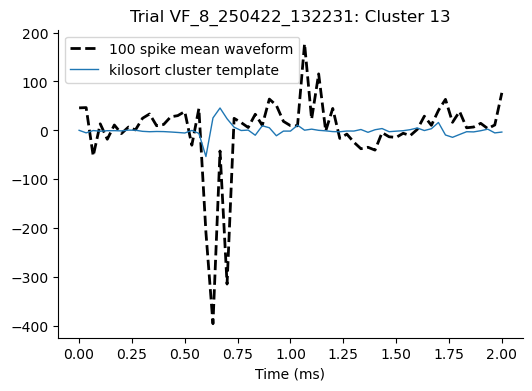

Saved plot for trial VF_8_250422_132231, cluster 14 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_14.png


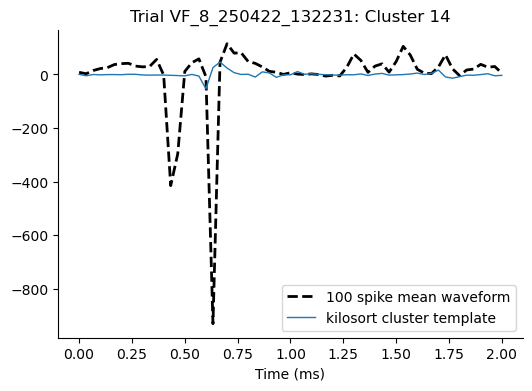

Saved plot for trial VF_8_250422_132231, cluster 15 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_15.png


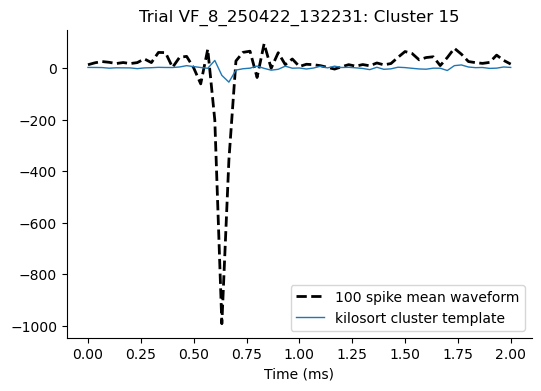

Saved plot for trial VF_8_250422_132231, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_16.png


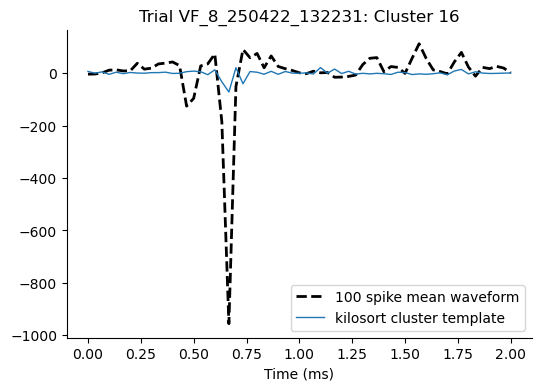

Saved plot for trial VF_8_250422_132231, cluster 18 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_18.png


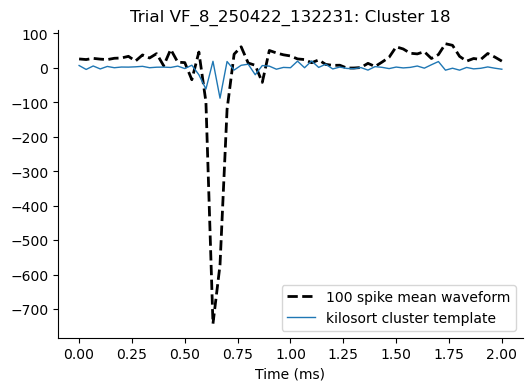

Saved plot for trial VF_8_250422_132231, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_20.png


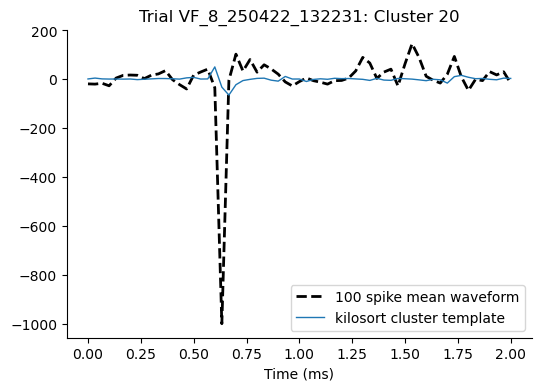

Saved plot for trial VF_8_250422_132231, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_21.png


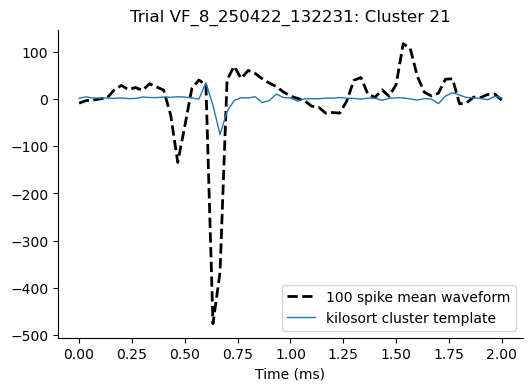

Saved plot for trial VF_8_250422_132231, cluster 22 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_22.png


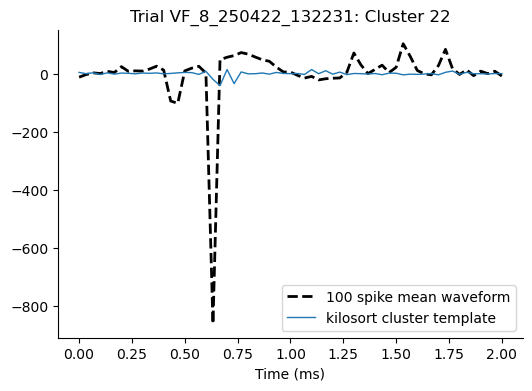

Saved plot for trial VF_8_250422_132231, cluster 25 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_25.png


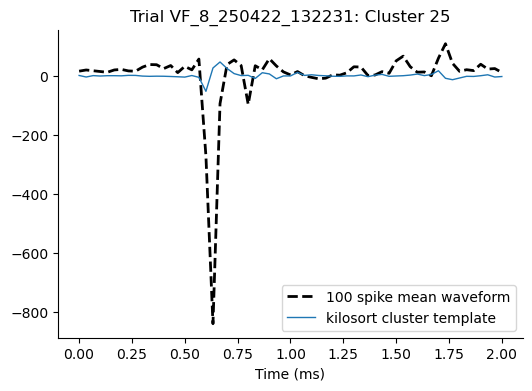

Saved plot for trial VF_8_250422_132231, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_26.png


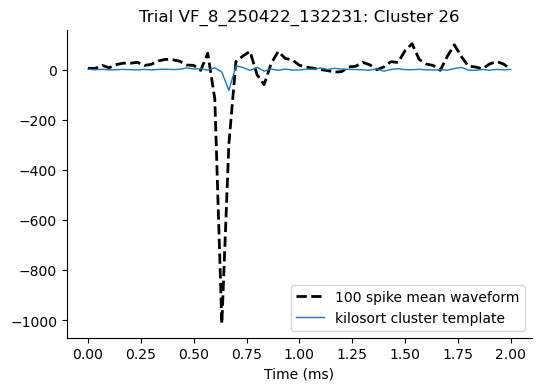

Saved plot for trial VF_8_250422_132231, cluster 28 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_28.png


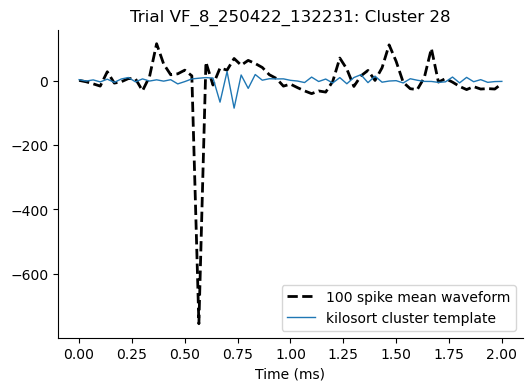

Saved plot for trial VF_8_250422_132231, cluster 29 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_29.png


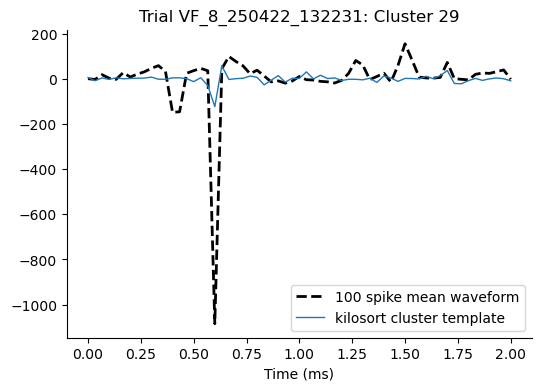

Saved plot for trial VF_8_250422_132231, cluster 32 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_32.png


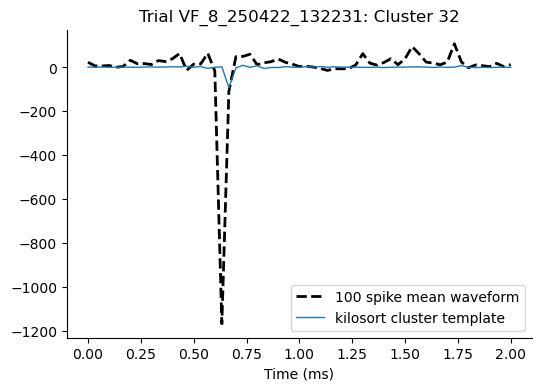

Saved plot for trial VF_8_250422_132231, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_33.png


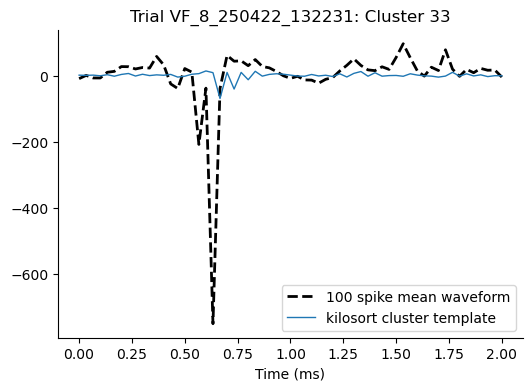

Saved plot for trial VF_8_250422_132231, cluster 35 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_35.png


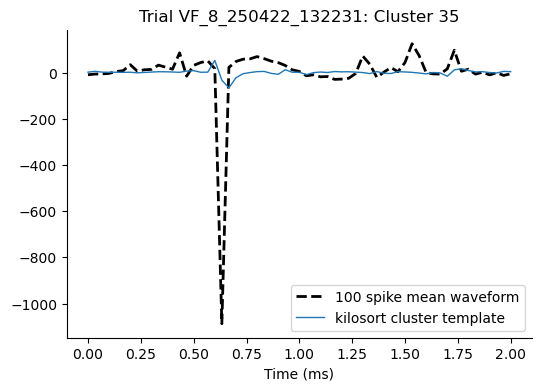

Saved plot for trial VF_8_250422_132231, cluster 36 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_36.png


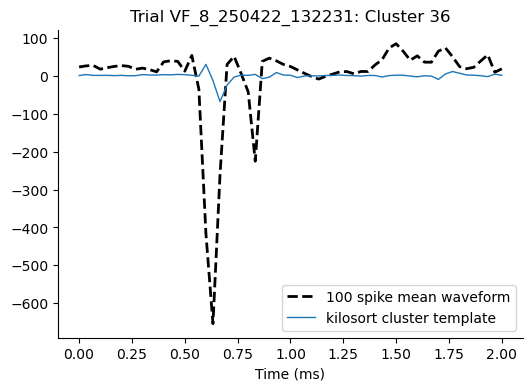

Saved plot for trial VF_8_250422_132231, cluster 37 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_37.png


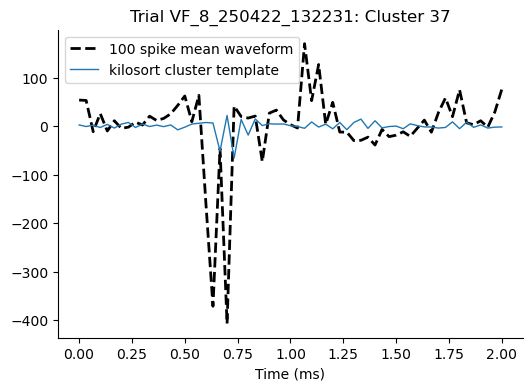

Saved plot for trial VF_8_250422_132231, cluster 39 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_39.png


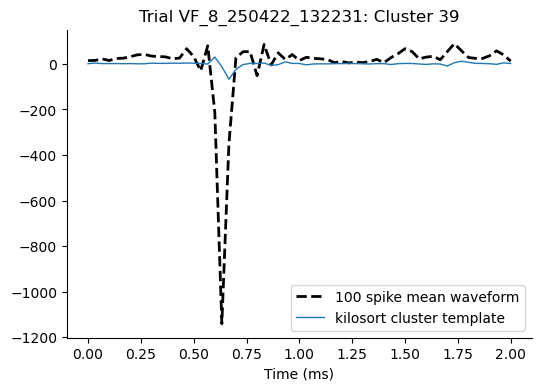

Saved plot for trial VF_8_250422_132231, cluster 40 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_40.png


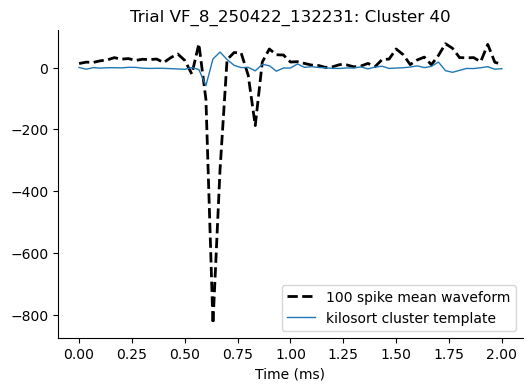

Saved plot for trial VF_8_250422_132231, cluster 41 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_41.png


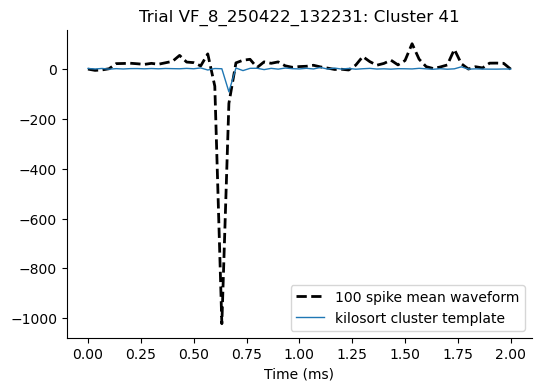

Saved plot for trial VF_8_250422_132231, cluster 46 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_46.png


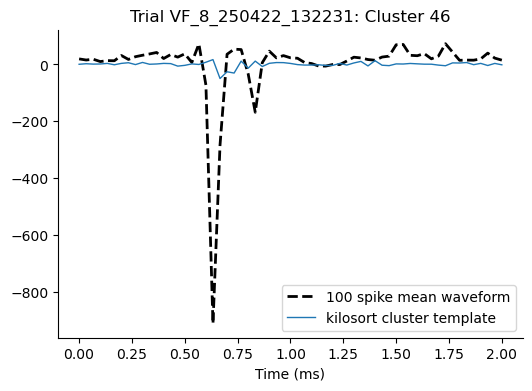

Saved plot for trial VF_8_250422_132231, cluster 48 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_48.png


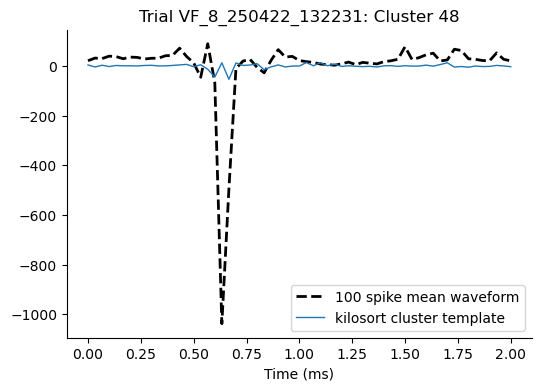

Saved plot for trial VF_8_250422_132231, cluster 49 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_49.png


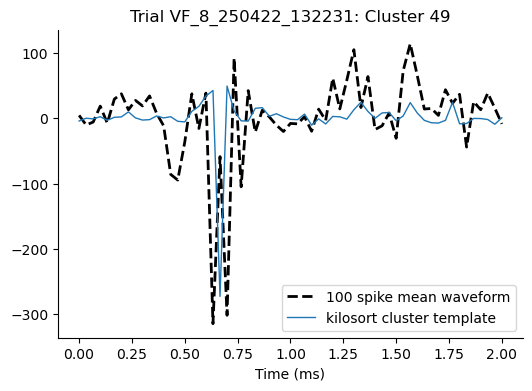

Saved plot for trial VF_8_250422_132231, cluster 52 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_52.png


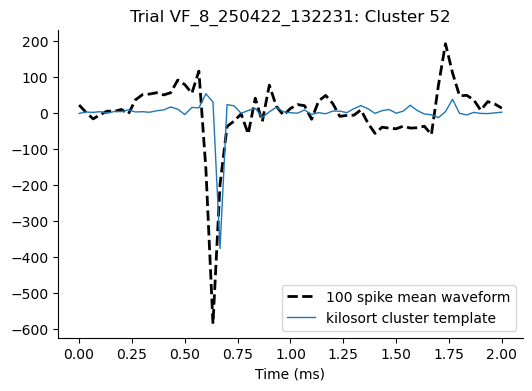

Saved plot for trial VF_8_250422_132231, cluster 54 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_54.png


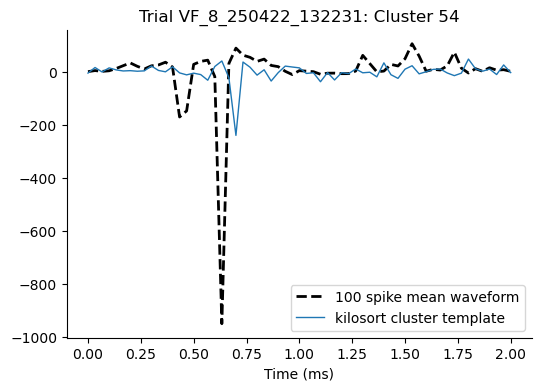

Saved plot for trial VF_8_250422_132231, cluster 59 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_8_250422_132231_cluster_59.png


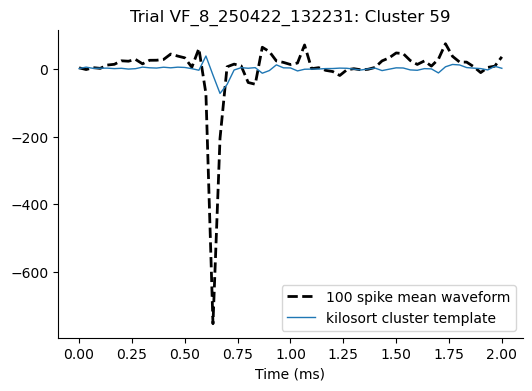

Plotting waveforms for trial VF_9_250422_132717: Good clusters found: [0, 1, 3, 4, 5, 7, 10, 13, 15, 17, 20, 21, 22, 25, 27, 29, 30, 31, 33, 34, 36, 39, 40, 42, 43, 45, 47, 49, 52]
Saved plot for trial VF_9_250422_132717, cluster 0 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_0.png


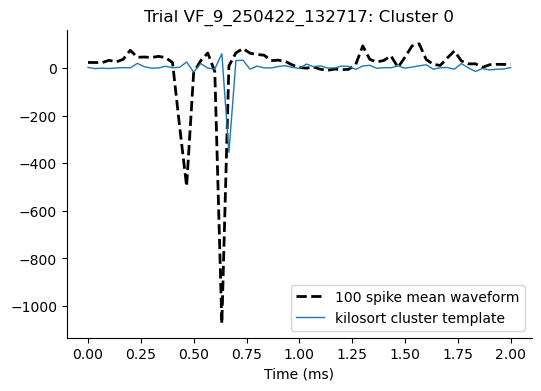

Saved plot for trial VF_9_250422_132717, cluster 1 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_1.png


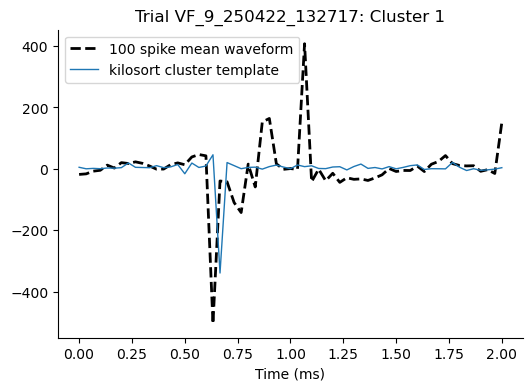

Saved plot for trial VF_9_250422_132717, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_3.png


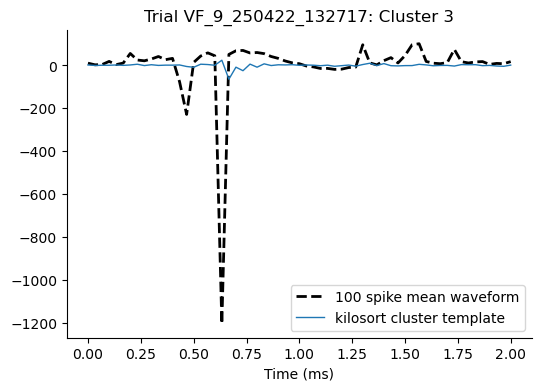

Saved plot for trial VF_9_250422_132717, cluster 4 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_4.png


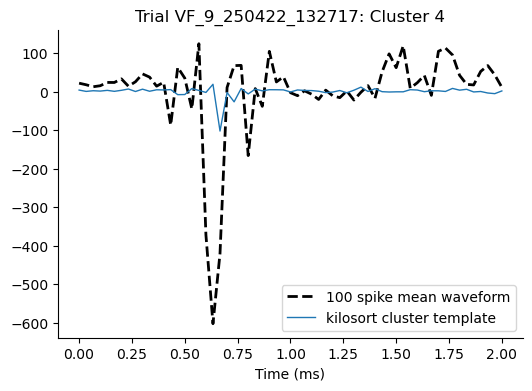

Saved plot for trial VF_9_250422_132717, cluster 5 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_5.png


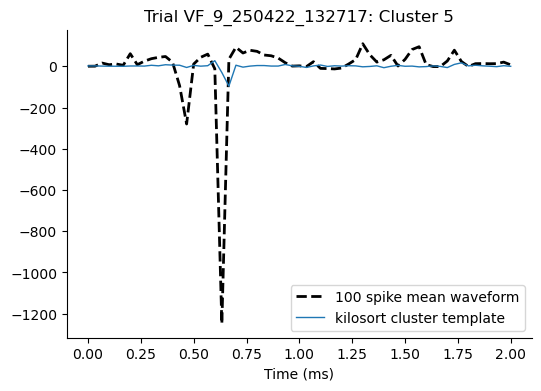

Saved plot for trial VF_9_250422_132717, cluster 7 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_7.png


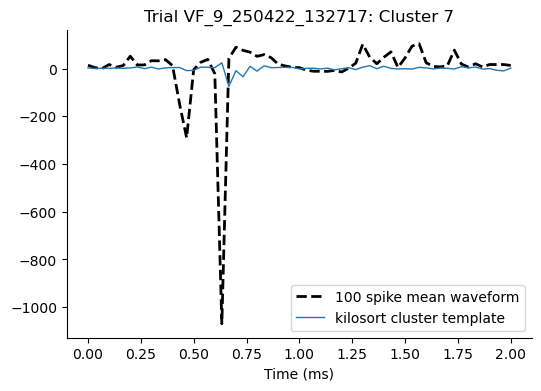

Saved plot for trial VF_9_250422_132717, cluster 10 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_10.png


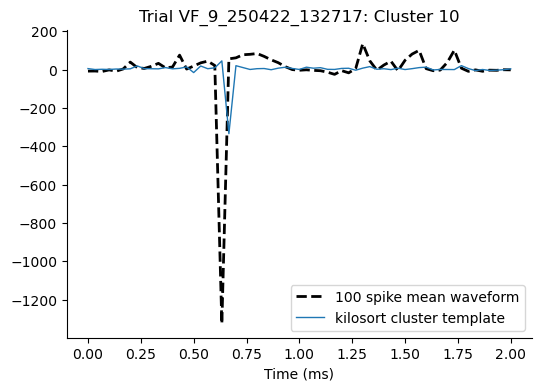

Saved plot for trial VF_9_250422_132717, cluster 13 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_13.png


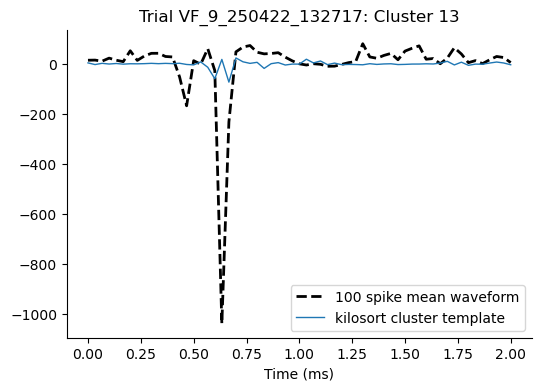

Saved plot for trial VF_9_250422_132717, cluster 15 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_15.png


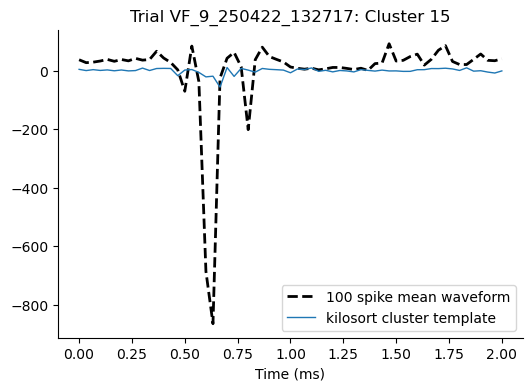

Saved plot for trial VF_9_250422_132717, cluster 17 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_17.png


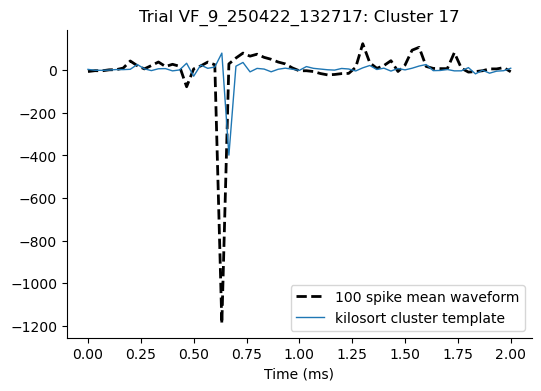

Saved plot for trial VF_9_250422_132717, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_20.png


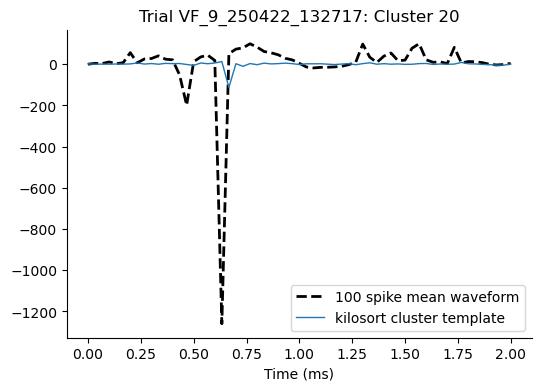

Saved plot for trial VF_9_250422_132717, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_21.png


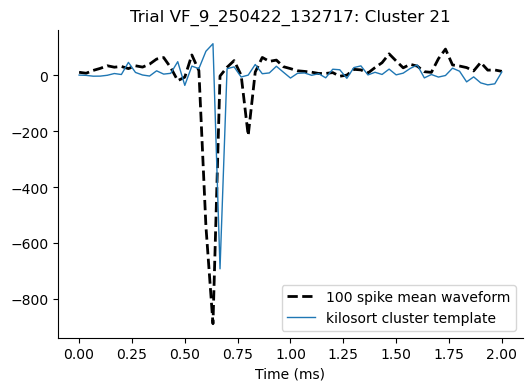

Error generating waveform for cluster 22 in trial VF_9_250422_132717: Invalid number of data points (0) specified
Saved plot for trial VF_9_250422_132717, cluster 25 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_25.png


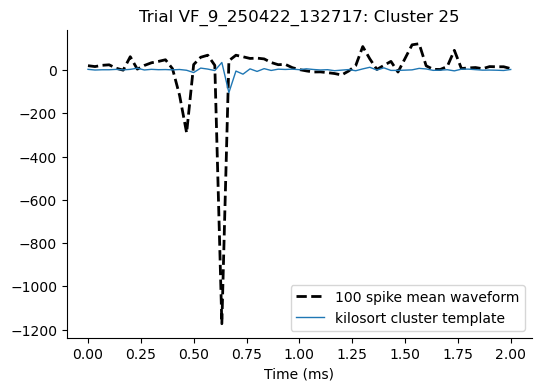

Saved plot for trial VF_9_250422_132717, cluster 27 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_27.png


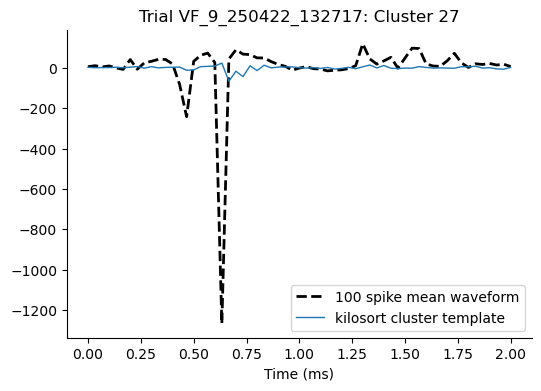

Saved plot for trial VF_9_250422_132717, cluster 29 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_29.png


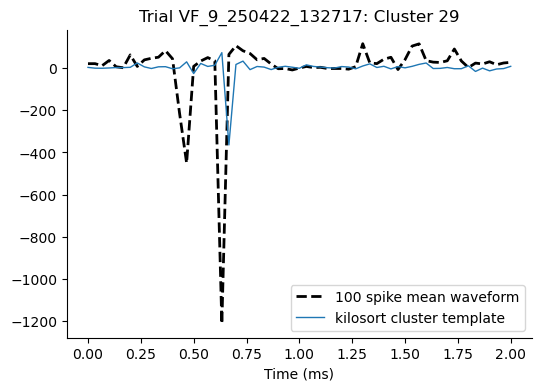

Saved plot for trial VF_9_250422_132717, cluster 30 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_30.png


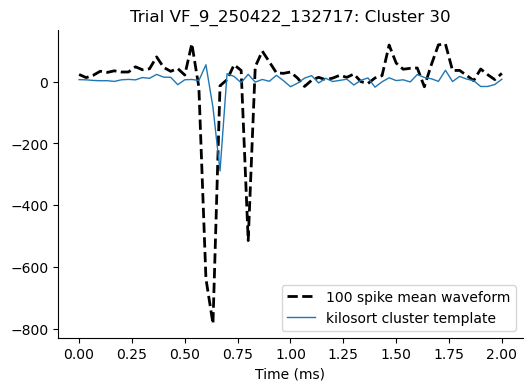

Saved plot for trial VF_9_250422_132717, cluster 31 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_31.png


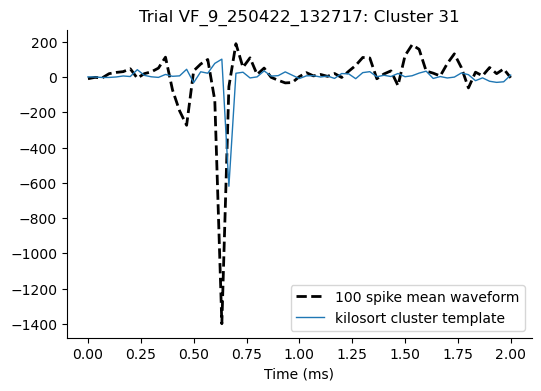

Saved plot for trial VF_9_250422_132717, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_33.png


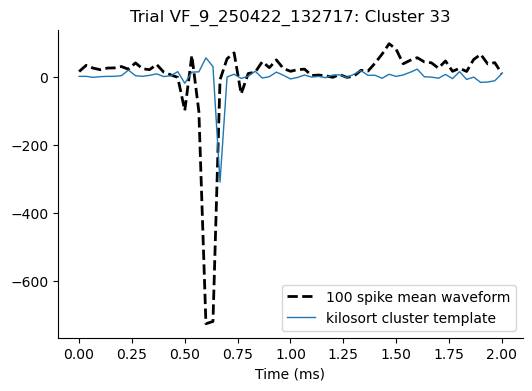

Saved plot for trial VF_9_250422_132717, cluster 34 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_34.png


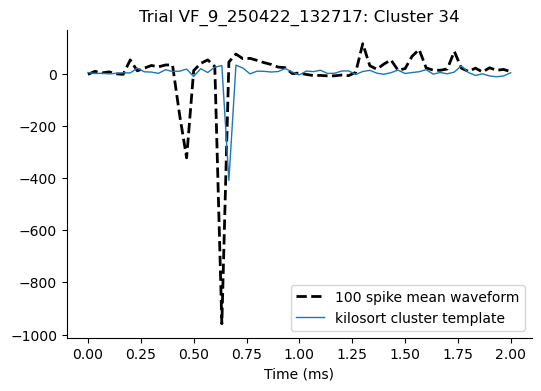

Saved plot for trial VF_9_250422_132717, cluster 36 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_36.png


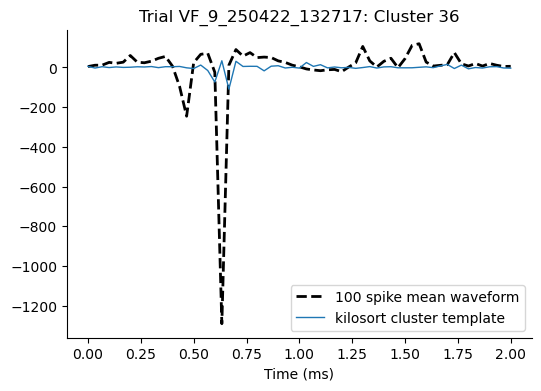

Saved plot for trial VF_9_250422_132717, cluster 39 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_39.png


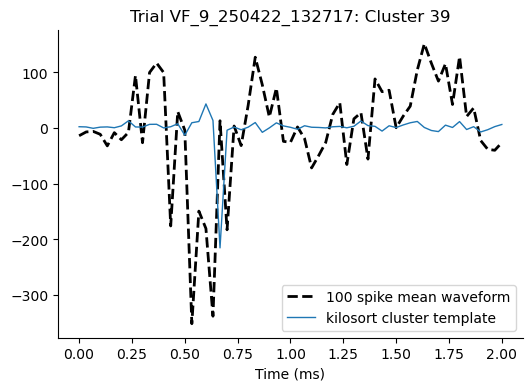

Saved plot for trial VF_9_250422_132717, cluster 40 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_40.png


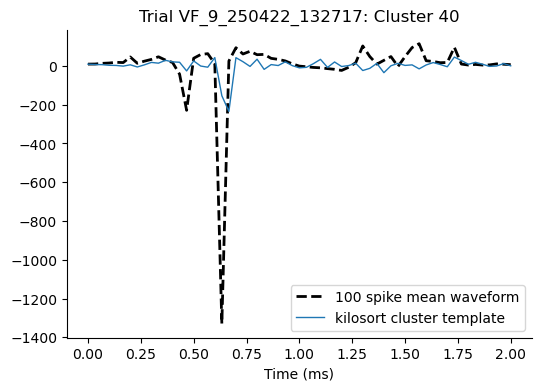

Saved plot for trial VF_9_250422_132717, cluster 42 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_42.png


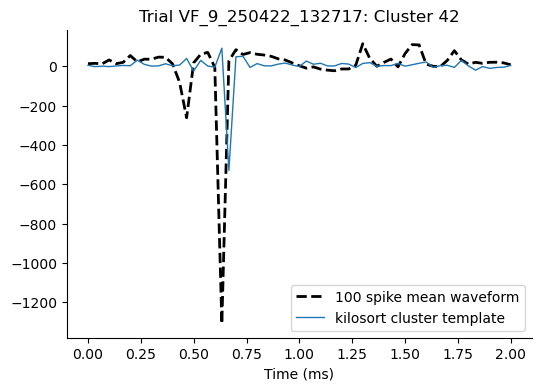

Saved plot for trial VF_9_250422_132717, cluster 43 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_43.png


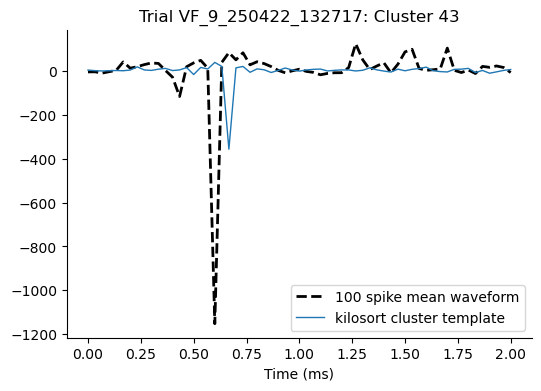

Saved plot for trial VF_9_250422_132717, cluster 45 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_45.png


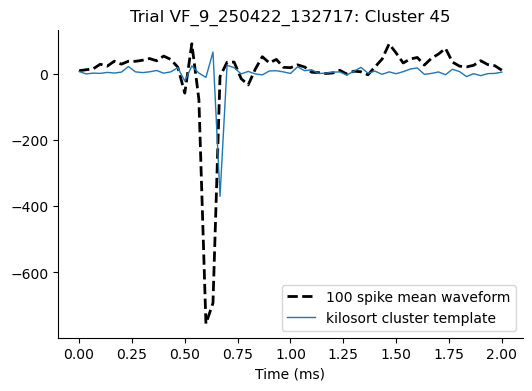

Saved plot for trial VF_9_250422_132717, cluster 47 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_47.png


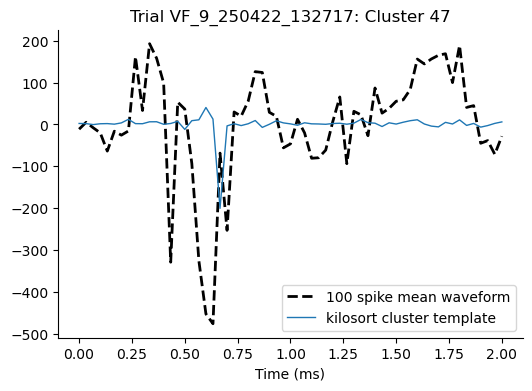

Saved plot for trial VF_9_250422_132717, cluster 49 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_49.png


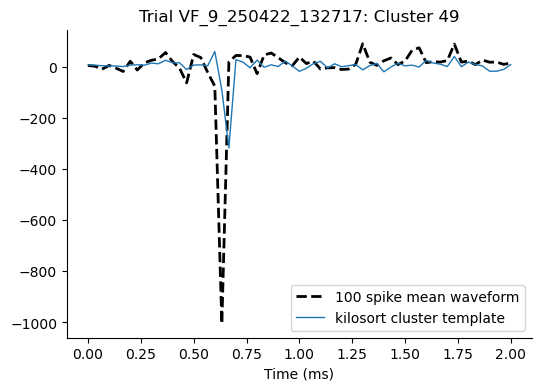

Saved plot for trial VF_9_250422_132717, cluster 52 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_9_250422_132717_cluster_52.png


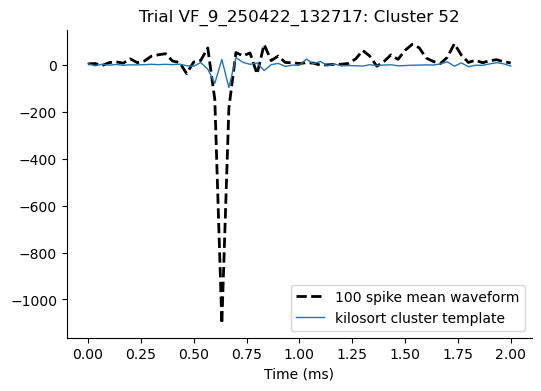

Plotting waveforms for trial VF_10_250422_133218: Good clusters found: [1, 3, 4, 8, 10, 12, 14, 16, 18, 19, 22, 23, 24, 25, 26, 31, 32, 35, 37, 42, 43, 46, 47, 48, 50]
Saved plot for trial VF_10_250422_133218, cluster 1 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_1.png


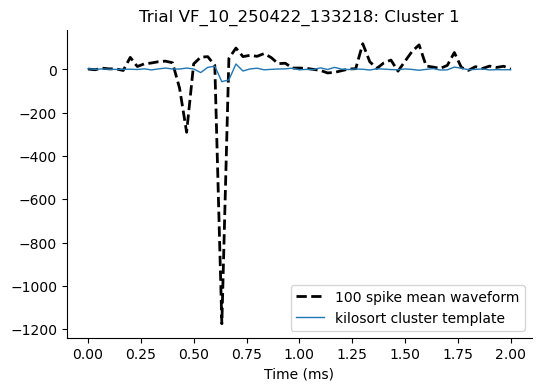

Saved plot for trial VF_10_250422_133218, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_3.png


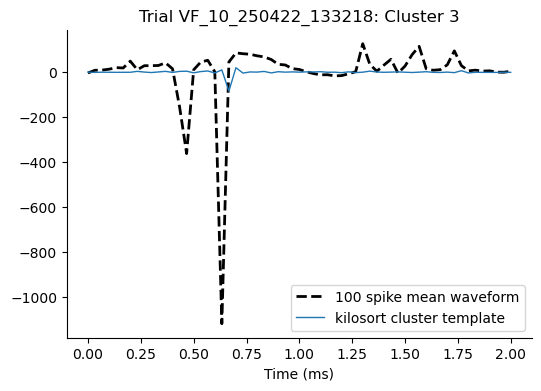

Saved plot for trial VF_10_250422_133218, cluster 4 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_4.png


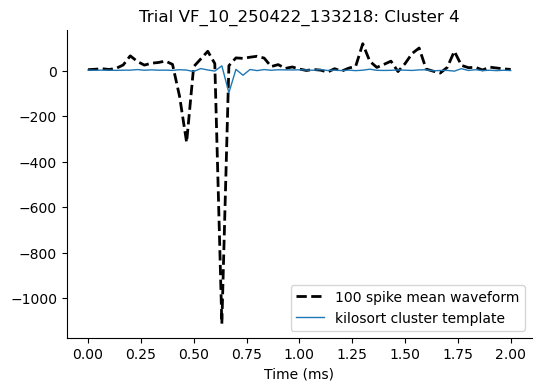

Saved plot for trial VF_10_250422_133218, cluster 8 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_8.png


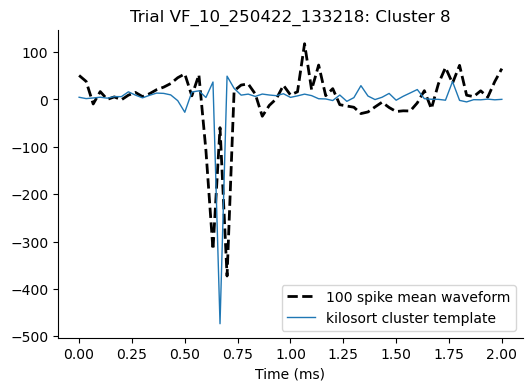

Saved plot for trial VF_10_250422_133218, cluster 10 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_10.png


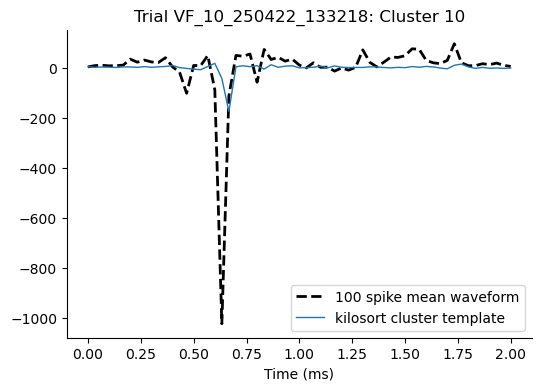

Saved plot for trial VF_10_250422_133218, cluster 12 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_12.png


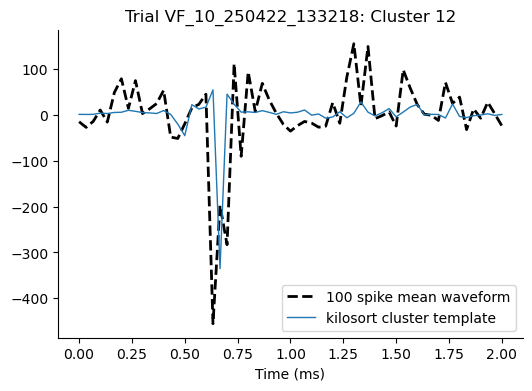

Saved plot for trial VF_10_250422_133218, cluster 14 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_14.png


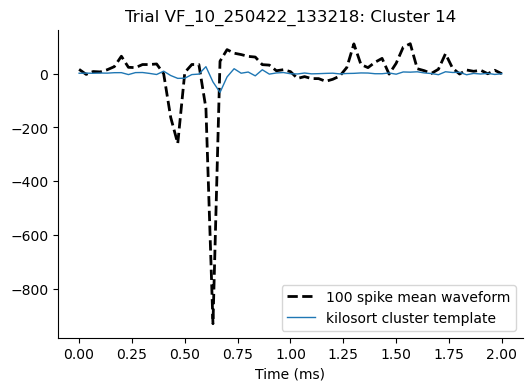

Saved plot for trial VF_10_250422_133218, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_16.png


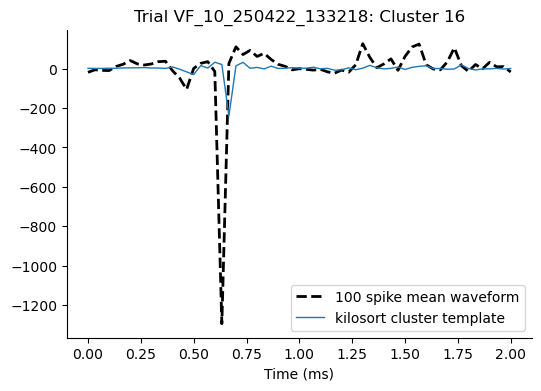

Saved plot for trial VF_10_250422_133218, cluster 18 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_18.png


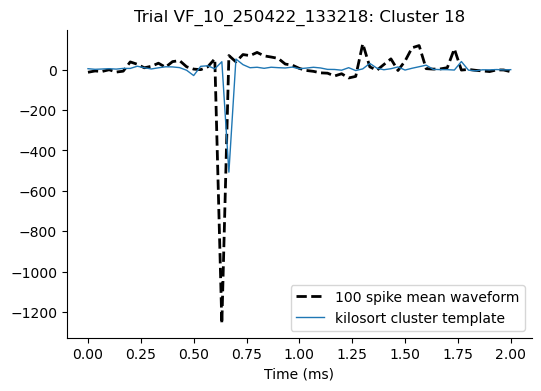

Saved plot for trial VF_10_250422_133218, cluster 19 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_19.png


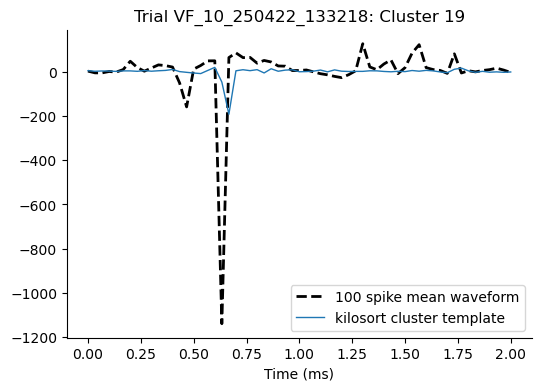

Saved plot for trial VF_10_250422_133218, cluster 22 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_22.png


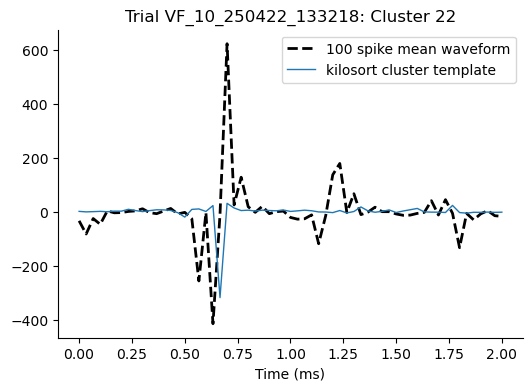

Saved plot for trial VF_10_250422_133218, cluster 23 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_23.png


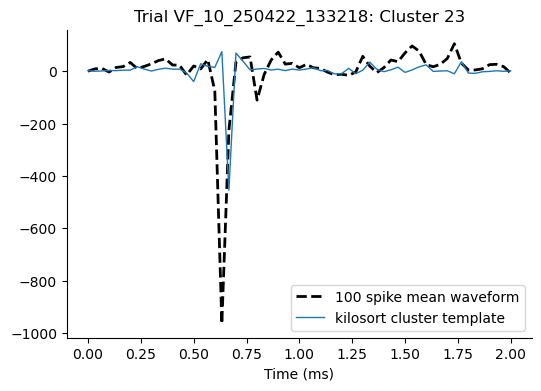

Saved plot for trial VF_10_250422_133218, cluster 24 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_24.png


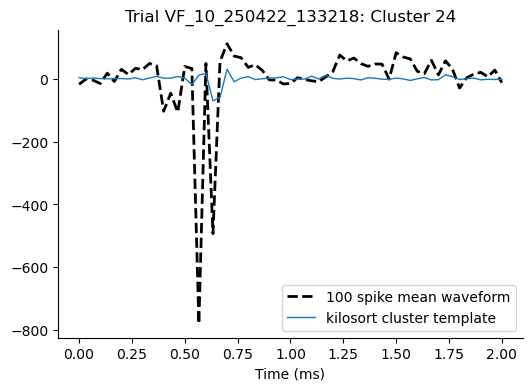

Saved plot for trial VF_10_250422_133218, cluster 25 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_25.png


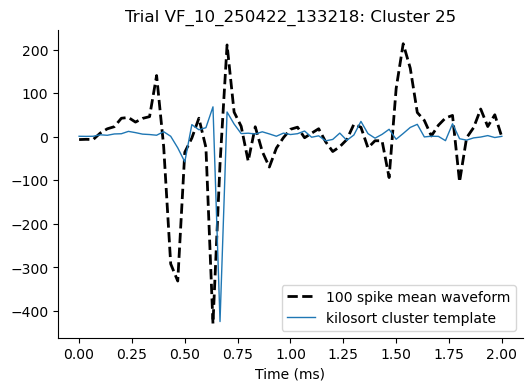

Saved plot for trial VF_10_250422_133218, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_26.png


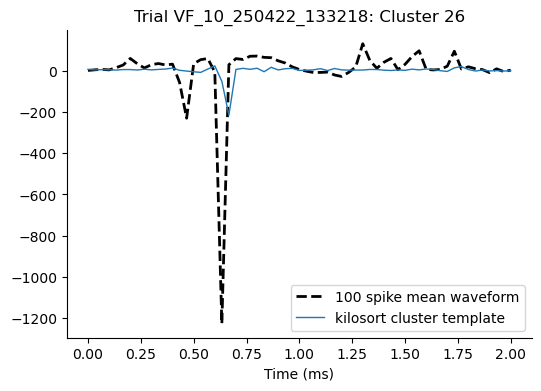

Saved plot for trial VF_10_250422_133218, cluster 31 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_31.png


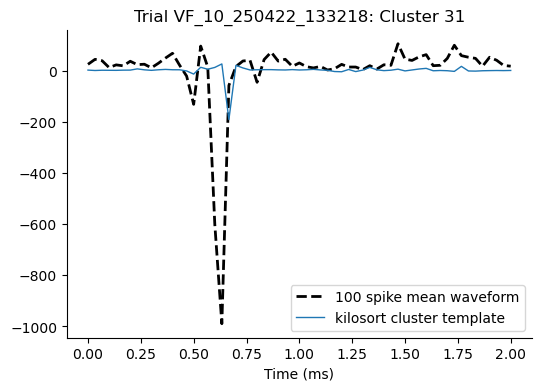

Saved plot for trial VF_10_250422_133218, cluster 32 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_32.png


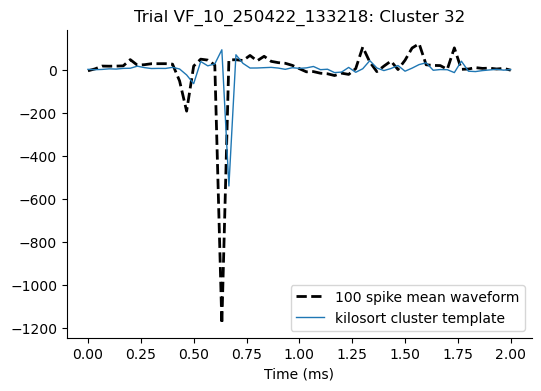

Saved plot for trial VF_10_250422_133218, cluster 35 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_35.png


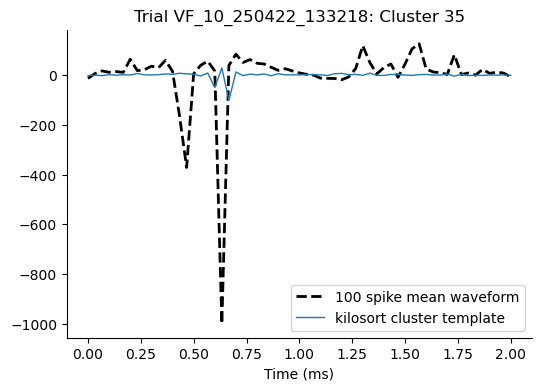

Saved plot for trial VF_10_250422_133218, cluster 37 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_37.png


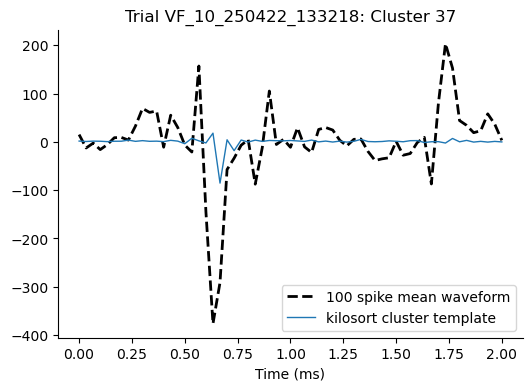

Saved plot for trial VF_10_250422_133218, cluster 42 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_42.png


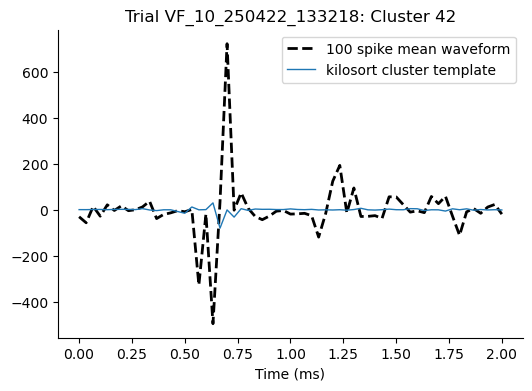

Saved plot for trial VF_10_250422_133218, cluster 43 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_43.png


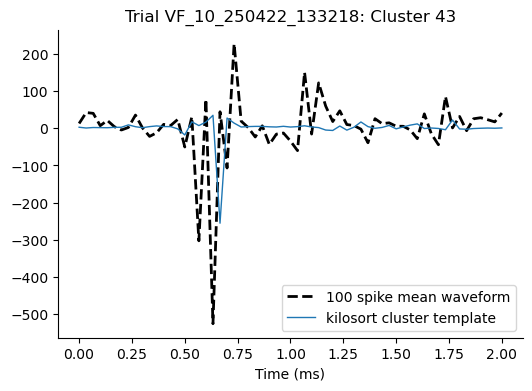

Saved plot for trial VF_10_250422_133218, cluster 46 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_46.png


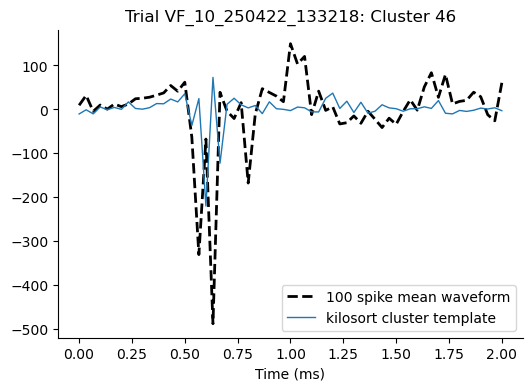

Saved plot for trial VF_10_250422_133218, cluster 47 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_47.png


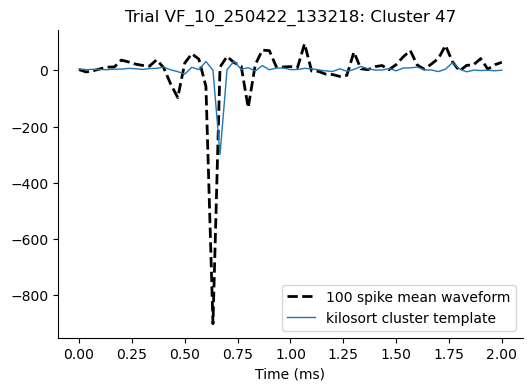

Saved plot for trial VF_10_250422_133218, cluster 48 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_48.png


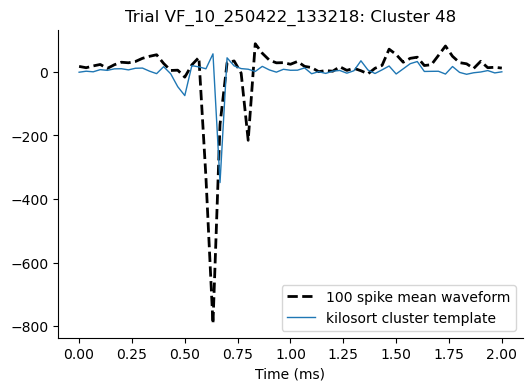

Saved plot for trial VF_10_250422_133218, cluster 50 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_10_250422_133218_cluster_50.png


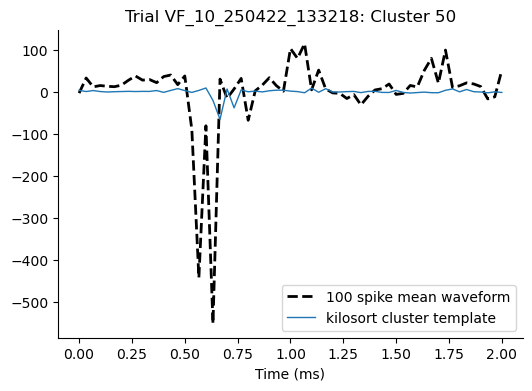

Plotting waveforms for trial VF_11_250422_133722: Good clusters found: [0, 2, 4, 5, 7, 11, 14, 17, 18, 20, 21, 24, 25, 26, 27, 29, 30, 31, 32, 33, 37, 38, 39, 40, 43, 44, 47, 48, 51, 52, 53, 54, 57]
Saved plot for trial VF_11_250422_133722, cluster 0 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_0.png


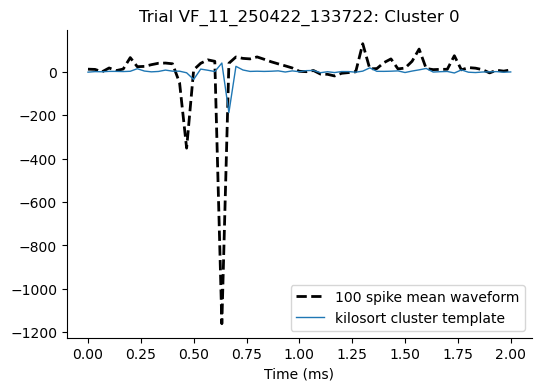

Saved plot for trial VF_11_250422_133722, cluster 2 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_2.png


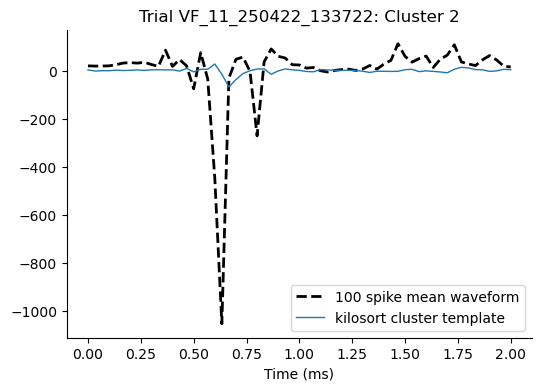

Saved plot for trial VF_11_250422_133722, cluster 4 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_4.png


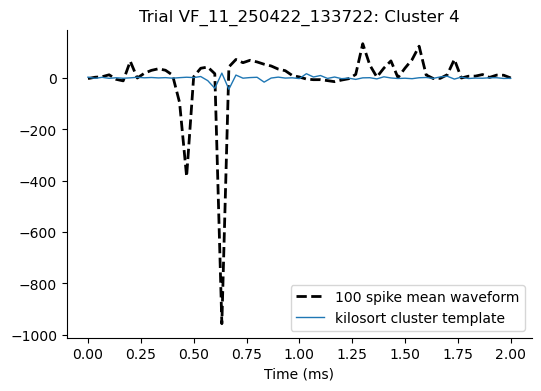

Saved plot for trial VF_11_250422_133722, cluster 5 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_5.png


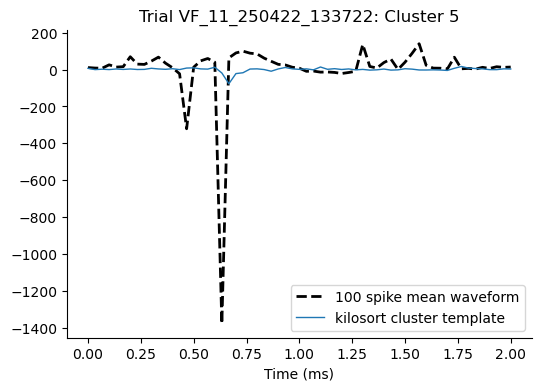

Saved plot for trial VF_11_250422_133722, cluster 7 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_7.png


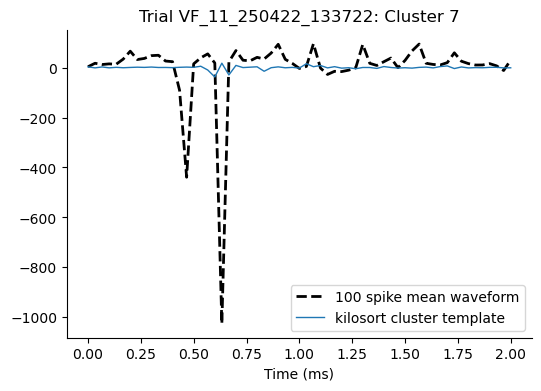

Saved plot for trial VF_11_250422_133722, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_11.png


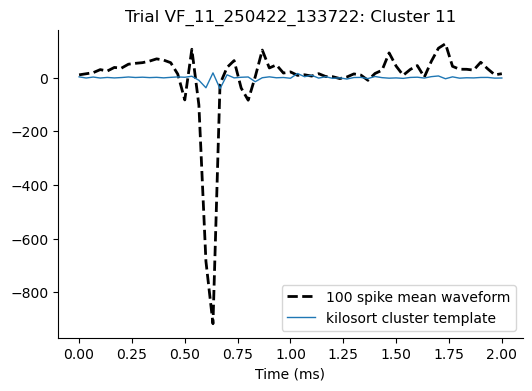

Saved plot for trial VF_11_250422_133722, cluster 14 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_14.png


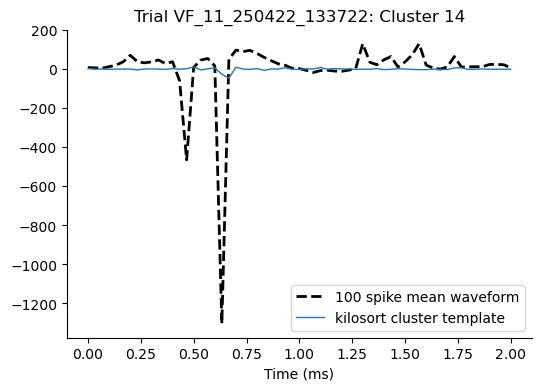

Saved plot for trial VF_11_250422_133722, cluster 17 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_17.png


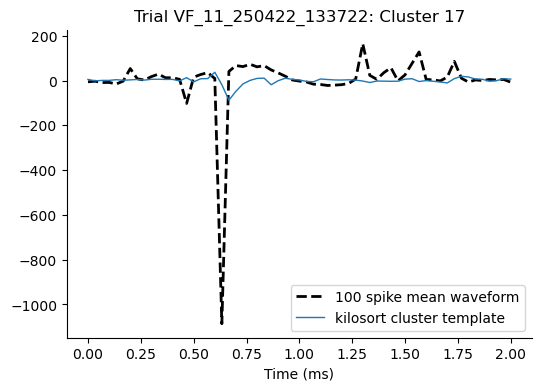

Saved plot for trial VF_11_250422_133722, cluster 18 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_18.png


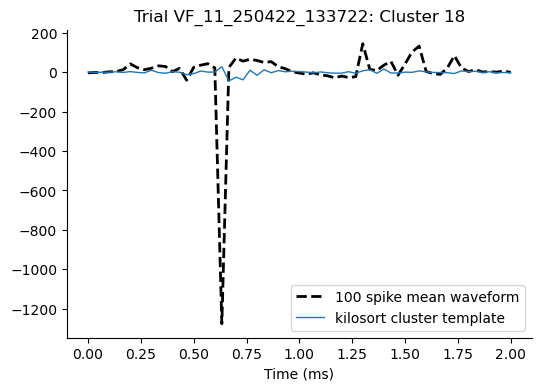

Saved plot for trial VF_11_250422_133722, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_20.png


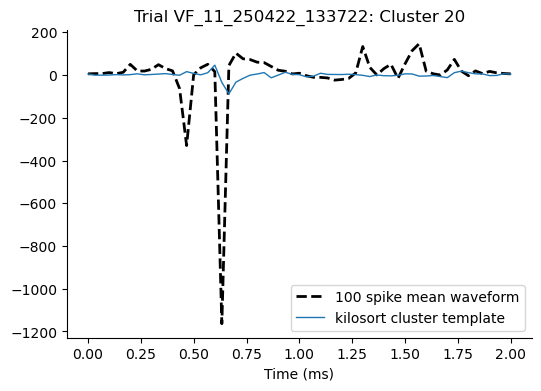

Saved plot for trial VF_11_250422_133722, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_21.png


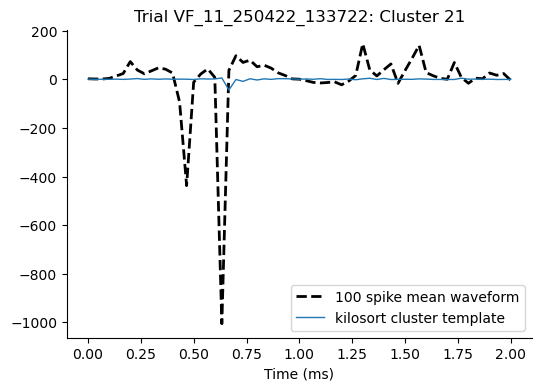

Saved plot for trial VF_11_250422_133722, cluster 24 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_24.png


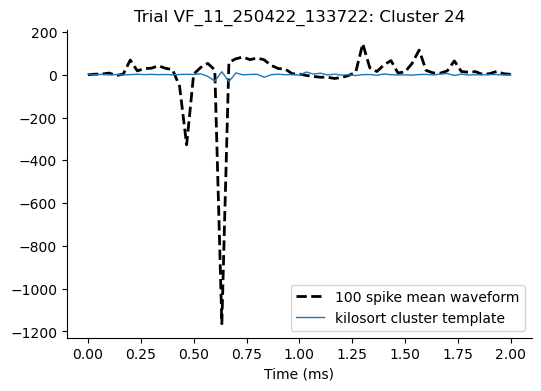

Saved plot for trial VF_11_250422_133722, cluster 25 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_25.png


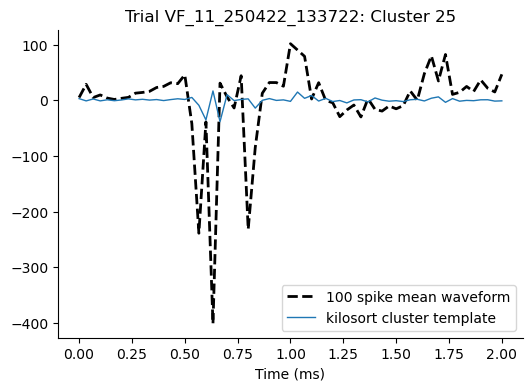

Saved plot for trial VF_11_250422_133722, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_26.png


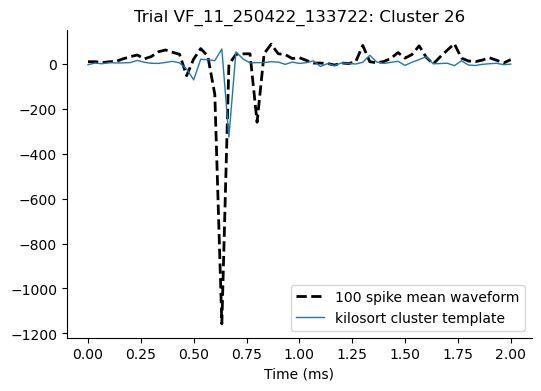

Saved plot for trial VF_11_250422_133722, cluster 27 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_27.png


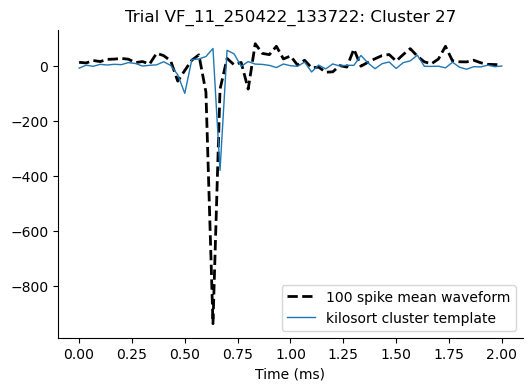

Saved plot for trial VF_11_250422_133722, cluster 29 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_29.png


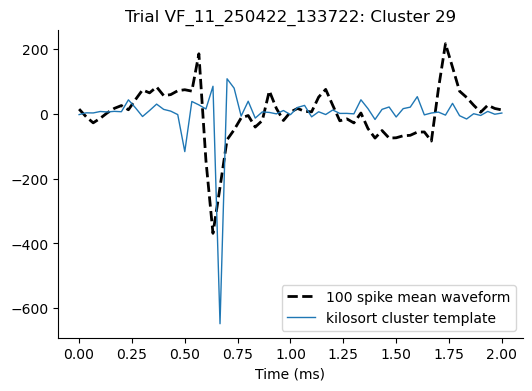

Saved plot for trial VF_11_250422_133722, cluster 30 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_30.png


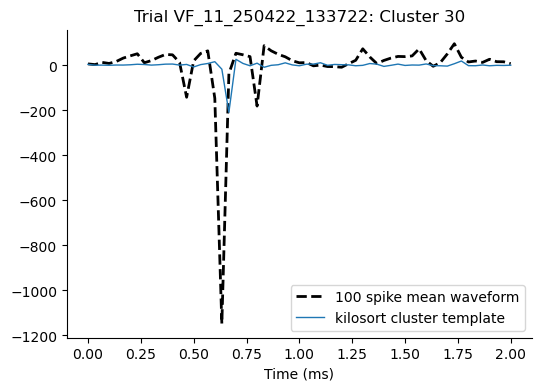

Saved plot for trial VF_11_250422_133722, cluster 31 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_31.png


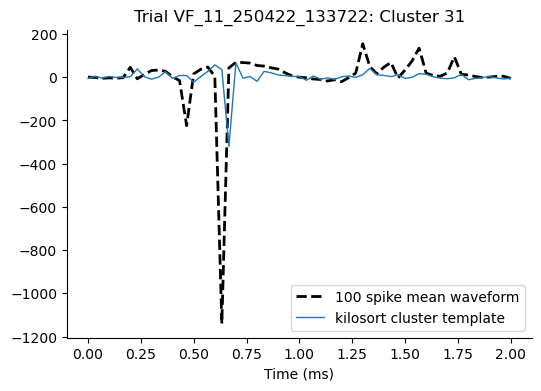

Saved plot for trial VF_11_250422_133722, cluster 32 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_32.png


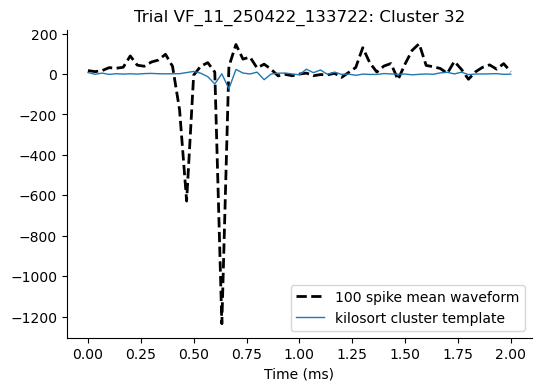

Saved plot for trial VF_11_250422_133722, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_33.png


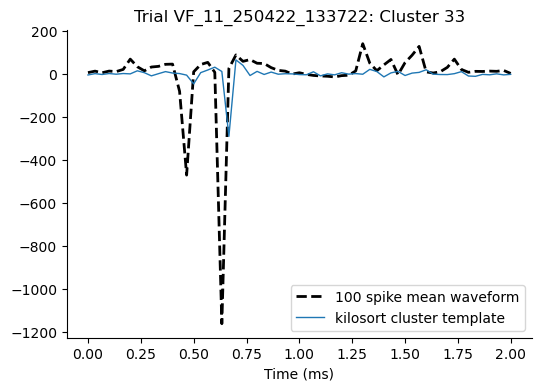

Saved plot for trial VF_11_250422_133722, cluster 37 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_37.png


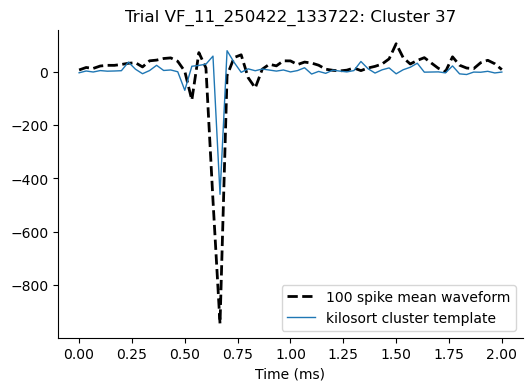

Saved plot for trial VF_11_250422_133722, cluster 38 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_38.png


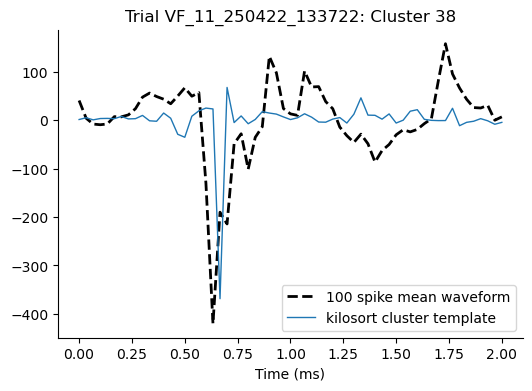

Saved plot for trial VF_11_250422_133722, cluster 39 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_39.png


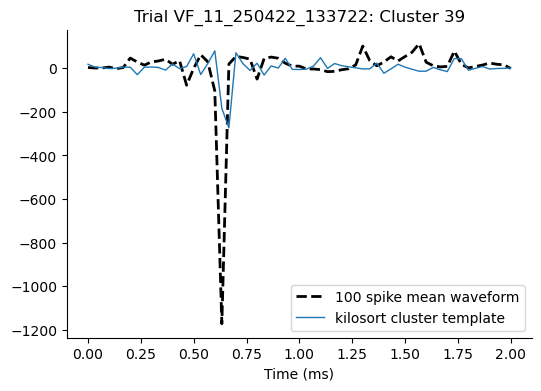

Saved plot for trial VF_11_250422_133722, cluster 40 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_40.png


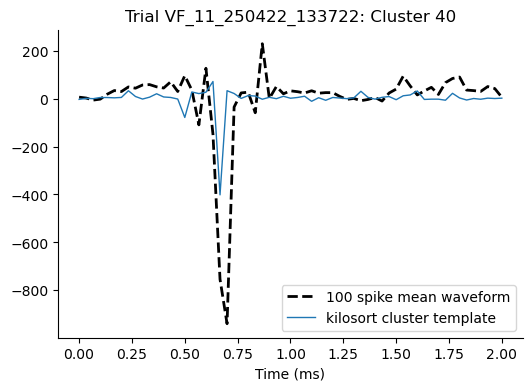

Saved plot for trial VF_11_250422_133722, cluster 43 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_43.png


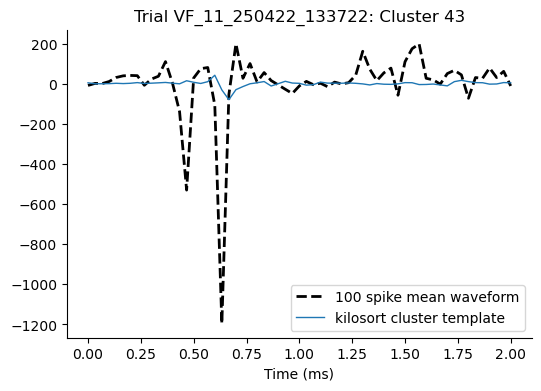

Saved plot for trial VF_11_250422_133722, cluster 44 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_44.png


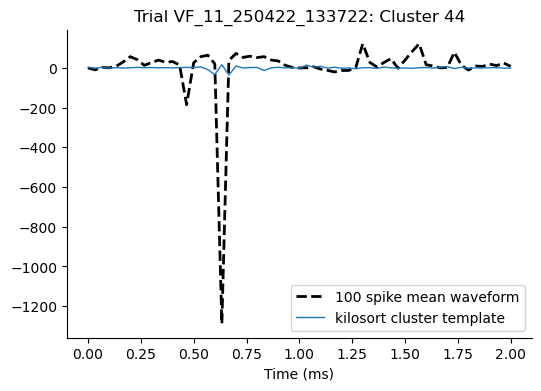

Saved plot for trial VF_11_250422_133722, cluster 47 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_47.png


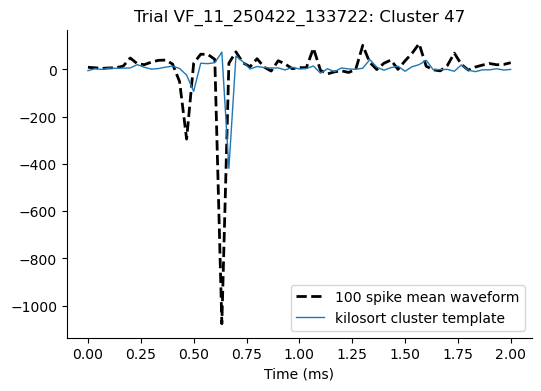

Saved plot for trial VF_11_250422_133722, cluster 48 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_48.png


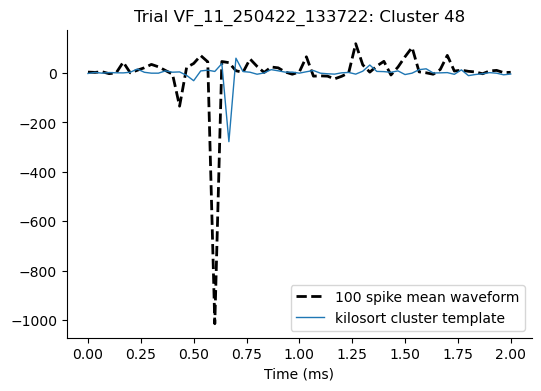

Saved plot for trial VF_11_250422_133722, cluster 51 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_51.png


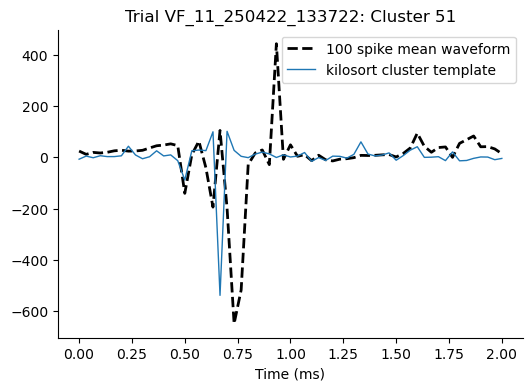

Saved plot for trial VF_11_250422_133722, cluster 52 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_52.png


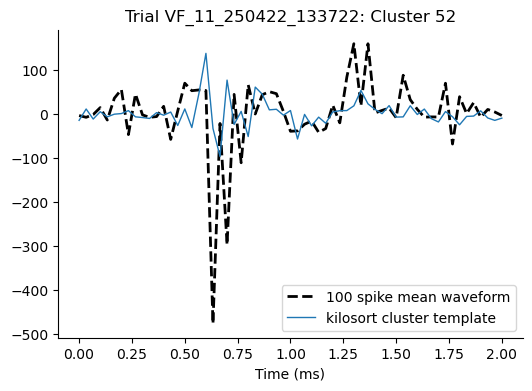

Saved plot for trial VF_11_250422_133722, cluster 53 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_53.png


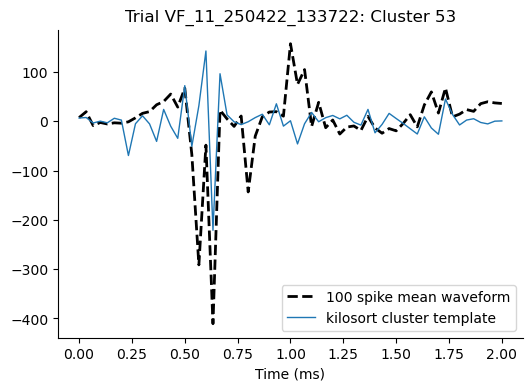

Saved plot for trial VF_11_250422_133722, cluster 54 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_54.png


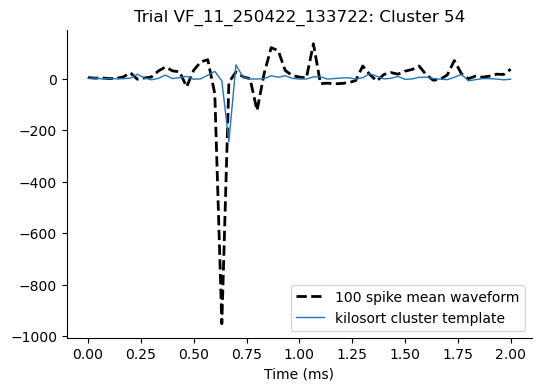

Saved plot for trial VF_11_250422_133722, cluster 57 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_11_250422_133722_cluster_57.png


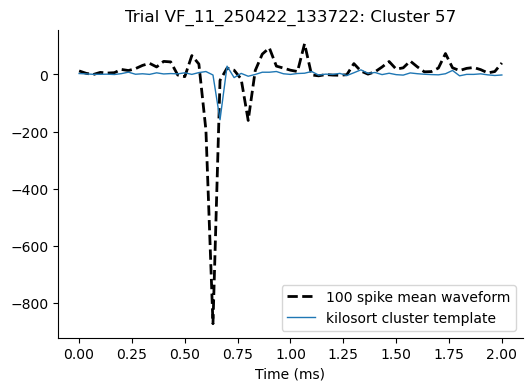

Plotting waveforms for trial VF_12_250422_134214: Good clusters found: [0, 1, 5, 8, 9, 10, 11, 15, 16, 18, 19, 21, 23, 27, 30, 33, 34, 35, 38, 39, 40, 42, 47, 48, 51, 52, 54, 55, 57, 58, 59, 63]
Saved plot for trial VF_12_250422_134214, cluster 0 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_0.png


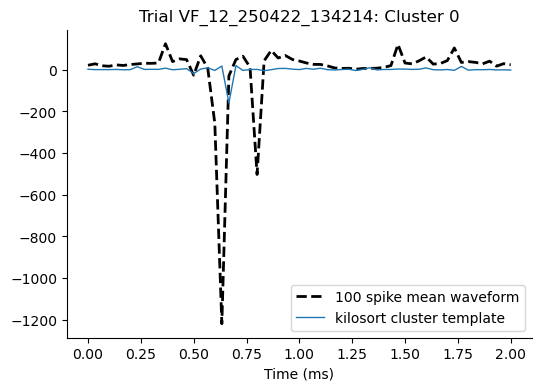

Saved plot for trial VF_12_250422_134214, cluster 1 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_1.png


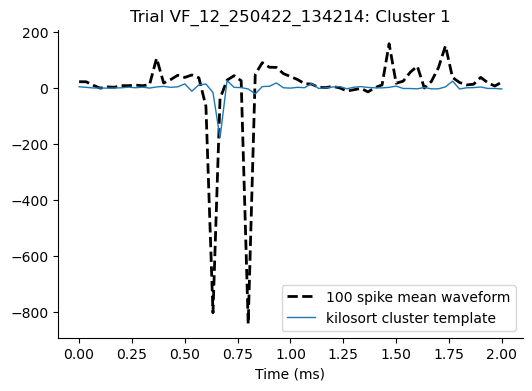

Saved plot for trial VF_12_250422_134214, cluster 5 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_5.png


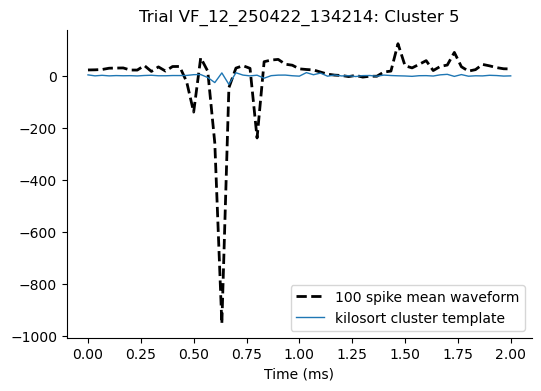

Saved plot for trial VF_12_250422_134214, cluster 8 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_8.png


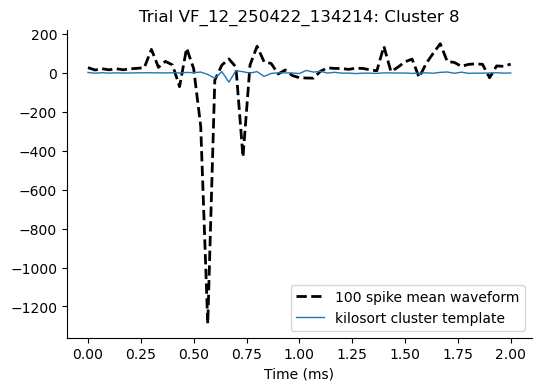

Saved plot for trial VF_12_250422_134214, cluster 9 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_9.png


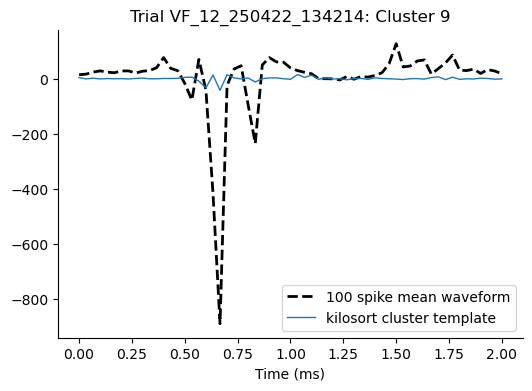

Saved plot for trial VF_12_250422_134214, cluster 10 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_10.png


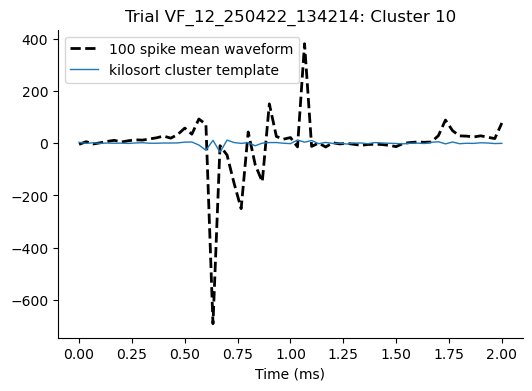

Saved plot for trial VF_12_250422_134214, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_11.png


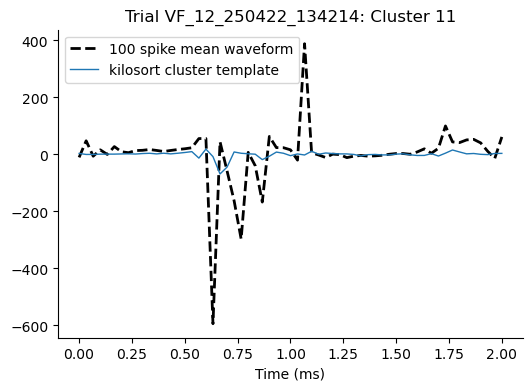

Saved plot for trial VF_12_250422_134214, cluster 15 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_15.png


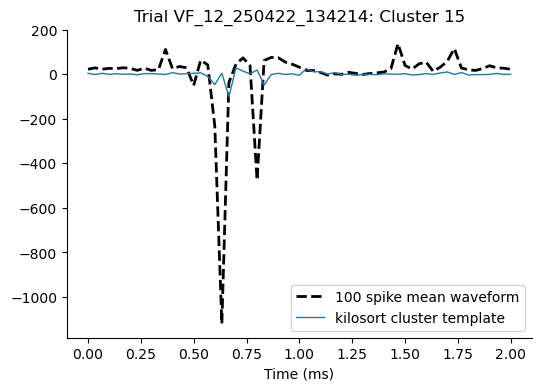

Saved plot for trial VF_12_250422_134214, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_16.png


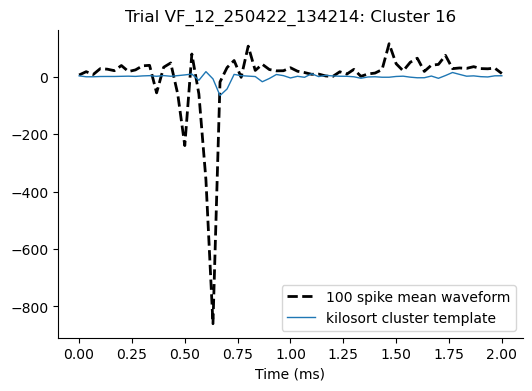

Saved plot for trial VF_12_250422_134214, cluster 18 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_18.png


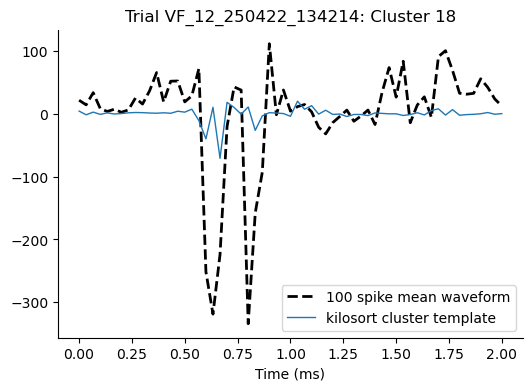

Saved plot for trial VF_12_250422_134214, cluster 19 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_19.png


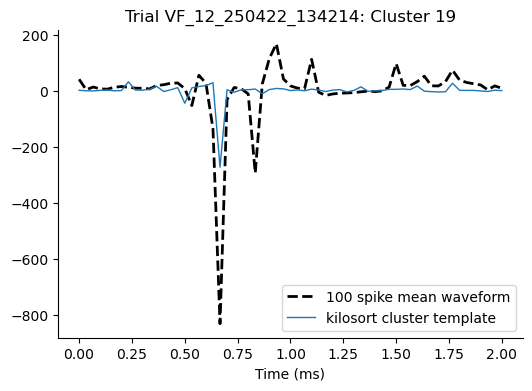

Saved plot for trial VF_12_250422_134214, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_21.png


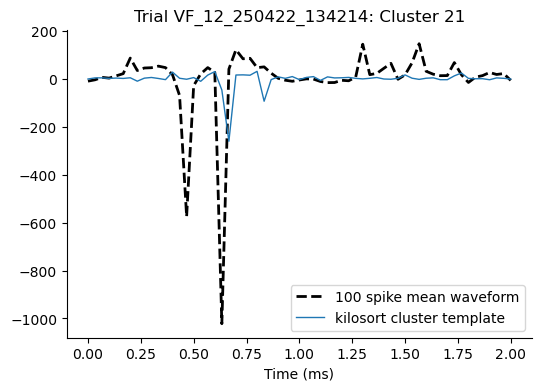

Saved plot for trial VF_12_250422_134214, cluster 23 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_23.png


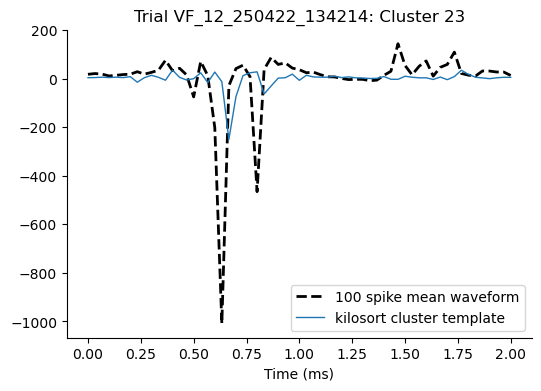

Saved plot for trial VF_12_250422_134214, cluster 27 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_27.png


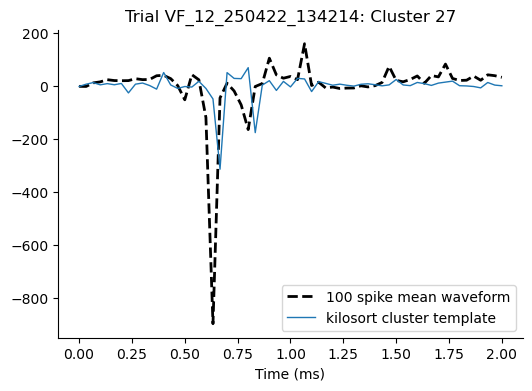

Saved plot for trial VF_12_250422_134214, cluster 30 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_30.png


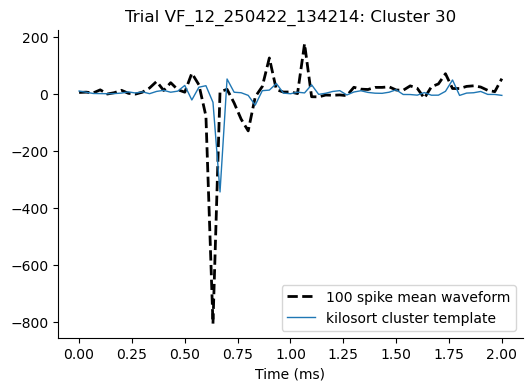

Saved plot for trial VF_12_250422_134214, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_33.png


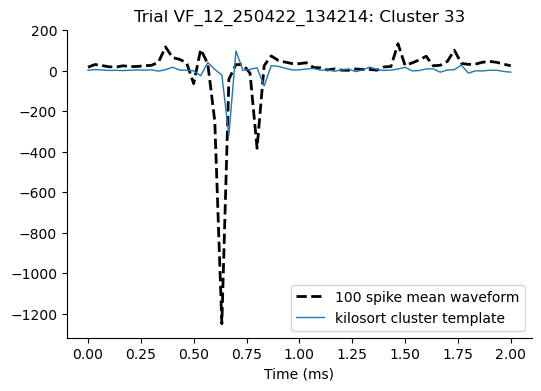

Saved plot for trial VF_12_250422_134214, cluster 34 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_34.png


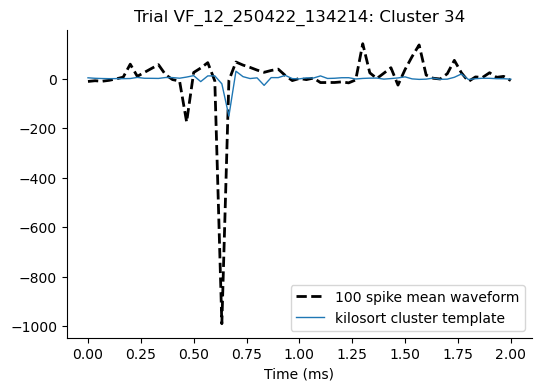

Saved plot for trial VF_12_250422_134214, cluster 35 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_35.png


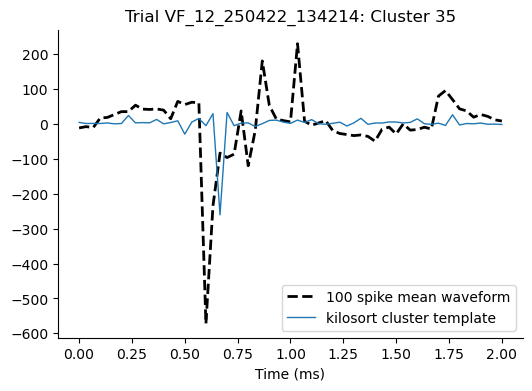

Saved plot for trial VF_12_250422_134214, cluster 38 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_38.png


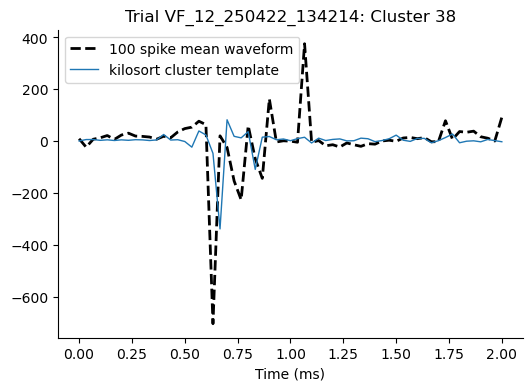

Saved plot for trial VF_12_250422_134214, cluster 39 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_39.png


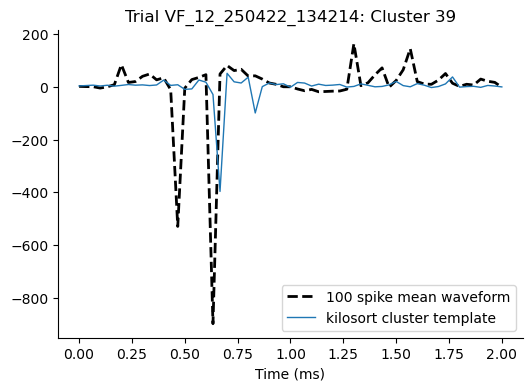

Saved plot for trial VF_12_250422_134214, cluster 40 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_40.png


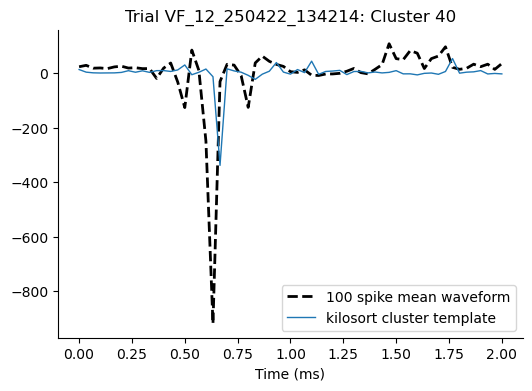

Saved plot for trial VF_12_250422_134214, cluster 42 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_42.png


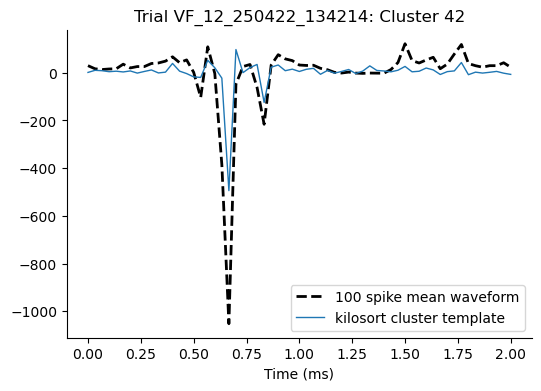

Saved plot for trial VF_12_250422_134214, cluster 47 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_47.png


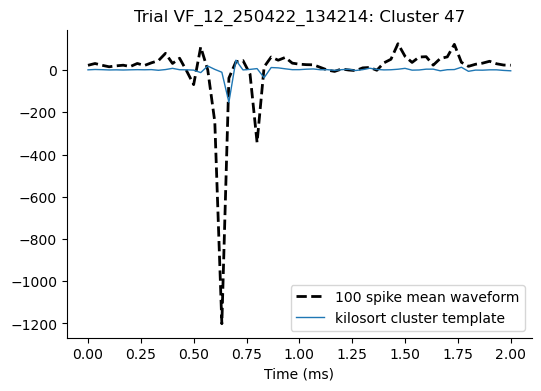

Saved plot for trial VF_12_250422_134214, cluster 48 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_48.png


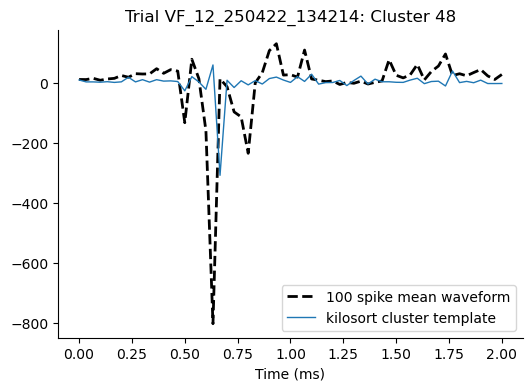

Saved plot for trial VF_12_250422_134214, cluster 51 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_51.png


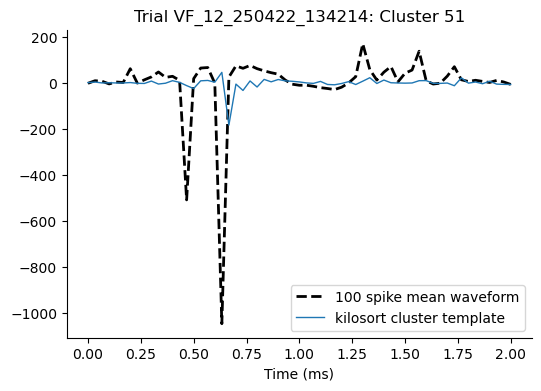

Saved plot for trial VF_12_250422_134214, cluster 52 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_52.png


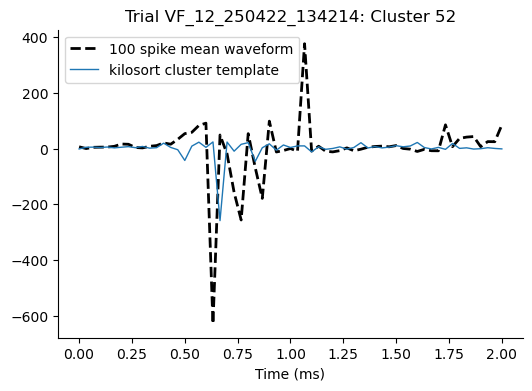

Saved plot for trial VF_12_250422_134214, cluster 54 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_54.png


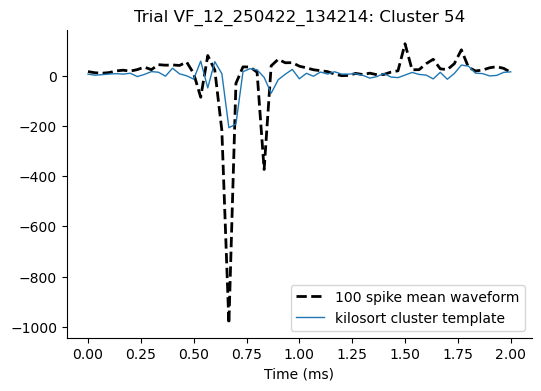

Saved plot for trial VF_12_250422_134214, cluster 55 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_55.png


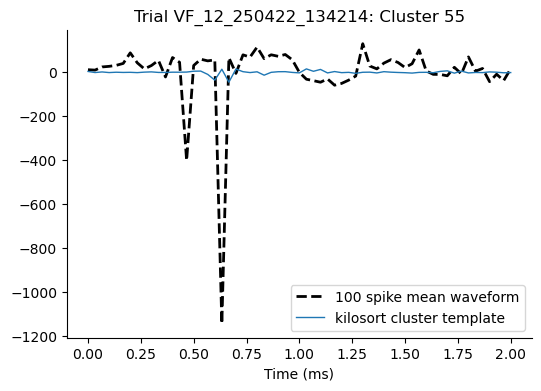

Saved plot for trial VF_12_250422_134214, cluster 57 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_57.png


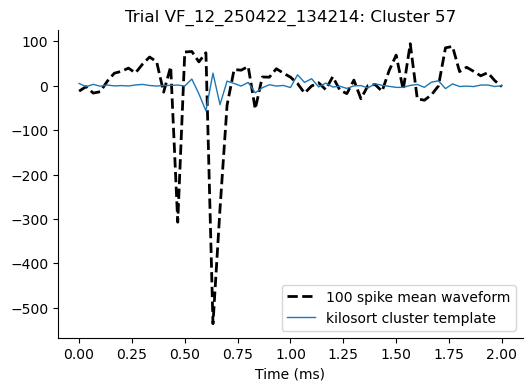

Saved plot for trial VF_12_250422_134214, cluster 58 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_58.png


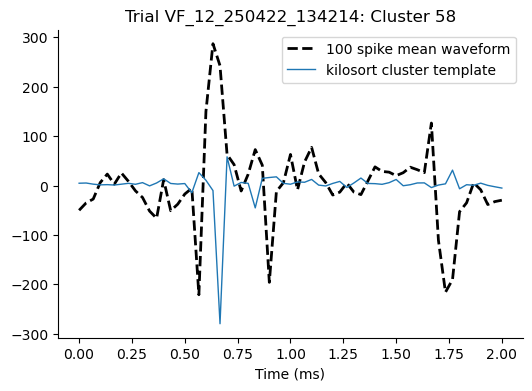

Saved plot for trial VF_12_250422_134214, cluster 59 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_59.png


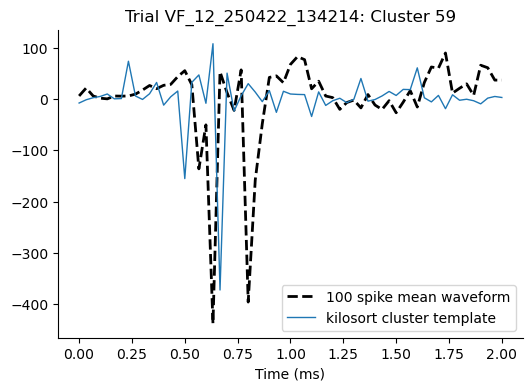

Saved plot for trial VF_12_250422_134214, cluster 63 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_12_250422_134214_cluster_63.png


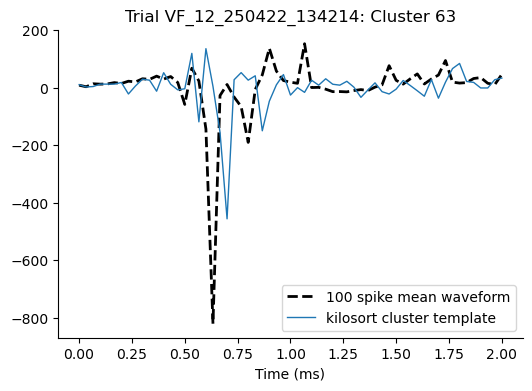

Plotting waveforms for trial VF_13_250422_134725: Good clusters found: [1, 3, 4, 5, 11, 12, 19, 20, 21, 23, 24, 26, 27, 28, 30, 32, 35, 37, 39, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 56, 57, 58, 61]
Saved plot for trial VF_13_250422_134725, cluster 1 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_1.png


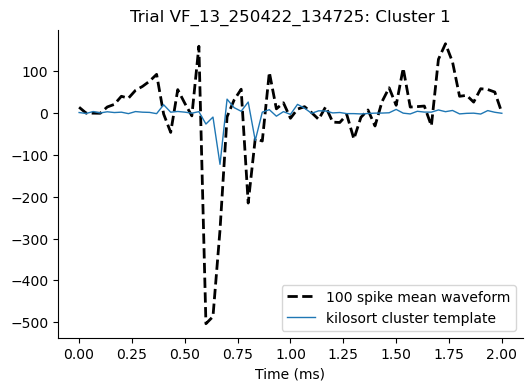

Saved plot for trial VF_13_250422_134725, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_3.png


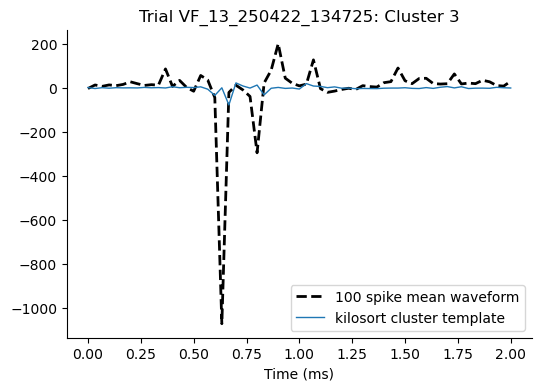

Saved plot for trial VF_13_250422_134725, cluster 4 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_4.png


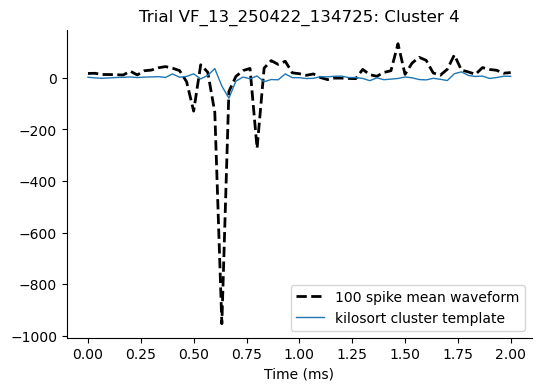

Saved plot for trial VF_13_250422_134725, cluster 5 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_5.png


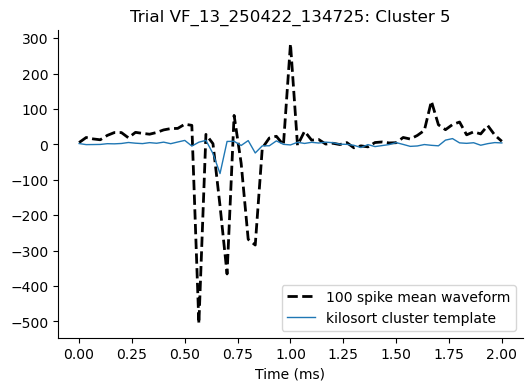

Saved plot for trial VF_13_250422_134725, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_11.png


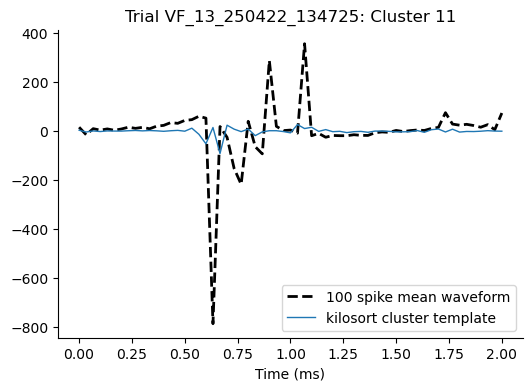

Saved plot for trial VF_13_250422_134725, cluster 12 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_12.png


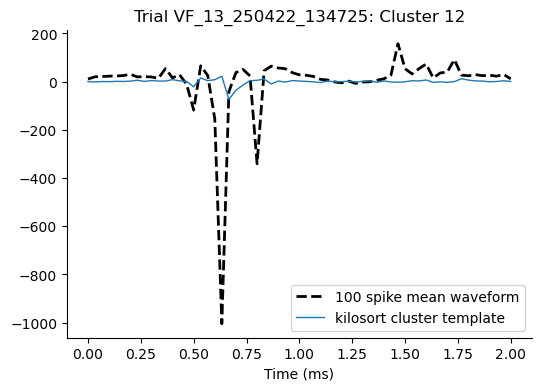

Saved plot for trial VF_13_250422_134725, cluster 19 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_19.png


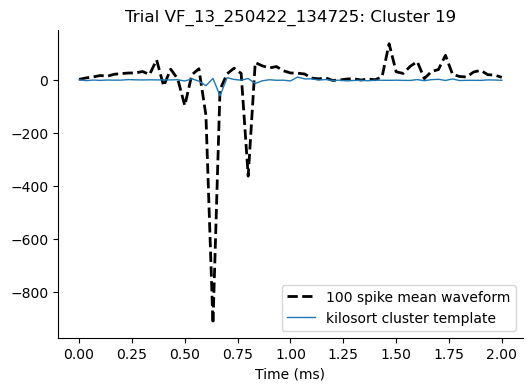

Saved plot for trial VF_13_250422_134725, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_20.png


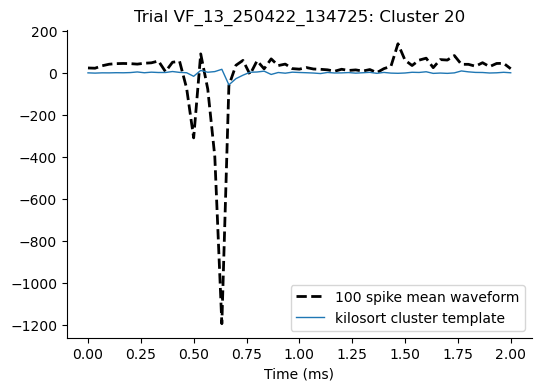

Saved plot for trial VF_13_250422_134725, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_21.png


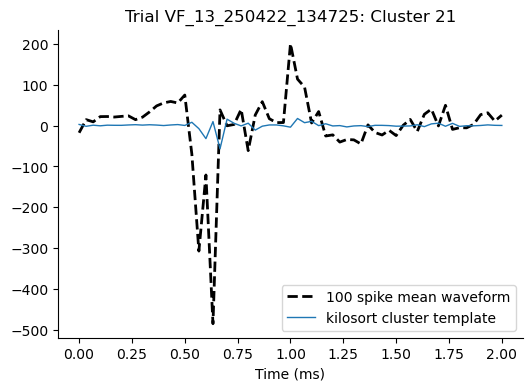

Saved plot for trial VF_13_250422_134725, cluster 23 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_23.png


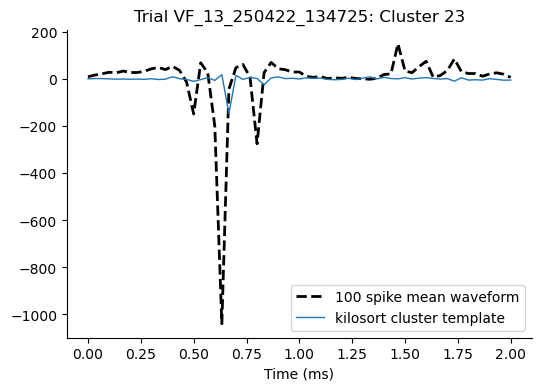

Saved plot for trial VF_13_250422_134725, cluster 24 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_24.png


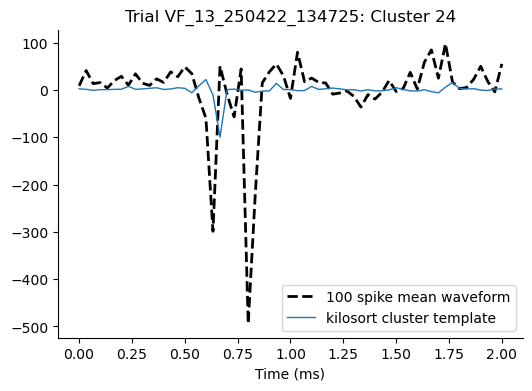

Saved plot for trial VF_13_250422_134725, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_26.png


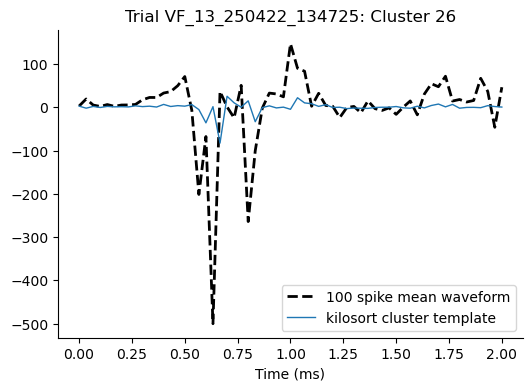

Saved plot for trial VF_13_250422_134725, cluster 27 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_27.png


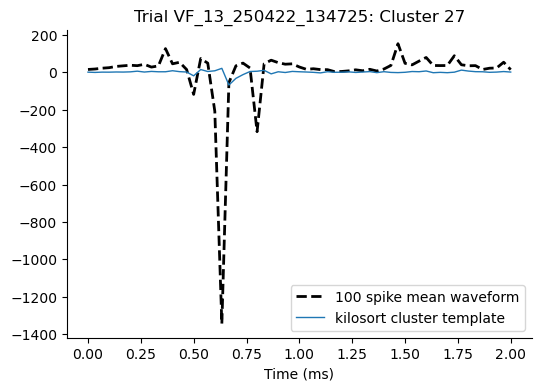

Saved plot for trial VF_13_250422_134725, cluster 28 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_28.png


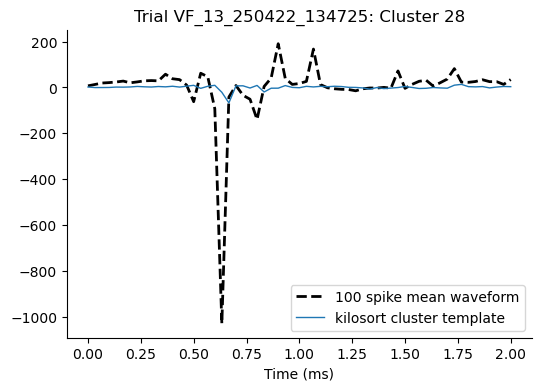

Saved plot for trial VF_13_250422_134725, cluster 30 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_30.png


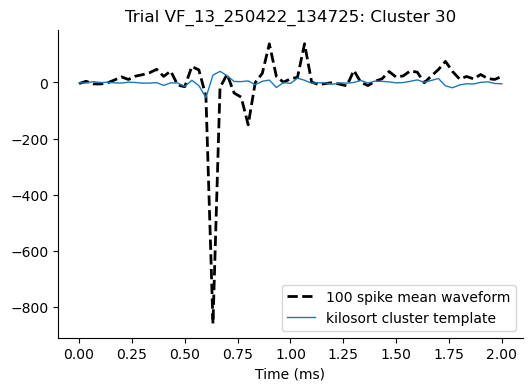

Saved plot for trial VF_13_250422_134725, cluster 32 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_32.png


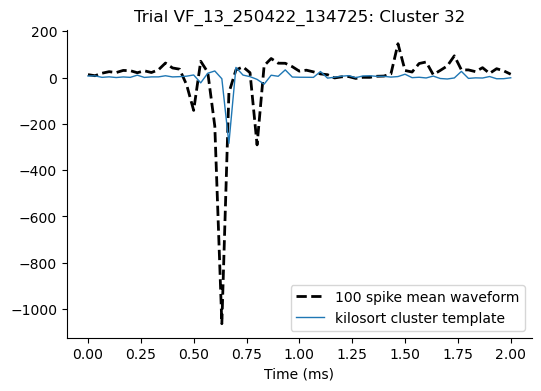

Saved plot for trial VF_13_250422_134725, cluster 35 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_35.png


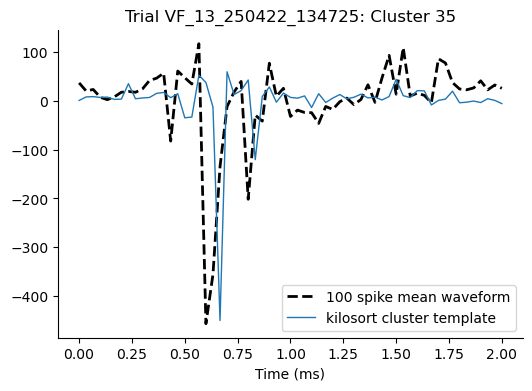

Saved plot for trial VF_13_250422_134725, cluster 37 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_37.png


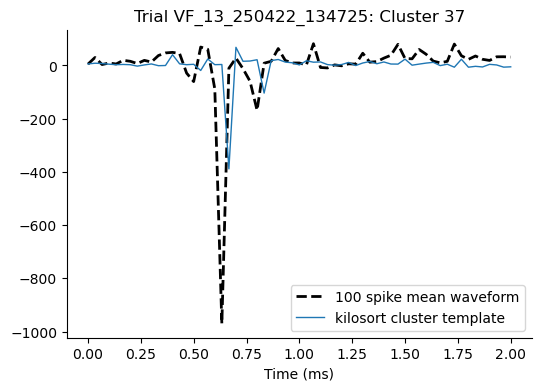

Saved plot for trial VF_13_250422_134725, cluster 39 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_39.png


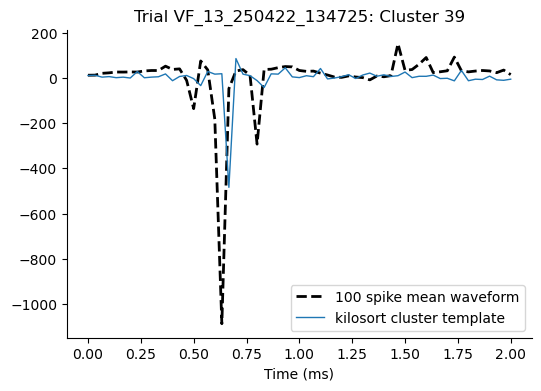

Saved plot for trial VF_13_250422_134725, cluster 42 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_42.png


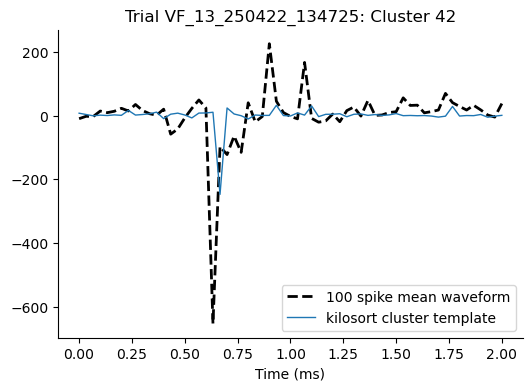

Saved plot for trial VF_13_250422_134725, cluster 44 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_44.png


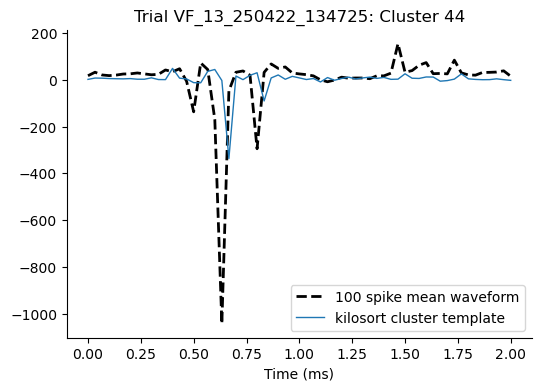

Saved plot for trial VF_13_250422_134725, cluster 45 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_45.png


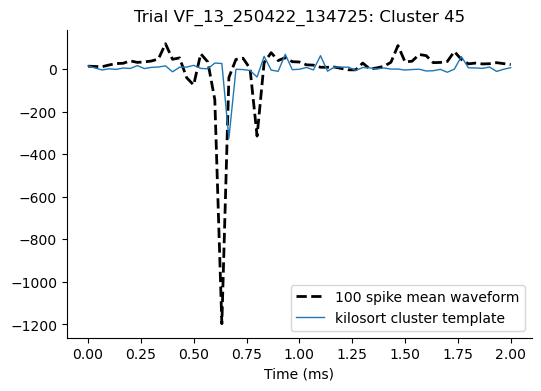

Saved plot for trial VF_13_250422_134725, cluster 46 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_46.png


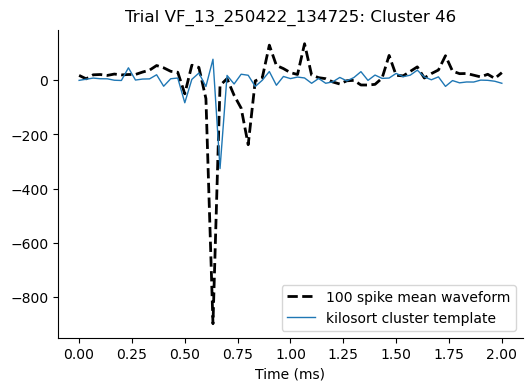

Saved plot for trial VF_13_250422_134725, cluster 47 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_47.png


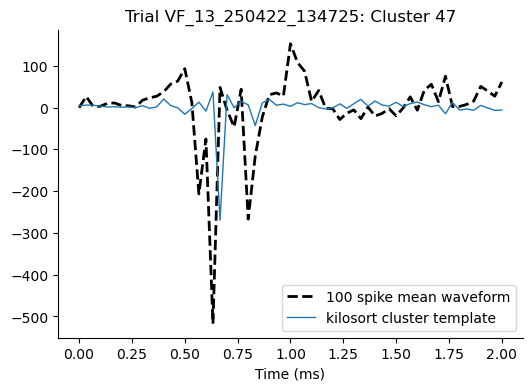

Saved plot for trial VF_13_250422_134725, cluster 48 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_48.png


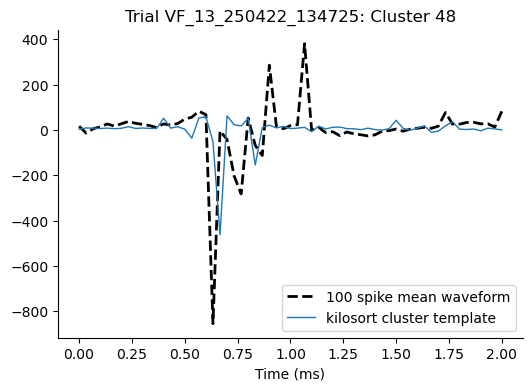

Saved plot for trial VF_13_250422_134725, cluster 49 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_49.png


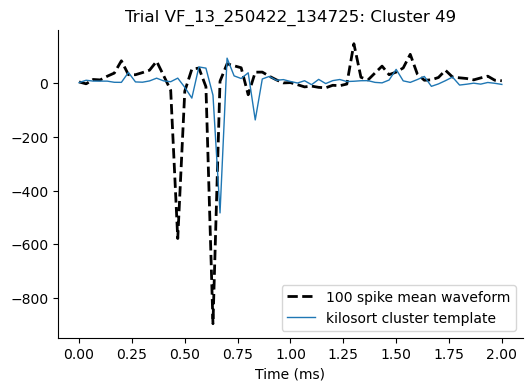

Saved plot for trial VF_13_250422_134725, cluster 50 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_50.png


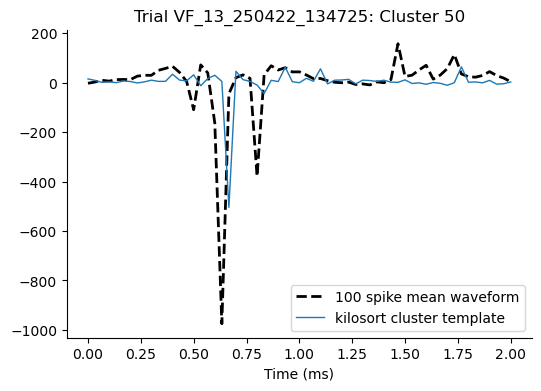

Saved plot for trial VF_13_250422_134725, cluster 52 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_52.png


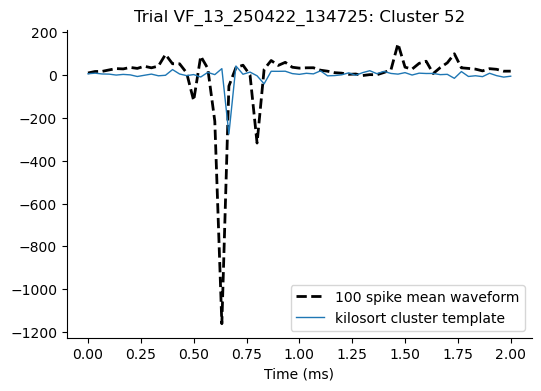

Saved plot for trial VF_13_250422_134725, cluster 53 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_53.png


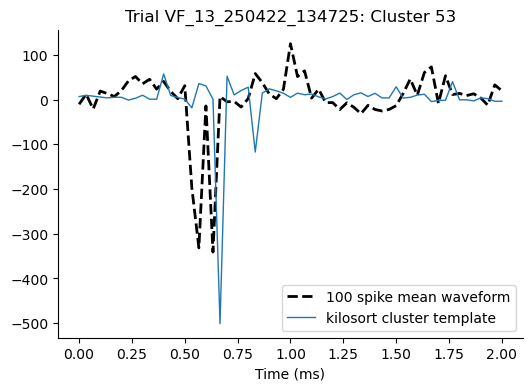

Saved plot for trial VF_13_250422_134725, cluster 56 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_56.png


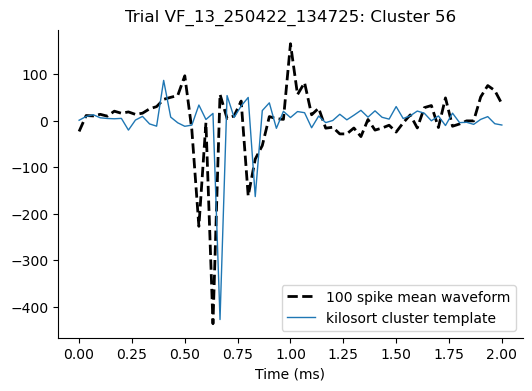

Saved plot for trial VF_13_250422_134725, cluster 57 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_57.png


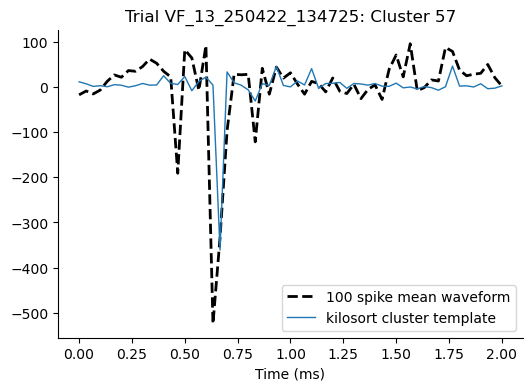

Saved plot for trial VF_13_250422_134725, cluster 58 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_58.png


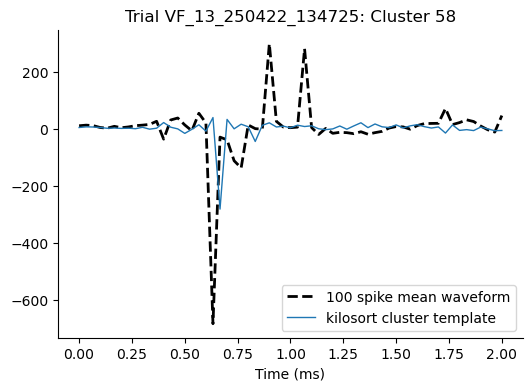

Saved plot for trial VF_13_250422_134725, cluster 61 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_13_250422_134725_cluster_61.png


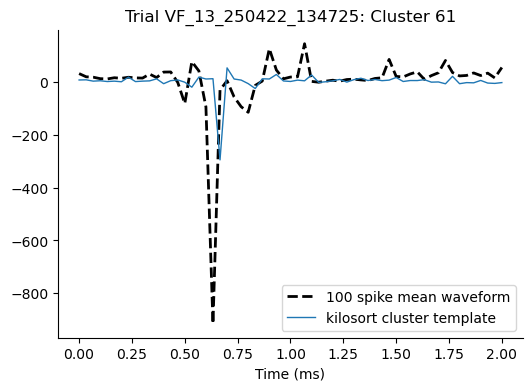

Plotting waveforms for trial VF_14_250422_154410: Good clusters found: [2, 10, 11, 15, 16, 20, 26, 33, 36]
Saved plot for trial VF_14_250422_154410, cluster 2 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_2.png


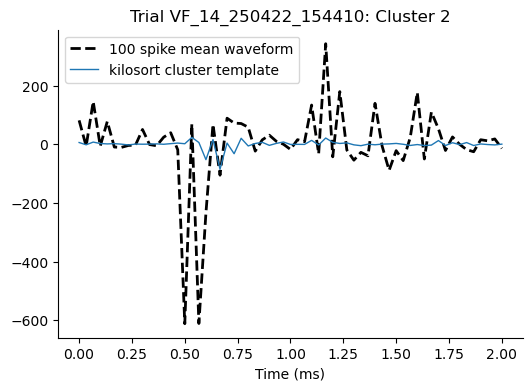

Saved plot for trial VF_14_250422_154410, cluster 10 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_10.png


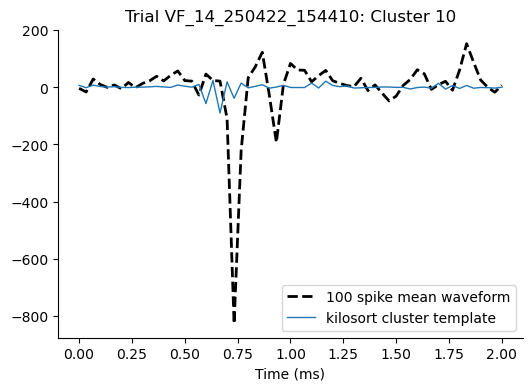

Saved plot for trial VF_14_250422_154410, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_11.png


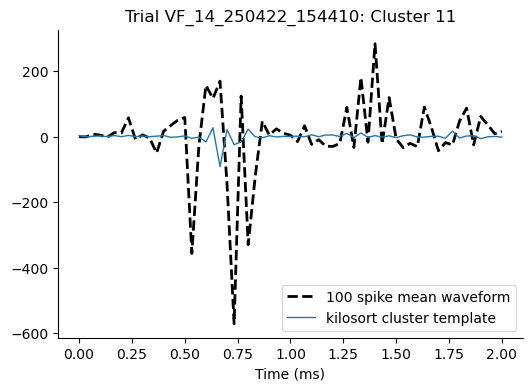

Saved plot for trial VF_14_250422_154410, cluster 15 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_15.png


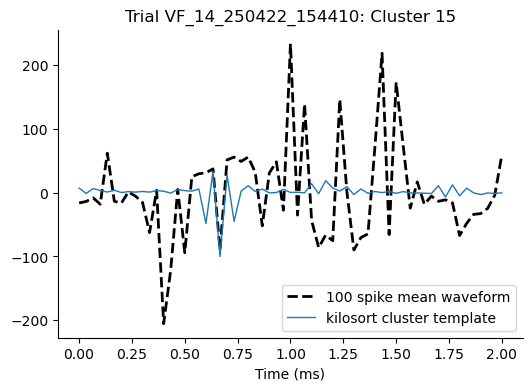

Saved plot for trial VF_14_250422_154410, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_16.png


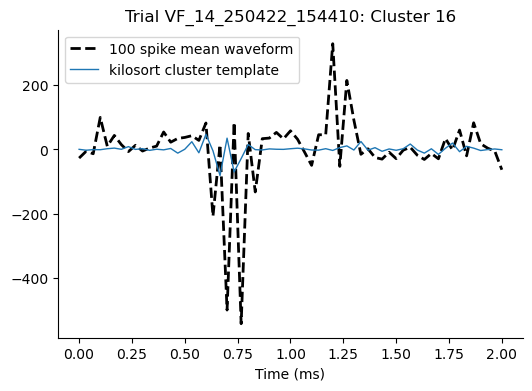

Saved plot for trial VF_14_250422_154410, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_20.png


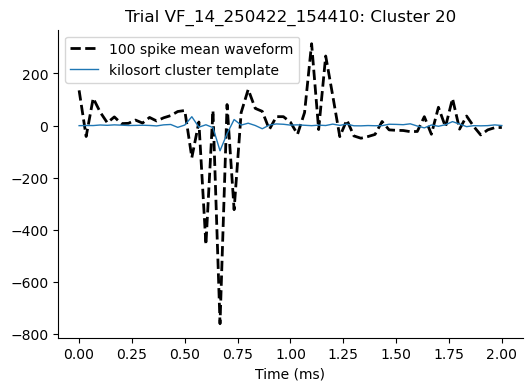

Saved plot for trial VF_14_250422_154410, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_26.png


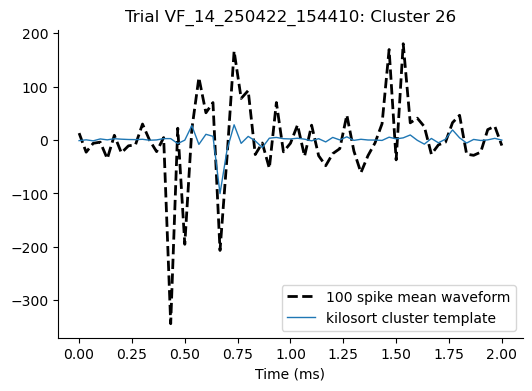

Saved plot for trial VF_14_250422_154410, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_33.png


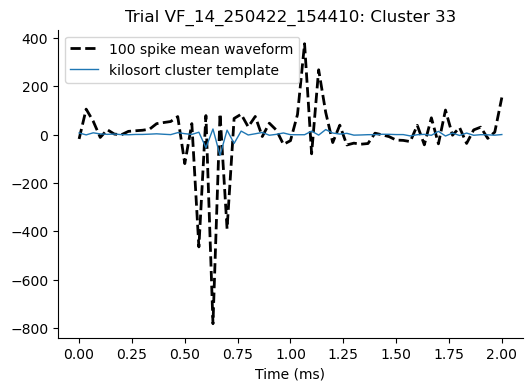

Saved plot for trial VF_14_250422_154410, cluster 36 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_36.png


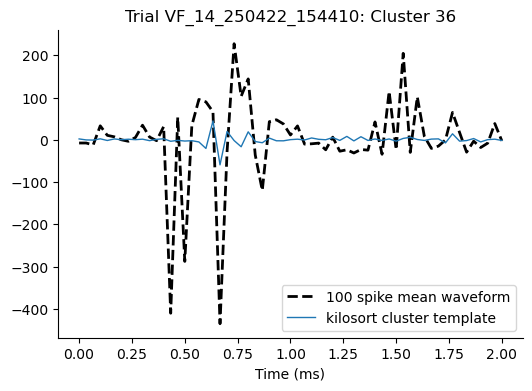

Plotting waveforms for trial VF_14_250422_154410: Good clusters found: [2, 10, 11, 15, 16, 20, 26, 33, 36]
Saved plot for trial VF_14_250422_154410, cluster 2 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_2.png


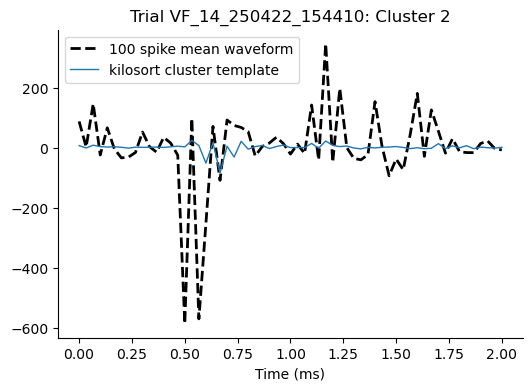

Saved plot for trial VF_14_250422_154410, cluster 10 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_10.png


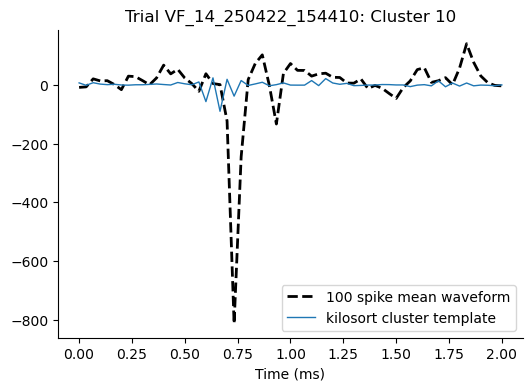

Saved plot for trial VF_14_250422_154410, cluster 11 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_11.png


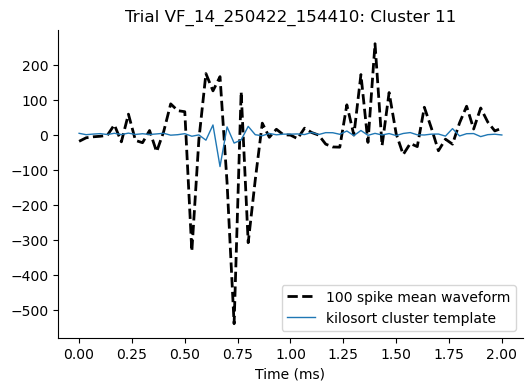

Saved plot for trial VF_14_250422_154410, cluster 15 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_15.png


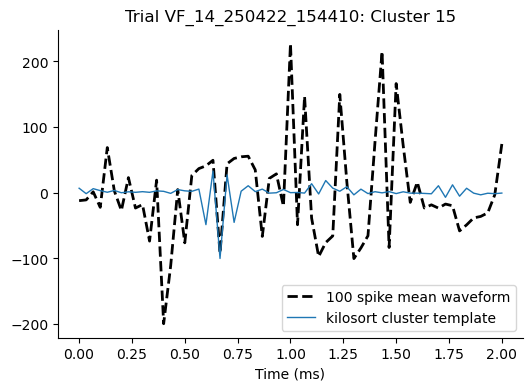

Saved plot for trial VF_14_250422_154410, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_16.png


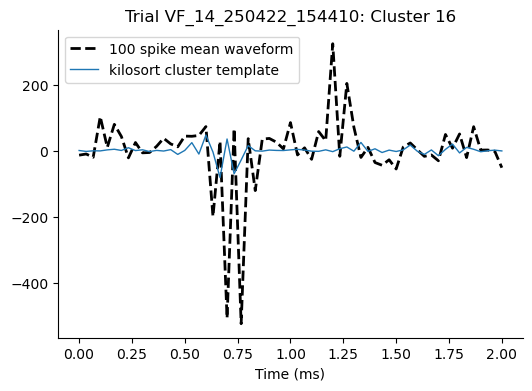

Saved plot for trial VF_14_250422_154410, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_20.png


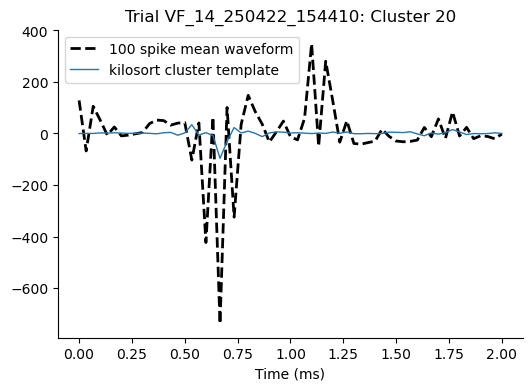

Saved plot for trial VF_14_250422_154410, cluster 26 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_26.png


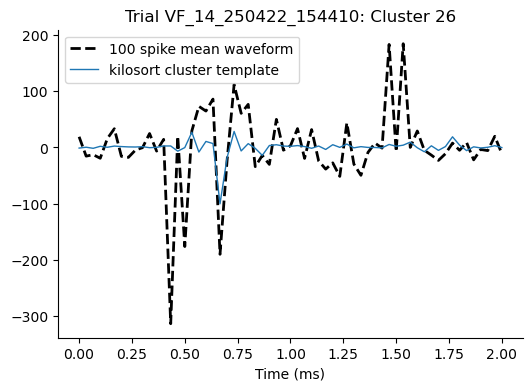

Saved plot for trial VF_14_250422_154410, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_33.png


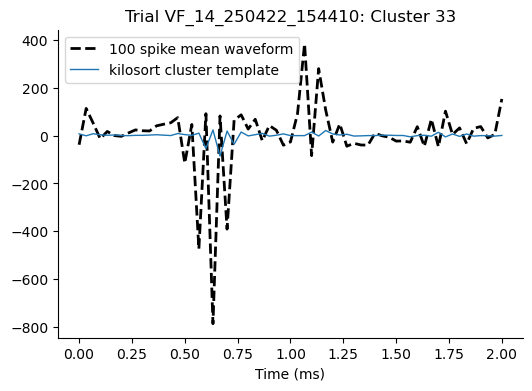

Saved plot for trial VF_14_250422_154410, cluster 36 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_14_250422_154410_cluster_36.png


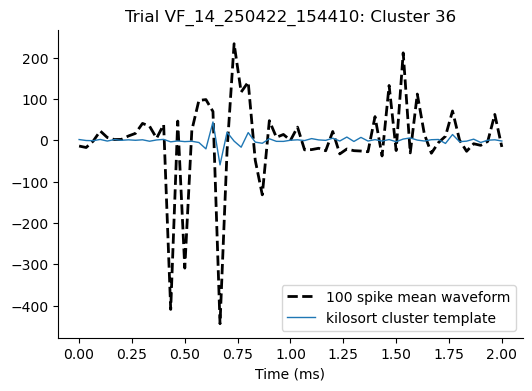

Plotting waveforms for trial VF_15_250422_154935: Good clusters found: [7, 18, 20, 21, 22, 28, 31, 33, 35, 36]
Saved plot for trial VF_15_250422_154935, cluster 7 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_7.png


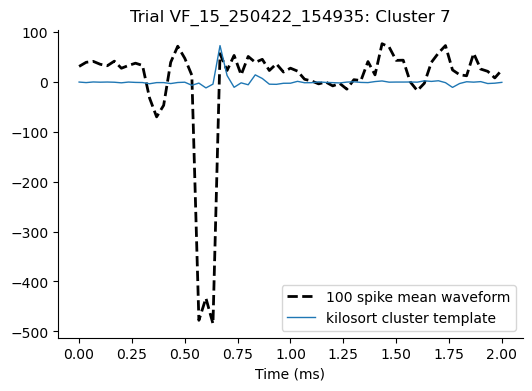

Saved plot for trial VF_15_250422_154935, cluster 18 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_18.png


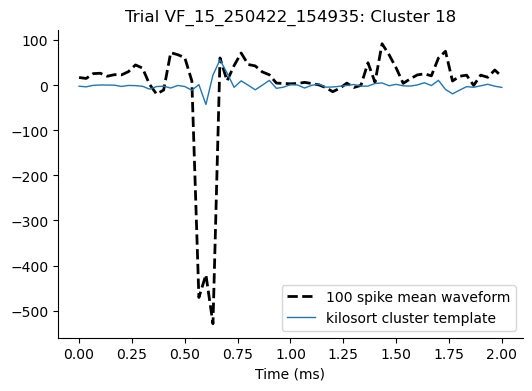

Saved plot for trial VF_15_250422_154935, cluster 20 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_20.png


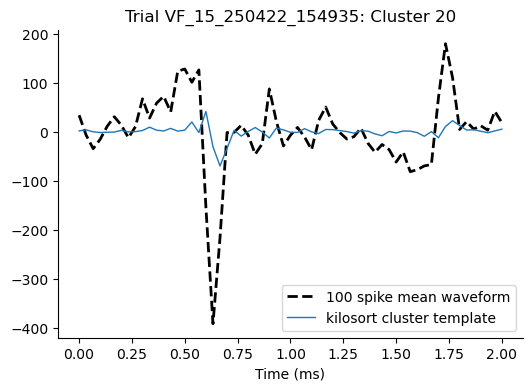

Saved plot for trial VF_15_250422_154935, cluster 21 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_21.png


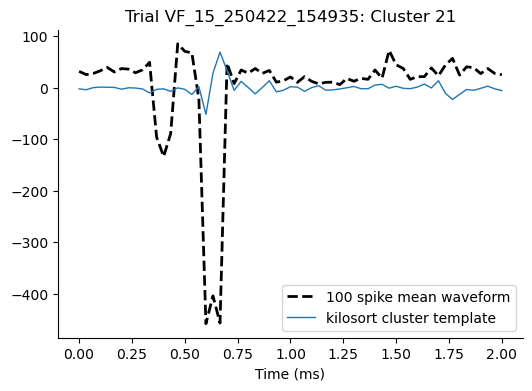

Saved plot for trial VF_15_250422_154935, cluster 22 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_22.png


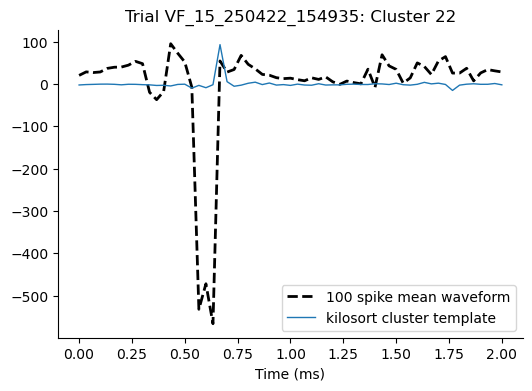

Saved plot for trial VF_15_250422_154935, cluster 28 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_28.png


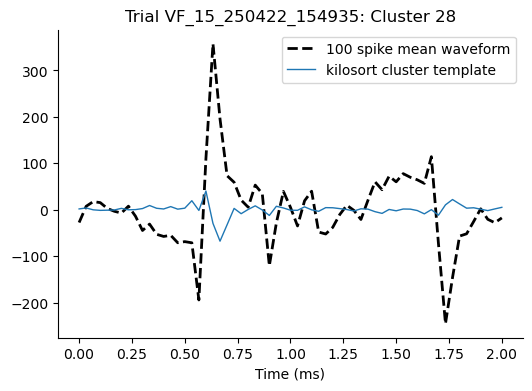

Saved plot for trial VF_15_250422_154935, cluster 31 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_31.png


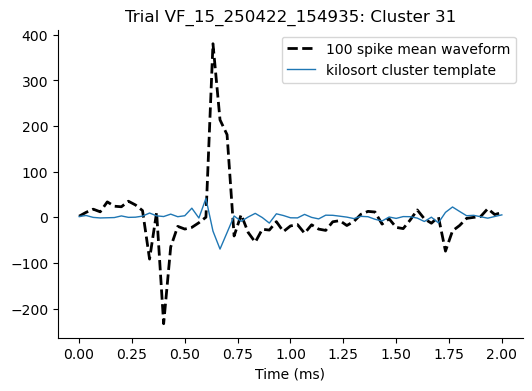

Saved plot for trial VF_15_250422_154935, cluster 33 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_33.png


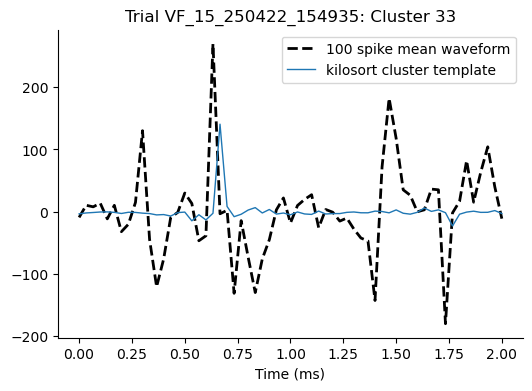

Saved plot for trial VF_15_250422_154935, cluster 35 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_35.png


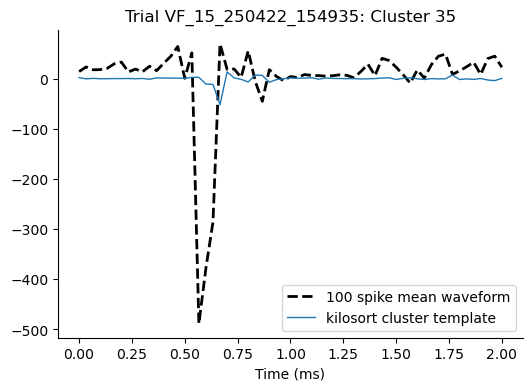

Saved plot for trial VF_15_250422_154935, cluster 36 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_15_250422_154935_cluster_36.png


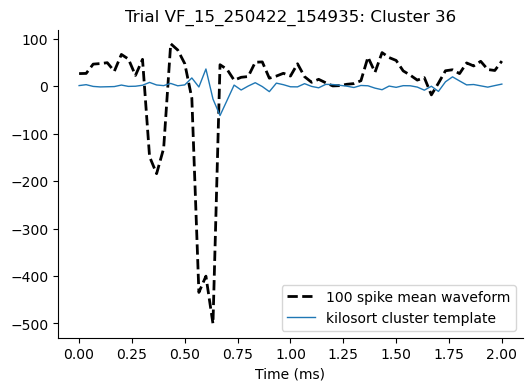

Plotting waveforms for trial VF_16_250422_155509: Good clusters found: [1, 3, 4, 12, 15, 16, 19]
Saved plot for trial VF_16_250422_155509, cluster 1 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_cluster_1.png


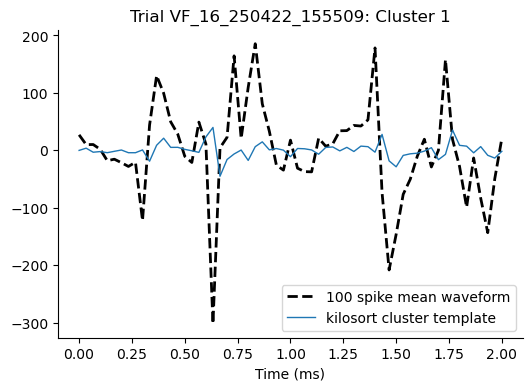

Saved plot for trial VF_16_250422_155509, cluster 3 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_cluster_3.png


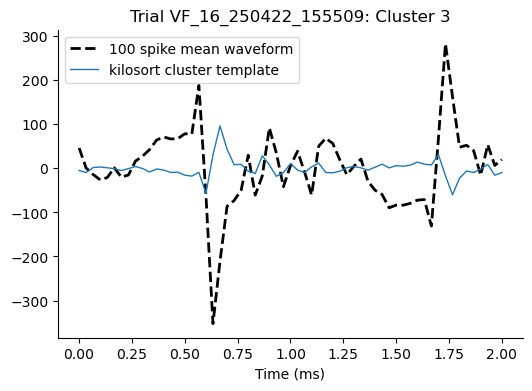

Saved plot for trial VF_16_250422_155509, cluster 4 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_cluster_4.png


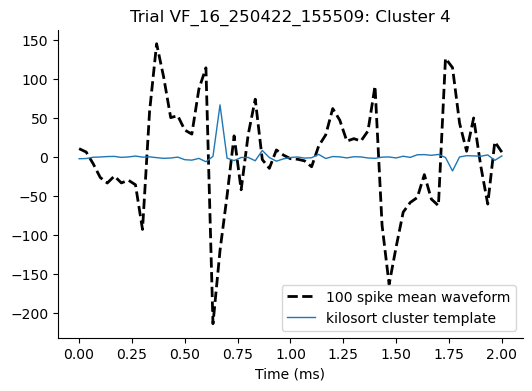

Saved plot for trial VF_16_250422_155509, cluster 12 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_cluster_12.png


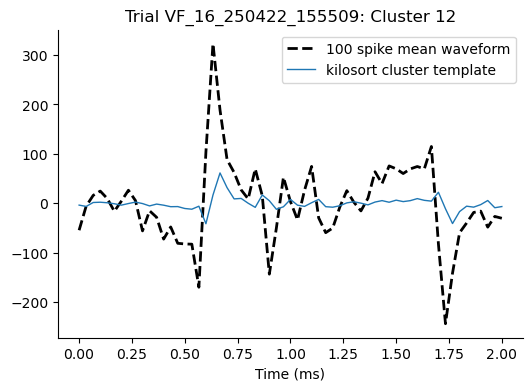

Saved plot for trial VF_16_250422_155509, cluster 15 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_cluster_15.png


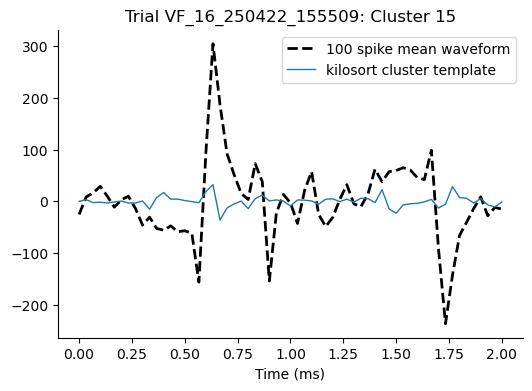

Saved plot for trial VF_16_250422_155509, cluster 16 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_cluster_16.png


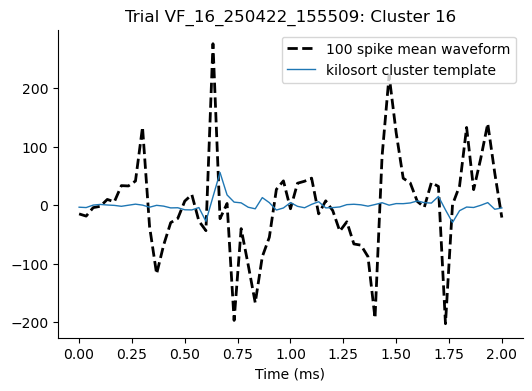

Saved plot for trial VF_16_250422_155509, cluster 19 at D:\SynologyDrive\CMU.80 Data\88 Analyzed Data\88.013 Multi_Rat_Linear_Mixed_Effects_flex_probe\DW361\figures\VF_16_250422_155509_cluster_19.png


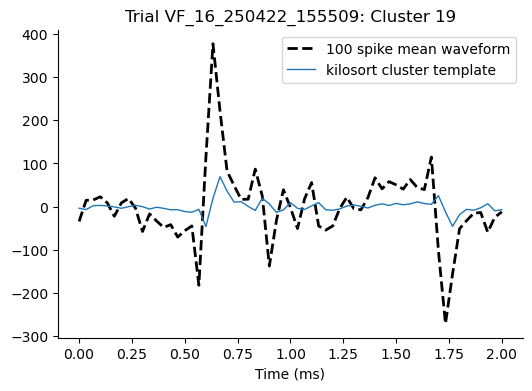

In [17]:
ks_wrappers["DW361"].plot_cluster_waveforms(dw361_trials)

### multi-animal von frey analysis

In [18]:
# Create a multi–rat analysis instance.
multi_analysis = analysis_functions.MultiRatVonFreyAnalysis(group, si_wrappers, ks_wrappers)

# combine all the trials from every animal to plot the results

combined_results = multi_analysis.analyze_all_trials(excel_parent_folder=SAVE_DIRECTORY, subwindow_width=0.5, corr_threshold=0.01)

# use combined_results for further plotting or modeling.

# combined_results now contains results from each rat, loaded from Excel if available.

[WARNING] Some spikes occur beyond the length of the Von Frey data. max spike time = 2165456, length of VF data = 2100000.
[WARNING] Some spikes occur beyond the length of the Von Frey data. max spike time = 2165517, length of VF data = 2100000.
[WARNING] Some spikes occur beyond the length of the Von Frey data. max spike time = 2165583, length of VF data = 2100000.
[WARNING] Some spikes occur beyond the length of the Von Frey data. max spike time = 2165583, length of VF data = 2100000.
[WARNING] Some spikes occur beyond the length of the Von Frey data. max spike time = 2165588, length of VF data = 2100000.
[WARNING] Some spikes occur beyond the length of the Von Frey data. max spike time = 2165528, length of VF data = 2100000.
[WARNING] Some spikes occur beyond the length of the Von Frey data. max spike time = 2165583, length of VF data = 2100000.
[WARNING] Some spikes occur beyond the length of the Von Frey data. max spike time = 2165574, length of VF data = 2100000.
[WARNING] Some s

In [19]:
combined_results["DW322_VF_2_240918_143936"]

KeyError: 'DW322_VF_2_240918_143936'

Combine the Results and Metadata:
You would need to create (or extract) a DataFrame where each row corresponds to a sub-window (or trial) with columns for the dependent variable (for example, average voltage), the fixed effects (e.g. stimulation, pulse width, waiting), and a column indicating the animal (rat ID). You might need to merge your VonFreyAnalysis results with metadata that specifies stimulation parameters.

Fit a Mixed Effects Model:
Use the statsmodels MixedLM or the formula interface (statsmodels.formula.api.mixedlm) to specify a model with fixed effects for voltage, stimulation, pulse width, waiting and a random intercept for animal.


### example of single-rat experiment properties

In [ ]:
group.rats["DW323"].qst_trial_notes

### combining the experiment notes for individual animals, for combined plots and linear mixed effects modeling.

In [ ]:
def make_unique_cols(df):
    new_cols = []
    seen = {}
    for col in df.columns:
        if col in seen:
            seen[col] += 1
            new_cols.append(f"{col}_{seen[col]}")
        else:
            seen[col] = 0
            new_cols.append(col)
    df.columns = new_cols
    return df

dfs = []
for rat_id, rat in group.rats.items():
    df = make_unique_cols(rat.qst_trial_notes.copy())
    df['Rat ID'] = rat_id
    df["Trial Number"] = rat_id + "_" + df["Trial Number"].astype(str)
    dfs.append(df)

combined_qst_notes = pd.concat(dfs, ignore_index=True)

# Sort keys based on the numeric part after the second underscore (i.e., the zero-padded trial number)
sorted_keys = sorted(
    combined_results.keys(),
    key=lambda x: int(x.split('_')[2])
)

combined_qst_notes['Trial_ID'] = sorted_keys

# After concatenating your DataFrames into combined_qst_notes:
combined_qst_notes['Trial_ID'] = list(combined_results.keys())
combined_qst_notes

## plot a composite Von Frey Analysis plot

In [ ]:
# For example:
plots.vf_all_trials_combined_plot(combined_results, combined_qst_notes,corr_threshold=0.2)

## combine metadata and neuron firing changes for linear effects mixed model

In [ ]:
def flatten_and_filter_by_corr(combined_results, combined_qst_notes, corr_threshold=0.1):
    """
    Flattens trial data into a single DataFrame, then filters clusters by correlation threshold.
    Only clusters whose absolute correlation meets or exceeds corr_threshold are kept.
    """
    # Create dictionaries for columns you need from combined_qst_notes
    freq_dict = dict(zip(combined_qst_notes['Trial_ID'], combined_qst_notes['Freq. (Hz)']))
    amp_dict = dict(zip(combined_qst_notes['Trial_ID'], combined_qst_notes['amp']))
    # Add a rat_id_dict to capture the rat ID from combined_qst_notes
    rat_id_dict = dict(zip(combined_qst_notes['Trial_ID'], combined_qst_notes['Rat ID']))
    pulse_width_dict = dict(zip(combined_qst_notes['Trial_ID'], combined_qst_notes['PW (us)']))



    records = []

    for trial_id, res in combined_results.items():
        # Get frequency and amplitude
        freq_hz = freq_dict.get(trial_id)
        amp_val = amp_dict.get(trial_id)
        rat_id = rat_id_dict.get(trial_id)
        pulse_width = pulse_width_dict.get(trial_id)

        if freq_hz is None or amp_val is None or rat_id is None or pulse_width is None:
            continue

        avg_voltage_df = res.get('voltage_df')
        firing_rates_df = res.get('firing_df')
        if avg_voltage_df is None or firing_rates_df is None:
            continue
        
        # Skip if not enough rows to have correlation data
        if len(firing_rates_df) < 2:
            continue

        # Extract the correlation row (second-to-last row)
        correlation_data = firing_rates_df.iloc[-2]
        # Convert correlation entries to a dictionary keyed by integer cluster IDs
        corr_dict = {
            int(k): v
            for k, v in correlation_data.to_dict().items()
            if str(k).isdigit()
        }

        # Exclude the last two rows (correlation row, plus any extra row if present)
        firing_data = firing_rates_df.iloc[:-2]

        # Melt the firing data to long format: (group, cluster, firing_rate)
        firing_melt = firing_data.melt(
            id_vars=['group'], 
            var_name='cluster', 
            value_name='firing_rate'
        )
        firing_melt['cluster'] = pd.to_numeric(firing_melt['cluster'], errors='coerce')

        # Merge firing data with average voltage on group
        if "avg_voltage" not in avg_voltage_df.columns:
            continue
        merged_df = pd.merge(
            firing_melt,
            avg_voltage_df[["group", "avg_voltage"]],
            on="group",
            how="left"
        )

        # Map correlation values per cluster
        merged_df['correlation'] = merged_df['cluster'].map(corr_dict)

        # Add identifying columns
        merged_df['Trial_ID'] = trial_id
        merged_df['Frequency_Hz'] = freq_hz
        merged_df['Amplitude'] = amp_val
        merged_df["Pulse_Width(us)"] = pulse_width
        # normalize the results by dividing by average voltage
        merged_df["firing_rate_vs_stim(uV^-1)"] = merged_df['Frequency_Hz'] / merged_df["avg_voltage"]
        merged_df['Rat_ID'] = rat_id

        # if I need to further flatten the dataset
        merged_df['cluster'] = merged_df['cluster'].astype(str) + "-" + merged_df["Trial_ID"].astype(str)
        
        # Collect all in a list
        records.append(merged_df)

    # Combine all into a single DataFrame
    if not records:
        return pd.DataFrame()

    final_long_df = pd.concat(records, ignore_index=True)

    # Filter by correlation threshold. Keep only those meeting abs corr >= threshold
    final_long_df = final_long_df[final_long_df['correlation'].abs() >= corr_threshold]

    return final_long_df


lmem = flatten_and_filter_by_corr(combined_results, combined_qst_notes, corr_threshold=0.01)
lmem.to_csv(SAVE_DIRECTORY / "flattened_data.csv")
lmem

### getting a better look at the force distribution:

In [ ]:

# histogram

pre_data = lmem[lmem['group'] == 'pre-stim']['avg_voltage']
post_data = lmem[lmem['group'] == 'post-stim']['avg_voltage']

plt.figure(figsize=(10, 6))
plt.hist(pre_data, bins=30, alpha=0.5, label='pre-stim', edgecolor='black')
plt.hist(post_data, bins=30, alpha=0.5, label='post-stim', edgecolor='black')
plt.title('Histogram of Average Voltage: pre vs post stim')
plt.xlabel('Average Voltage')
plt.ylabel('Frequency')
plt.legend()
plt.show()


# boxplot

plt.figure(figsize=(8, 6))
data_to_plot = [
    pre_data,
    post_data
]
plt.boxplot(data_to_plot, labels=['pre-stim', 'post-stim'])
plt.title('Box Plot of Average Voltage: pre vs post stim')
plt.ylabel('Average Voltage')
plt.show()


it honestly doesn't look too different - what could the issue be??

### grouping the dataset by "bins" of stimulus

In [ ]:

# 1. Define bin edges: we go from 0 to slightly above the max value in steps of 50,000.
max_val = lmem['avg_voltage'].max()
bin_edges = np.arange(0, max_val + 10000, 10000)

# 2. Create labels that match the upper bound of each bin.
#    For instance, bin [0, 50000] gets the label "50000", bin (50000, 100000] gets "100000", etc.
labels = [str(int(x)) for x in bin_edges[1:]]

# 3. Use pd.cut to discretize avg_voltage. 
#    include_lowest=True ensures that 0 goes into the first bin. 
#    With right=True (the default), intervals are (a, b], so 50,000 falls in the first bin.
lmem['voltage_bin'] = pd.cut(lmem['avg_voltage'], 
                           bins=bin_edges, 
                           labels=labels, 
                           include_lowest=True,
                           right=True)

# Now each row has a "voltage_bin" indicating its bin.


# see bin counts
bin_counts = lmem['voltage_bin'].value_counts().sort_index()
print("Number of entries in each bin (uV):")
print(bin_counts)


In [ ]:
# Group by 'cluster' and 'voltage_bin' then calc mean firing rate
avg_firing_rate = lmem.groupby(['Rat_ID',"Trial_ID",'cluster', 'voltage_bin', "Frequency_Hz", 'group'])['firing_rate'].mean().reset_index().dropna()
# avg_firing_rate["firing_rate"] = avg_firing_rate["firing_rate"].astype(float) # I think it already does this, no need to specify againa
avg_firing_rate.to_csv(SAVE_DIRECTORY / "grouped_stimulus.csv")
avg_firing_rate

IMPORTANT: this code need to drop zero entries, because you can't calculate % change with zero.

In [ ]:
# Pivot the data so that pre-stim and post-stim firing rates become separate columns.
pre_post_pivot = avg_firing_rate.pivot_table(index=['Rat_ID', 'Trial_ID', 'cluster', 'voltage_bin', 'Frequency_Hz'],
                          columns='group',
                          values='firing_rate').reset_index()


# Remove rows where pre-stim is zero to avoid division by zero
pre_post_pivot = pre_post_pivot[pre_post_pivot['pre-stim'] != 0]


# Drop rows that do not have both pre-stim and post-stim values
pre_post_pivot = pre_post_pivot.dropna(subset=['pre-stim', 'post-stim'])

# Calc percent change, pre to post
pre_post_pivot['percent_change'] = ((pre_post_pivot['post-stim'] - pre_post_pivot['pre-stim']) / pre_post_pivot['pre-stim']) * 100

pre_post_pivot.to_csv(SAVE_DIRECTORY / "percent_change.csv")

pre_post_pivot


### converting the pivoted data to numeric

In [ ]:
## voltage bin
# convert category → string → float (invalid entries become NaN)
pre_post_pivot["voltage_bin"] = pd.to_numeric(
    pre_post_pivot["voltage_bin"].astype(str), errors="coerce"
)

## pre-post stim
# turn everything numeric, coerce errors → NaN
for col in ["pre-stim", "post-stim"]:
    pre_post_pivot[col] = pd.to_numeric(pre_post_pivot[col], errors="coerce")

# drop rows that failed conversion or have zero pre‑stim
pre_post_pivot = pre_post_pivot.dropna(subset=["pre-stim", "post-stim"])
pre_post_pivot = pre_post_pivot[pre_post_pivot["pre-stim"] != 0]

## percent change
# recompute percent_change as float
pre_post_pivot["percent_change"] = (
    (pre_post_pivot["post-stim"] - pre_post_pivot["pre-stim"])
    / pre_post_pivot["pre-stim"]
) * 100

In [ ]:
print(pre_post_pivot.dtypes.loc[["voltage_bin", "pre-stim",
                                 "post-stim", "percent_change"]])

# 📊 % Change in Firing Rates, Grouped by Force (force-matched plots)
---

## Idea:
* The goal here is to create a plot similar to what I already have. But what I will do is plot the percent change in firing rate, for each neuron, along a batch of stimulation rates. so essentially, break up the voltage thresholds into a batch of voltage ranges, then group the firing rates in those batches, then plot the difference.

## Steps
1) Break up the voltages into batches of 100,000uV (there should be 4-8 groups within this range)
2) For each neuron, calculate the percent change in firing rate for each neuron, pre & post stimulation
3) plot the percent change on the y axis. do this for every neuron in the group. 
4) plot the percent change for each neuron to the color representing it's DRG stimulation frequency (5Hz, 20Hz, 100Hz)
5) draw a trendline for the percent change for each neuron (make the colors very similar to what I was using for the previous plot)

the percent change is given by:

$\%\ Change, Firing\ Rate = \frac{((Post-Stimulation\ Firing\ Rate))-(Pre-Stimulation\ Firing\ Rate)}{Pre-Stimulation\ Firing\ Rate}$

---

In [ ]:
pre_post_pivot.sort_values(["percent_change"], ascending=False)

### method

In [ ]:
def plot_percent_change(
    df: pd.DataFrame,
    voltage_bin_col: str = "voltage_bin",
    pre_col: str = "pre-stim",
    post_col: str = "post-stim",
    freq_col: str = "Frequency_Hz",
    percent_col: str = "percent_change",
    cluster_col: str = "cluster",
    add_trendlines: bool = True,
    cmap_name: str = "tab10",
):
    """
    Scatter‑plot percent change in firing rate versus voltage bin midpoint.

    Parameters
    ----------
    df : pandas.DataFrame
        Combined dataframe across all rats and trials.
    voltage_bin_col, pre_col, post_col, freq_col, percent_col, cluster_col : str
        Column names inside `df`.
    add_trendlines : bool
        Draw a linear trendline per frequency group when True.
    cmap_name : str
        Matplotlib colormap for assigning colors to frequency groups.
    """

    # --- Basic column check ---------------------------------------------------
    needed = {voltage_bin_col, pre_col, post_col, freq_col, cluster_col}
    missing = needed - set(df.columns)
    if missing:
        raise ValueError(f"Dataframe missing columns: {missing}")
    

    # --- force voltage_bin to numeric even if categorical or object ---
    df = df.copy()
    df[voltage_bin_col] = pd.to_numeric(df[voltage_bin_col].astype(str), errors="coerce")
    df = df.dropna(subset=[voltage_bin_col])        # remove rows that failed coercion

    # --- Compute percent_change if absent ------------------------------------
    if percent_col not in df.columns:
        # avoid divide‑by‑zero and NaNs
        clean = df.dropna(subset=[pre_col, post_col]).copy()
        clean = clean[clean[pre_col] != 0]
        df[percent_col] = ((clean[post_col] - clean[pre_col]) / clean[pre_col]) * 100

    # --- Remove any rows still lacking valid percent_change ------------------
    plot_df = df.dropna(subset=[percent_col, voltage_bin_col, freq_col])

    if plot_df.empty:
        print("No data available after cleaning.")
        return

    # --- Color mapping -------------------------------------------------------
    freqs = np.sort(plot_df[freq_col].unique())
    cmap = plt.get_cmap(cmap_name)
    color_map = {f: cmap(i % cmap.N) for i, f in enumerate(freqs)}

    # --- Plot ----------------------------------------------------------------
    plt.figure(figsize=(10, 6))
    ax = plt.gca()

    for f in freqs:
        subset = plot_df[plot_df[freq_col] == f]
        x = subset[voltage_bin_col].values
        y = subset[percent_col].values

        ax.scatter(x, y, color=color_map[f], alpha=0.7, label=f"{f} Hz")

        # trendline only if at least two distinct x values
        if add_trendlines and np.unique(x).size > 1:
            slope, intercept = np.polyfit(x, y, 1)
            x_line = np.linspace(x.min(), x.max(), 100)
            y_line = slope * x_line + intercept
            ax.plot(x_line, y_line, color=color_map[f], linewidth=2, alpha=0.8)

    # --- Decorations ---------------------------------------------------------
    ax.axhline(0, color="k", linestyle="--", linewidth=1)
    ax.set_xlabel("Voltage Bin Midpoint (µV)")
    ax.set_ylabel("Percent Change in Firing Rate (%)")
    ax.set_title("Percent Change in Firing Rate by Voltage Bin")
    ax.legend(title="DRG Stimulation Frequency")
    plt.tight_layout()
    plt.show()





### all data, all rats

In [ ]:
plot_percent_change(pre_post_pivot)

### DW323

In [ ]:
pre_post_pivot[pre_post_pivot["Rat_ID"]=="DW323"].sort_values(["percent_change"], ascending=False)

In [ ]:
plot_percent_change(pre_post_pivot[pre_post_pivot["Rat_ID"]=="DW323"])

### DW327

In [ ]:
pre_post_pivot[pre_post_pivot["Rat_ID"]=="DW327"].sort_values(["percent_change"], ascending=False)

In [ ]:
pre_post_pivot[pre_post_pivot["Rat_ID"]=="DW327"].sort_values(["percent_change"], ascending=False)

In [ ]:
plot_percent_change(pre_post_pivot[pre_post_pivot["Rat_ID"]=="DW327"])

### DW322

In [ ]:
pre_post_pivot[pre_post_pivot["Rat_ID"]=="DW322"].sort_values(["percent_change"], ascending=False)

In [ ]:
plot_percent_change(pre_post_pivot[pre_post_pivot["Rat_ID"]=="DW322"])

# 📈 linear mixed effects model - nested cluster, trial, rat id
---

MAKE SURE TO DO THIS STEP


when you filter by correlation threshhold, it is going to drop rows and some of the data may refer to old indices.  This can happen if you drop rows (for example, due to missing percent_change values) without resetting the index, so some groups still reference old index values.



this graph is hard to draw any conclusions from - plot the average trend, with std error bars

    #### structure of dataset

    * Rat
        * trial 
            * cluster ID

    #### Predictor/Fixed Variable:
    * Frequency_Hz (categorical: 5, 20, 100 Hz): frequency of DRG stimulation
    #### Random Effects:
    * Rat_ID: Differences in baseline firing changes between animals.
    * Trial_ID (nested within Rat_ID): Trial‐to‐trial variability (per animal).
    * Trial_Cluster: Variability at the neuron level (per trial).

**Model Formula:**

$$
\text{percent\_change\_firing} \sim \text{Frequency\_Hz} + (1 \mid \text{Rat\_ID}) + \{ \text{Trial}: 0 + C(\text{Trial\_ID}),\ \text{Neuron}: 0 + C(\text{Cluster}) \}
$$

#### methods

In [ ]:

# Convert variables to categorical types
pre_post_pivot['Rat_ID']   = pre_post_pivot['Rat_ID'].astype('category')
pre_post_pivot['Trial_ID'] = pre_post_pivot['Trial_ID'].astype('category')
pre_post_pivot['cluster']  = pre_post_pivot['cluster'].astype('category')
pre_post_pivot["percent_change"] = pre_post_pivot["percent_change"].astype('float')


# Define variance components for trial and neuron (cluster)
vc = {
    'Trial': '0 + C(Trial_ID)',
    'Neuron': '0 + C(cluster)',
}

# Specify the mixed effects model
model = smf.mixedlm("percent_change ~ Frequency_Hz + voltage_bin", pre_post_pivot, groups=pre_post_pivot["Rat_ID"], vc_formula=vc)
result = model.fit()

# Display the model summary
print(result.summary())

things that could be possible:

1. Multicollinearity - are Frequency and Voltage correlated?
2. Trial_ID cluster have only than one level per group.
3. Trial_ID cluster levels are not overly sparse or redundant with the fixed effects.

In [ ]:
pre_post_pivot['Frequency_Hz'].describe()


In [ ]:
pre_post_pivot['voltage_bin'].describe()

In [ ]:
pre_post_pivot[['Frequency_Hz', 'voltage_bin']].corr()

ok, so these values are not highly correlated. this tells me we don't have enough data then?

In [ ]:

# Convert variables to categorical types
pre_post_pivot['Rat_ID']   = pre_post_pivot['Rat_ID'].astype('category')
pre_post_pivot['Trial_ID'] = pre_post_pivot['Trial_ID'].astype('category')
pre_post_pivot['cluster']  = pre_post_pivot['cluster'].astype('category')
pre_post_pivot["percent_change"] = pre_post_pivot["percent_change"].astype('float')


# Define variance components for trial and neuron (cluster)
vc = {
    'Trial': '0 + C(Trial_ID)',
    'Neuron': '0 + C(Trial_ID):C(cluster)'  # neurons nested within trials
}

# Specify the mixed effects model
model = smf.mixedlm("percent_change ~ Frequency_Hz", pre_post_pivot, groups=pre_post_pivot["Rat_ID"], vc_formula=vc)
result = model.fit()

# Display the model summary
print(result.summary())

In [ ]:

# Convert variables to categorical types
pre_post_pivot['Rat_ID']   = pre_post_pivot['Rat_ID'].astype('category')
pre_post_pivot['Trial_ID'] = pre_post_pivot['Trial_ID'].astype('category')
pre_post_pivot['cluster']  = pre_post_pivot['cluster'].astype('category')
pre_post_pivot["percent_change"] = pre_post_pivot["percent_change"].astype('float')


# Define variance components for trial and neuron (cluster)
vc = {
    'Neuron': 'C(cluster)'  # neurons nested within trials
}

# Specify the mixed effects model
model = smf.mixedlm("percent_change ~ Frequency_Hz", pre_post_pivot, groups=pre_post_pivot["Trial_ID"], vc_formula=vc)
result = model.fit()

# Display the model summary
print(result.summary())